Load packages for maps and dendrograms.

- [Notebook Setup](#setup)
- [Simple Individual Maps](#individualmaps)
- [Simple Comparison](#simplecomparison)
- [Annotated Comparison](#annotatedcomparison)
- [All Bonobo-Chimpanzee Divergent Window Annotated Comparisons](#bonobochimpanzeedivergentwindowannotatedcomparisons)

## Notebook Setup <a class = 'anchor' id = 'setup'></a>

In [1]:
from matplotlib import colors
from matplotlib.patches import Rectangle
from matplotlib.transforms import Affine2D
from mpl_toolkits.axisartist.grid_finder import DictFormatter
from scipy.spatial.distance import pdist # <- for dendrograms
import json
import math
import matplotlib.font_manager as font_manager
import matplotlib.lines as mlines
import matplotlib.patches as patches
import matplotlib.pyplot as plt
import mpl_toolkits.axisartist.floating_axes as floating_axes
import numpy as np
import pandas as pd
import scipy.cluster.hierarchy as sch # <- for dendrograms

Set path to Arial font.

In [2]:
arial_path = '/wynton/home/capra/cbrand/miniconda3/envs/jupyter/fonts/Arial.ttf'
arial = font_manager.FontProperties(fname = arial_path)

Write functions use to visualize contact maps. The first two are from the original Akita paper while the third rotates the map to create a diamond. We will mask the lower part of the triangle later. The fourth function loads the Akita predictions for a given individual at a specific window.

In [3]:
def set_diag(arr, x, i=0):
    start = max(i, -arr.shape[1] * i)
    stop = max(0, (arr.shape[1] - i)) * arr.shape[1]
    step = arr.shape[1] + 1
    arr.flat[start:stop:step] = x
    return arr

In [4]:
def from_upper_triu(vector_repr, matrix_len, num_diags):
    z = np.zeros((matrix_len,matrix_len))
    triu_tup = np.triu_indices(matrix_len,num_diags)
    z[triu_tup] = vector_repr
    for i in range(-num_diags+1,num_diags):
        set_diag(z, np.nan, i)
    return z + z.T

In [5]:
def setup_axes1(fig, rect, angle):
    tr = Affine2D().scale(2, 2).rotate_deg(angle)

    #We create dictionarys to keep the xticks and yticks after the rotation
    dictio={i:str(val) for i,val in enumerate(np.arange(-.5, 449, 10).tolist())}
    reversedictio={i:dictio[val] for i,val in enumerate(list(reversed(sorted(dictio.keys()))))}
    grid_helper = floating_axes.GridHelperCurveLinear(
        tr, extremes=(-0.5, 448.5,-0.5, 448.5), tick_formatter1= DictFormatter(dictio),
        tick_formatter2=DictFormatter(reversedictio))

    ax1 = floating_axes.FloatingSubplot(fig, rect, grid_helper=grid_helper)
    
    # remove axes
    ax1.axis("off")    
    ax1.axis["bottom"].set_visible(False)
    ax1.axis["top"].set_visible(False)
    ax1.axis["right"].set_visible(False)
    ax1.axis["left"].set_visible(False)


    fig.add_subplot(ax1) 
    aux_ax = ax1.get_aux_axes(tr)
    grid_helper.grid_finder.grid_locator1._nbins = 448    #Number of rows
    grid_helper.grid_finder.grid_locator2._nbins = 448    #Number of columns
    return aux_ax

In [6]:
def load_individual_map(chr, start, ind):
    with open('/wynton/group/capra/projects/pan_3d_genome/data/predictions/HFF/3d_predictions_%s_%s.txt' % (ind, chr)) as file:
        lines = [ line.strip() for line in file ]
        for line in lines:
            if (f'{chr}\t{start}') in line:
                ind_vector = line.split('\t')
                ind_vector = ind_vector[2:]
    ind_mat = from_upper_triu(ind_vector, 448, 2)
    mask =  np.tri(ind_mat.shape[0], k = -1)
    ind_mat = np.ma.array(ind_mat, mask = mask).T
    return ind_mat

## Simple Individual Maps <a class = 'anchor' id = 'individualmaps'></a>

Generate a single contact map without x axis tick labels or other annotations.

In [26]:
def individual_map(ind1, window):
    chr = window.split('_')[0]
    start = int(window.split('_')[1])
    
    ind1_mat = load_individual_map(chr, start, ind1)

    # rotate matrix and add color
    fig1, axes=plt.subplots(1,figsize=(2.5,2.5))
    fig1.delaxes(axes)
    ax = setup_axes1(fig1, 111, -45)
    
    ax.matshow(ind1_mat, cmap = 'RdBu_r', vmin = -1, vmax = 1)
    #plt.matshow(ind1_mat, cmap = 'RdBu_r')
    
    # add border to map
    ax.plot([-1, 447], [0, 448], color = 'black', linewidth = 3.5) # bottom line
    ax.plot([-1, 447], [448, 448], color = 'black', linewidth = 3.5) # right line
    ax.plot([-1, -1], [448, 0], color = 'black', linewidth = 3.5) # left line
    
    # add 'x-axis' ticks
    first = start + 65536
    rounded = math.ceil(first / 100000) * 100000
    diff = rounded - first
    cell = diff/2048
    
    x_list = np.arange(cell, 440, (100000/2048))
    for x in x_list:
        ax.plot(x, x, color = 'black', marker = '|', markersize = 20)
    
    plt.savefig('/wynton/group/capra/projects/pan_3d_genome/figures/individual_maps/individual_map_%s_%s.pdf' % (window, ind1), bbox_inches = 'tight', transparent = True);
    plt.show()

Generate some maps for Figure 1B.

In [27]:
individual_map('Clint', 'chr1_100663296')

NameError: name 'load_individual_map' is not defined

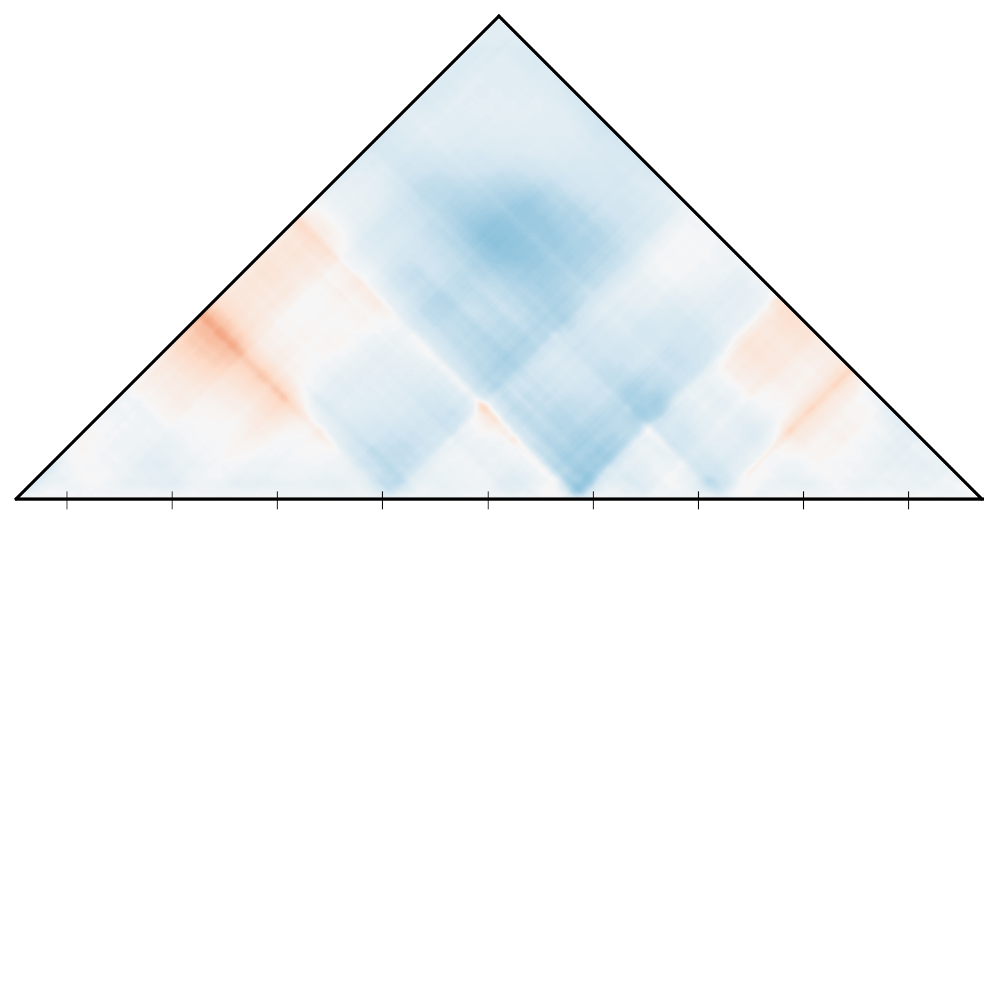

In [9]:
individual_map('Clint', 'chr1_101187584')

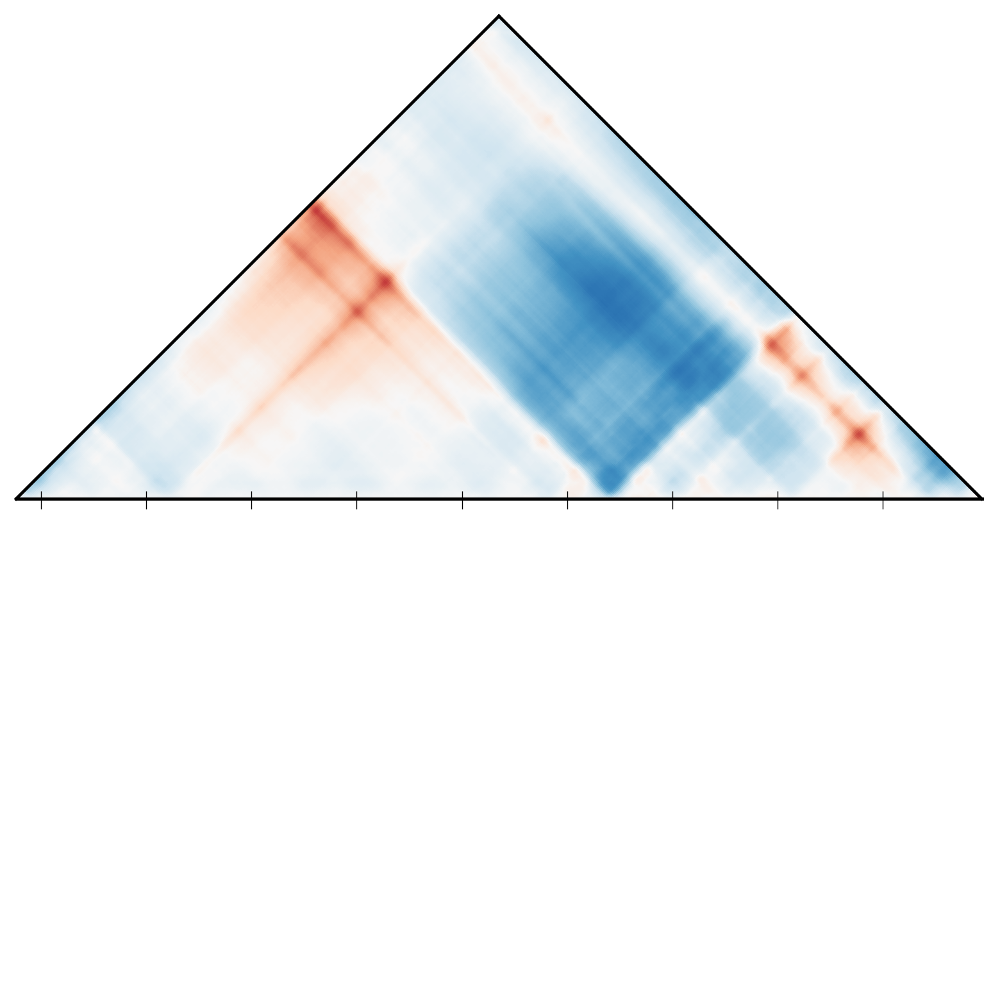

In [10]:
individual_map('Clint', 'chr1_101711872')

## Simple Comparison <a class = 'anchor' id = 'simplecomparison'></a>

In [44]:
def simple_map_comparison(ind1, ind2, window):
    chr = window.split('_')[0]
    start = int(window.split('_')[1])
    
    ind1_mat = load_individual_map(chr, start, ind1)
    ind2_mat = load_individual_map(chr, start, ind2)

    fig1, axes = plt.subplots(3, 1, figsize=(2.5,6))

    fig1.delaxes(axes[0])
    fig1.delaxes(axes[1])
    fig1.delaxes(axes[2])
    
    ax0 = setup_axes1(fig1, 311, -45)
    ax1 = setup_axes1(fig1, 312, -45)
    ax2 = setup_axes1(fig1, 313, -45)

    ax0.set_position([0, 0.62, 1, 1])
    ax1.set_position([0, 0.31, 1, 1])
    ax2.set_position([0, 0, 1, 1])
    
    ax0.matshow(ind1_mat, cmap = 'RdBu_r', vmin = -1, vmax = 1)
    ax1.matshow(ind2_mat, cmap = 'RdBu_r', vmin = -1, vmax = 1)
    ax2.matshow(ind2_mat - ind1_mat, cmap = 'PRGn_r', vmin = -0.5, vmax = 0.5)
    
    subplots = [ax0,ax1,ax2]
    
    # add border to map
    for n in subplots:
        n.plot([-1, 447], [0, 448], color = 'black', linewidth = 0.70821529745) # bottom line
        n.plot([-1, 447], [448, 448], color = 'black', linewidth = 0.70821529745) # right line
        n.plot([-1, -1], [448, 0], color = 'black', linewidth = 0.70821529745) # left line
    
    # add 'x-axis' ticks
    first = start + 65536
    rounded = math.ceil(first / 100000) * 100000
    diff = rounded - first
    cell = diff/2048
    
    x_list = np.arange(cell, 440, (100000/2048))
        
    for n in subplots:
        for x in x_list:
            n.plot(x, x, color = 'black', marker = '|', markersize = 5)
    
    # add 'x-axis' labels
    y_list = np.arange((rounded/1000000), ((rounded/1000000)+0.9), 0.1)
    for n in subplots:
        for x, y in zip(x_list[::2], (y_list[::2])):
            n.text(x+15, x-15, '%.1f' % y, horizontalalignment = 'center', verticalalignment = 'top', fontproperties = arial, fontsize = 9)
    
    # subpanel labels
    ax0.text(290, 158, ind1, horizontalalignment = 'center', verticalalignment = 'center', fontproperties = arial, fontsize = 10)
    ax1.text(290, 158, ind2, horizontalalignment = 'center', verticalalignment = 'center', fontproperties = arial, fontsize = 10)
    ax2.text(290, 158, r'$\Delta$', horizontalalignment = 'center', verticalalignment = 'center', fontproperties = arial, fontsize = 10)
    
    plt.savefig('/wynton/group/capra/projects/pan_3d_genome/figures/map_comparisons/simple_comparison_%s_%s_%s.pdf' % (window, ind1, ind2), bbox_inches = 'tight', transparent = True, dpi = 400);
    plt.show()

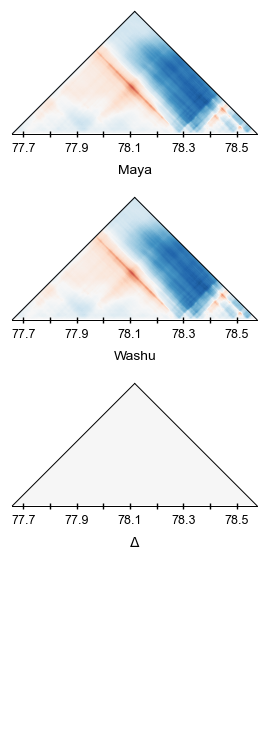

In [45]:
simple_map_comparison('Maya', 'Washu', 'chr4_77594624')

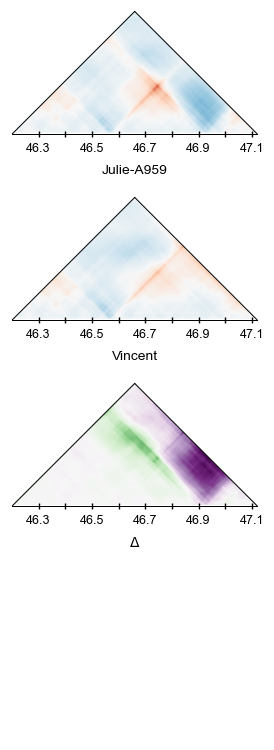

In [46]:
simple_map_comparison('Julie-A959', 'Vincent', 'chr18_46137344')

## Annotated Comparison <a class = 'anchor' id = 'annotatedcomparison'></a>

Write a function to add annotations to a plot. Annotations include the genes, phastCons conserved elements, and CTCF binding sites from Schwalie et al. 2013.

In [14]:
def annotations(chr, start):
    # assign a few variables for the "tracks" below
    map_x_min = (start+65536)
    map_x_max = (start+((2**20)-65536))
            
    # exons
    exons = pd.read_csv('/wynton/group/capra/projects/pan_3d_genome/data/annotations/panTro6_exons.bed', sep = '\t', header = None, names = ['chr','start','end','gene'])
    exons = exons[(exons['chr'] == chr) & (exons['start'] >= start) & (exons['start'] < map_x_max)]
    exons['end'].values[exons['end'] > map_x_max] = map_x_max
    
    exons['start'] = (exons['start'] - (start + 65536)) / 2048
    exons['end'] = (exons['end'] - (start + 65536)) / 2048
    exons['length'] = exons['end'] - exons['start']
    exons = exons[exons['end'] >= 0] # remove values less than zero
    
    exon_genes = pd.unique(exons['gene']).tolist()
    exon_starts = exons['start'].values.tolist()
    exon_lengths = exons['length'].values.tolist()

    # genes
    genes = pd.read_csv('/wynton/group/capra/projects/pan_3d_genome/data/annotations/panTro6_genes.bed', sep = '\t', header = None, names = ['chr','start','end','transcript','gene'])
    genes = genes[genes['gene'].isin(exon_genes)]
    
    genes['start'].values[genes['start'] < map_x_min] = map_x_min
    genes['end'].values[genes['end'] > map_x_max] = map_x_max
    genes['start'] = (genes['start'] - map_x_min) / 2048
    genes['end'] = (genes['end'] - map_x_min) / 2048
  
    genes['length'] = genes['end'] - genes['start']
    gene_starts = genes['start'].values.tolist()
    gene_lengths = genes['length'].values.tolist()
    
    # gene names
    gene_midpoints = (genes['length']/2) + genes['start'].values.tolist()

    # phastCons
    phastCons = pd.read_csv('/wynton/group/capra/projects/pan_3d_genome/data/phastCons/phastConsElements30way_conserved_elements_panTro6.bed', sep = '\t', header = None, names = ['chr','start','end','score'])
    phastCons = phastCons[(phastCons['chr'] == chr) & (phastCons['start'] >= start) & (phastCons['start'] < start+((2**20)-65536))]
    phastCons['end'].values[phastCons['end'] > map_x_max] = map_x_max
    phastCons['start'] = (phastCons['start'] - (start + 65536)) / 2048
    phastCons['end'] = (phastCons['end'] - (start + 65536)) / 2048
    phastCons['length'] = phastCons['end'] - phastCons['start']
    phastCons_starts = phastCons['start'].values.tolist()
    phastCons_lengths = phastCons['length'].values.tolist()
    
    # CTCF
    CTCF = pd.read_csv('/wynton/group/capra/projects/pan_3d_genome/data/annotations/panTro6_CTCF.bed', sep = '\t', header = None, names = ['chr','start','end','score','18359_overlap','36222_overlap','EB176_overlap'])
    CTCF = CTCF[(CTCF['chr'] == chr) & (CTCF['start'] >= start) & (CTCF['start'] < start+((2**20)-65536))]
    CTCF['end'].values[CTCF['end'] > map_x_max] = map_x_max
    CTCF['start'] = (CTCF['start'] - (start + 65536)) / 2048
    CTCF['end'] = (CTCF['end'] - (start + 65536)) / 2048
    CTCF['length'] = CTCF['end'] - CTCF['start']
    CTCF_starts = CTCF['start'].values.tolist()
    CTCF_lengths = CTCF['length'].values.tolist()

    return exon_starts, exon_lengths, gene_starts, gene_lengths, gene_midpoints, exon_genes, phastCons_starts, phastCons_lengths, CTCF_starts, CTCF_lengths

In [15]:
def map_comparison_no_delta_with_annotations(ind1, ind2, window, save):
    chr = window.split('_')[0]
    start = int(window.split('_')[1])

    ind1_mat = load_individual_map(chr, start, ind1)
    ind2_mat = load_individual_map(chr, start, ind2)
    
    #fig1, axes = plt.subplots(2, figsize=(20,20))
    fig1, axes = plt.subplots(2, 1, figsize=(4.8,6.8))
    
    fig1.delaxes(axes[0])
    fig1.delaxes(axes[1])
    
    #ax0 = setup_axes1(fig1, 131, -45)
    #ax1 = setup_axes1(fig1, 132, -45)
    ax0 = setup_axes1(fig1, 211, -45)
    ax1 = setup_axes1(fig1, 212, -45)


    ax0.set_position([0, 0.43, 1, 1])
    ax1.set_position([0, 0, 1, 1])
    
    ax0.matshow(ind1_mat, cmap = 'RdBu_r', vmin = -2, vmax = 2)
    ax1.matshow(ind2_mat, cmap = 'RdBu_r', vmin = -2, vmax = 2)
    
    subplots = [ax0,ax1]
    
    # add border to map
    for n in subplots:
        n.plot([-1, 447], [0, 448], color = 'black', linewidth = 1) # bottom line
        n.plot([-1, 447], [448, 448], color = 'black', linewidth = 1) # right line
        n.plot([-1, -1], [448, 0], color = 'black', linewidth = 1) # left line
    
    # add 'x-axis' ticks
    first = start + 65536
    rounded = math.ceil(first / 100000) * 100000
    diff = rounded - first
    cell = diff/2048
    
    x_list = np.arange(cell, 440, (100000/2048))
        
    for n in subplots:
        for x in x_list:
            n.plot(x, x, color = 'black', marker = '|', markersize = 15*0.75)
    
    # add 'x-axis' labels
    y_list = np.arange((rounded/1000000), ((rounded/1000000)+0.9), 0.1)
    for n in subplots:
        for x, y in zip(x_list[::2], (y_list[::2])):
            n.text(x+18, x-18, '%.1f' % y, horizontalalignment = 'center', verticalalignment = 'top', fontproperties = arial, fontsize = 9)
    
    # get annotations
    exon_starts, exon_lengths, gene_starts, gene_lengths, gene_midpoints, exon_genes, phastCons_starts, phastCons_lengths, CTCF_starts, CTCF_lengths = annotations(chr, start)
    
    # plot tracks
    for x, y in zip(exon_starts, exon_lengths):
        ax1.add_patch(Rectangle((x+70, x-70), width = y, height = 25*0.75, angle = 45, color = 'black', lw = 1))
    for x, y in zip(gene_starts, gene_lengths):
        ax1.plot([(x+63.5), ((x+y)+63.5)],[(x-63.5), ((x+y)-63.5)], color = 'black') # line will default to bottom of exon rectangle so adjust coordinates if exon height changes
    for x, y in zip(gene_midpoints, exon_genes):
        ax1.text(x+75, x-75, y, horizontalalignment = 'center', verticalalignment = 'top', style = 'italic', fontsize = 8)
    for x, y in zip(CTCF_starts, CTCF_lengths):
        ax1.add_patch(Rectangle((x+115, x-115), width = y, height = 25*0.75, angle = 45, color = 'grey', lw = 1))
    for x, y in zip(phastCons_starts, phastCons_lengths):
        ax1.add_patch(Rectangle((x+145, x-145), width = y, height = 25*0.75, angle = 45, color = 'goldenrod', lw = 1))

    # track labels
    for n in subplots:
        n.text(0, -36, chr, horizontalalignment = 'right', verticalalignment = 'top', fontproperties = arial, fontsize = 10)
    # track labels
    ax1.text(37.5, -82.5, 'Genes', horizontalalignment = 'right', verticalalignment = 'center', fontproperties = arial, fontsize = 10)
    ax1.text(87.5, -127.5, 'CTCF', horizontalalignment = 'right', verticalalignment = 'center', fontproperties = arial, fontsize = 10)
    ax1.text(117.5, -157.5, 'Cons', horizontalalignment = 'right', verticalalignment = 'center', fontproperties = arial, fontsize = 10)

    plt.subplots_adjust(hspace=0.5)
    
    # save and show plot
    if save == 'yes':
        plt.savefig('/wynton/group/capra/projects/pan_3d_genome/figures/map_comparisons/annotated_comparison_%s_%s_%s.pdf' % (window, ind1, ind2), bbox_inches = 'tight', transparent = True)
        print('Comparisons saved.')
    plt.show()

Comparisons saved.


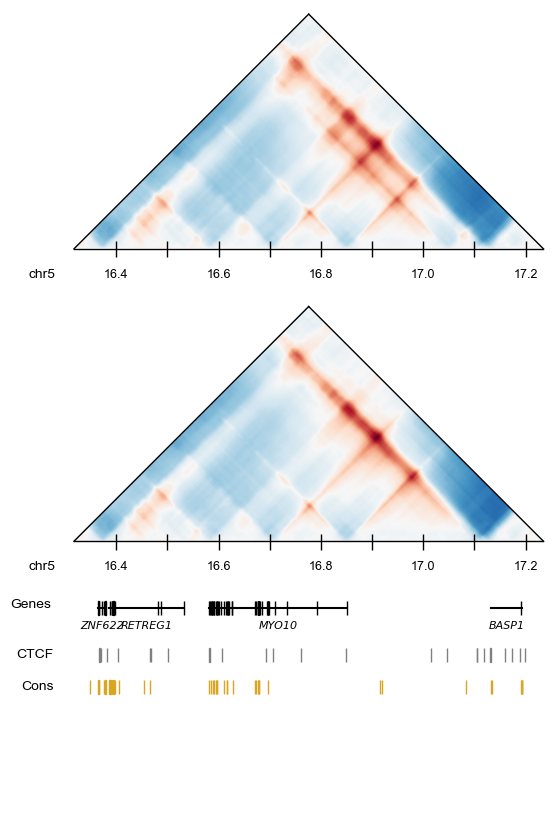

In [126]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr5_16252928', 'yes')

## All Bonobo-Chimpanzee Divergent Window Annotated Comparisons <a class = 'anchor' id = 'bonobochimpanzeedivergentwindowannotatedcomparisons'></a>

In [16]:
ppn_ptr_divergent_windows = pd.read_csv('/wynton/group/capra/projects/pan_3d_genome/data/ppn_ptr_windows/ppn_ptr_divergent_windows.bed', sep = '\t', names = ['chr','start','end'])

In [17]:
for _, row in ppn_ptr_divergent_windows.iterrows():
    ind1 = 'Clint'
    ind2 = 'Hortense'
    window = row['chr'] + '_' + str(row['start'])
    print(f'map_comparison_no_delta_with_annotations(\'{ind1}\', \'{ind2}\', \'{window}\', \'no\')')

map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_126353408', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_153092096', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_153616384', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_173015040', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr10_78643200', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr10_87556096', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr11_22544384', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr11_77070336', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr11_77594624', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr12_37748736', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr12_44040192', 'no')
map_comparison_no_delta_with_annotations('Clint', 'Hor

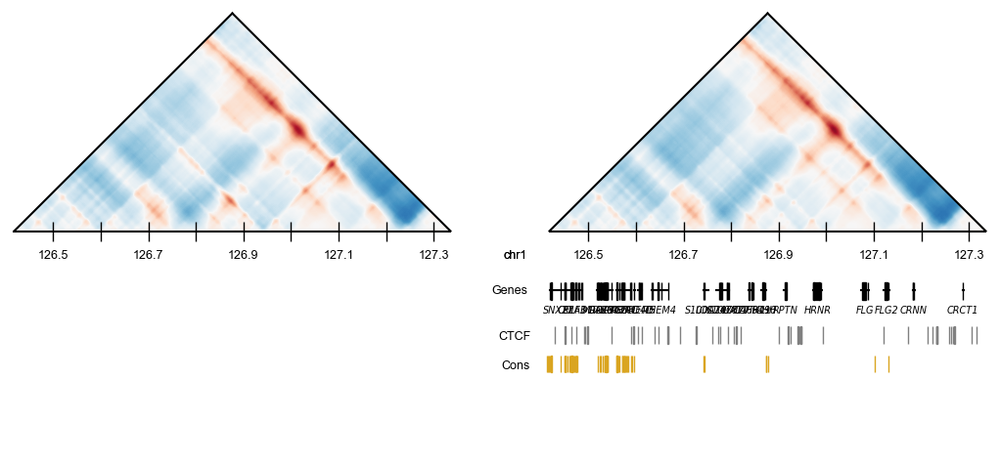

In [24]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_126353408', 'no')

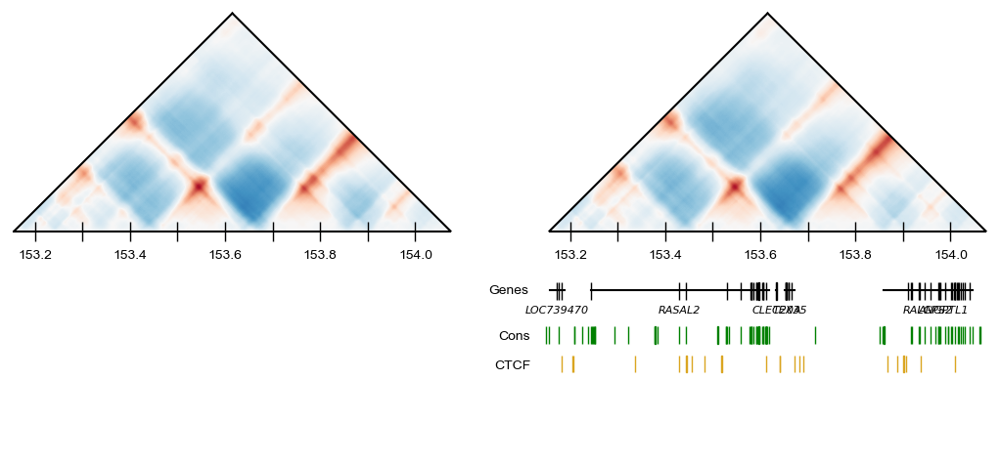

In [25]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_153092096', 'no')

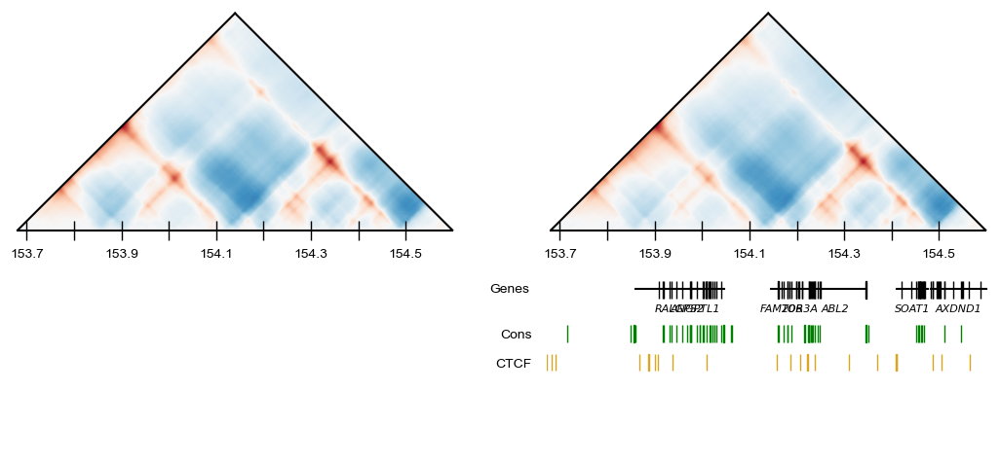

In [26]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_153616384', 'no')

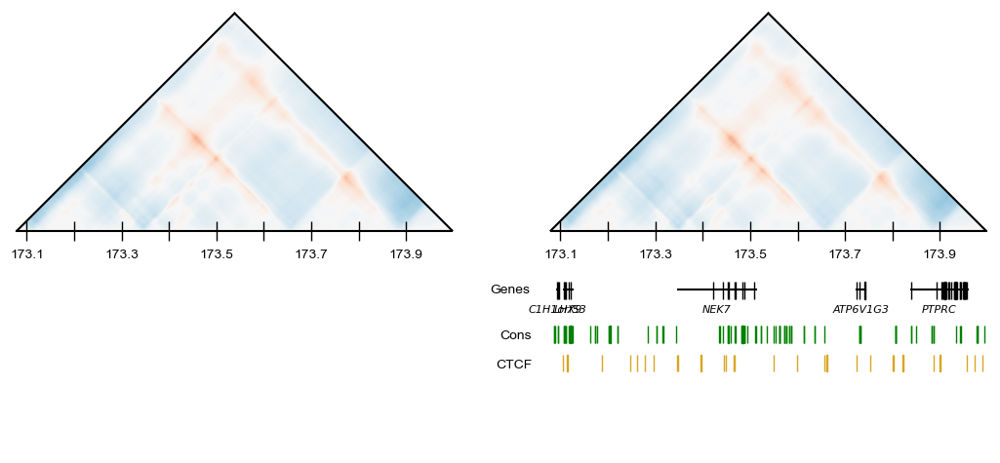

In [27]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr1_173015040', 'no')

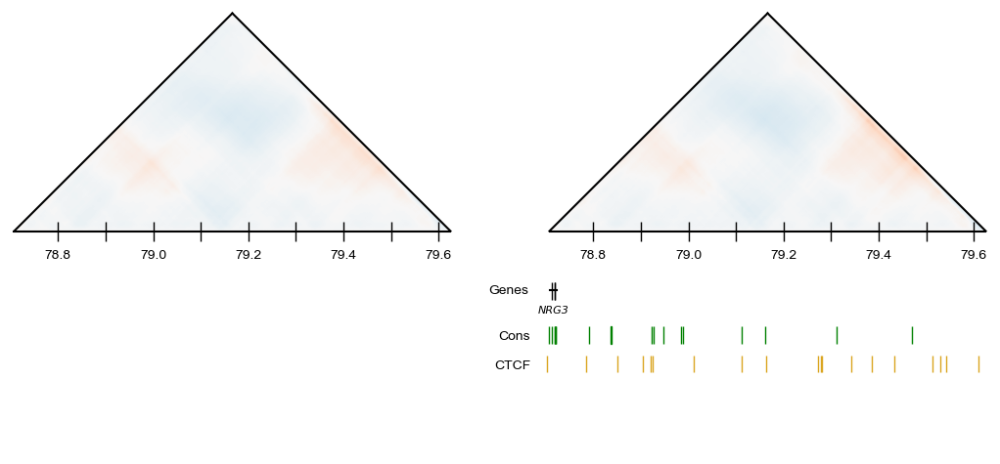

In [28]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr10_78643200', 'no')

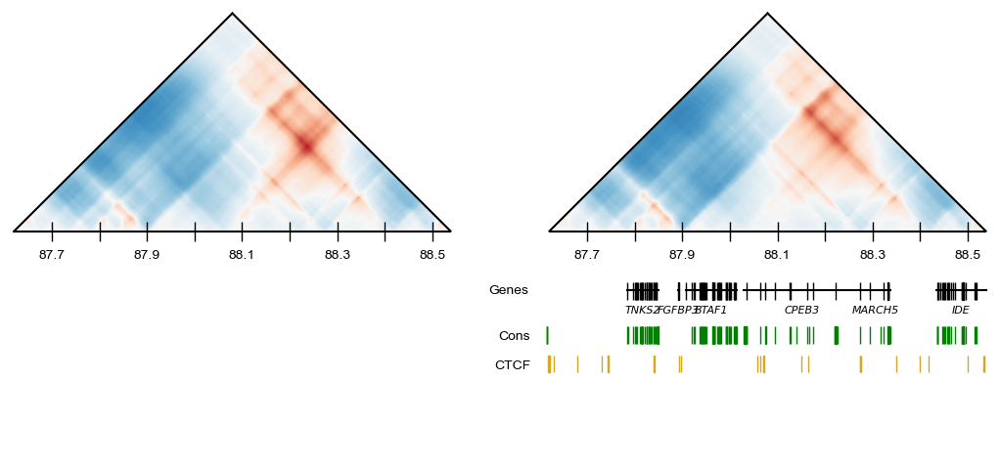

In [29]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr10_87556096', 'no')

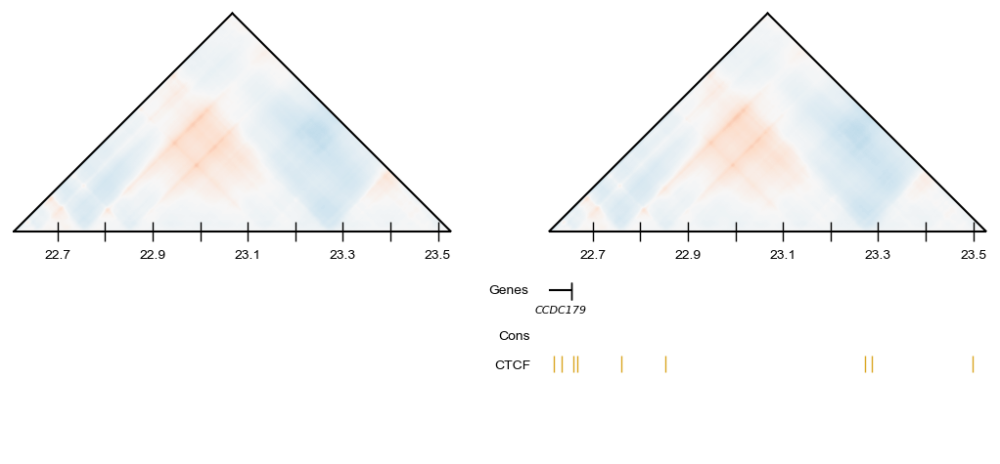

In [30]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr11_22544384', 'no')

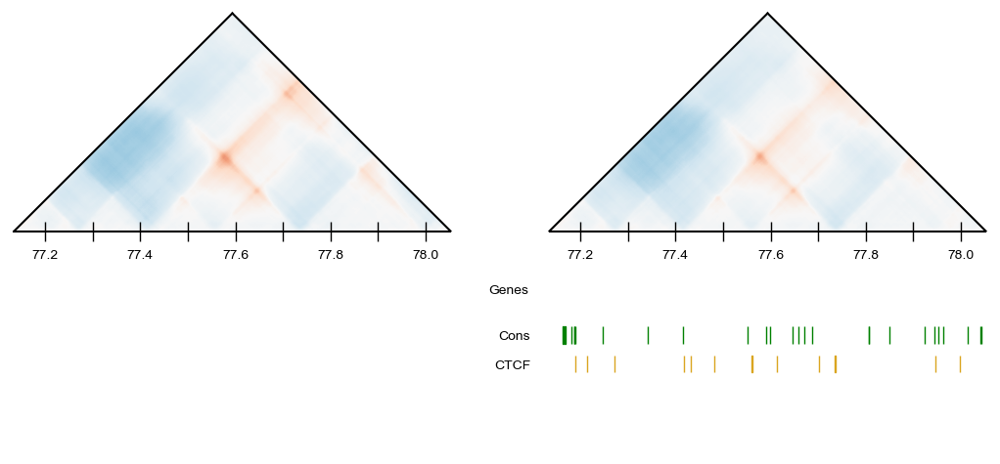

In [31]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr11_77070336', 'no')

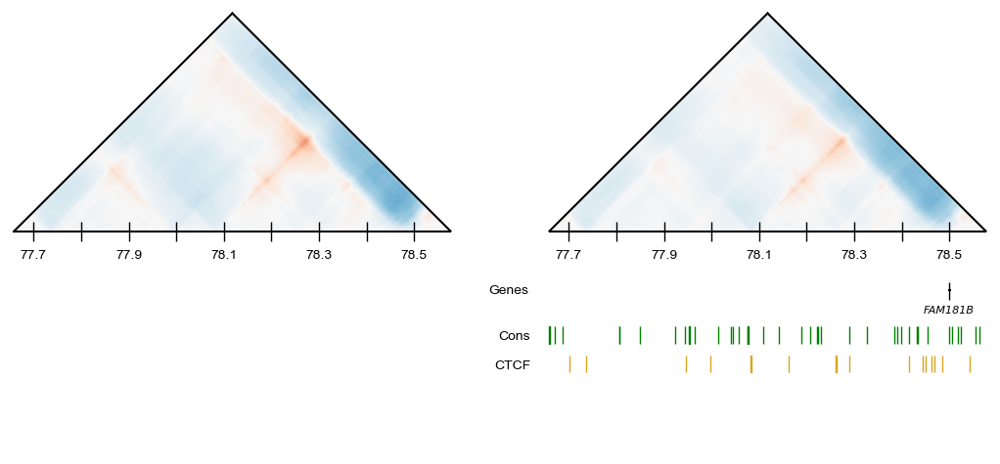

In [32]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr11_77594624', 'no')

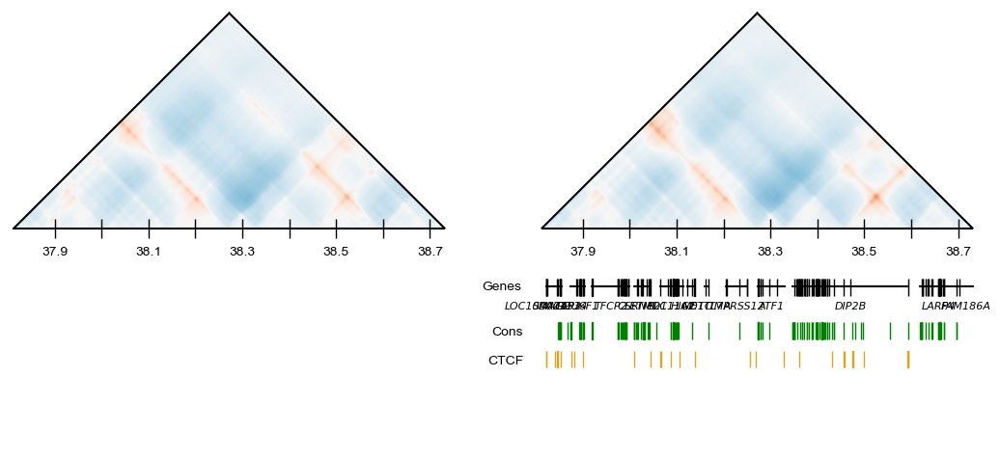

In [33]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr12_37748736', 'no')

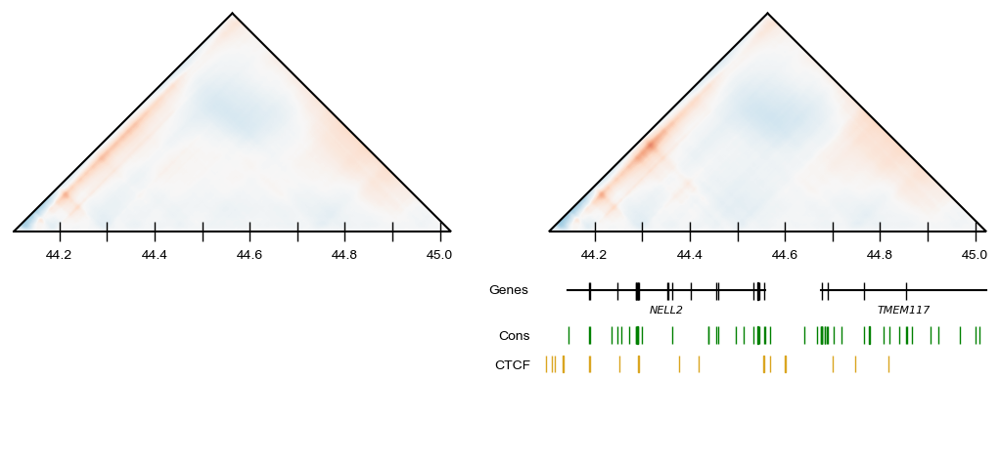

In [34]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr12_44040192', 'no')

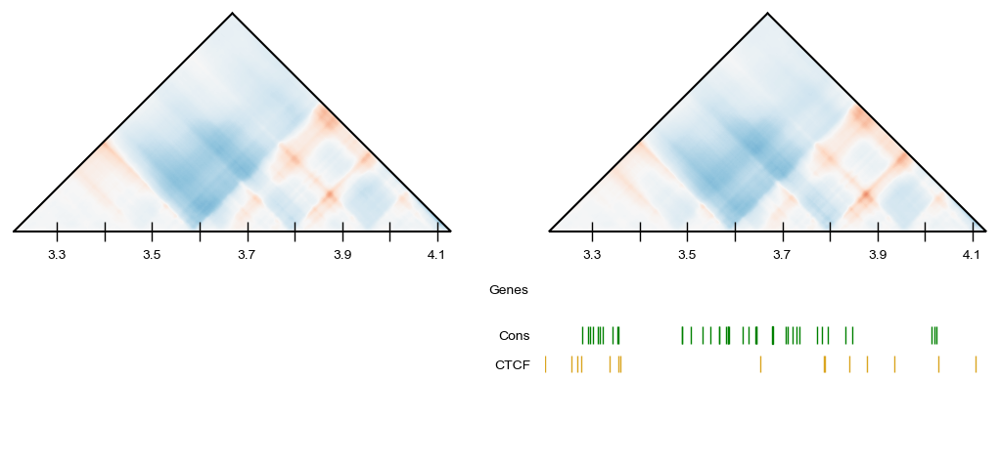

In [35]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr13_3145728', 'no')

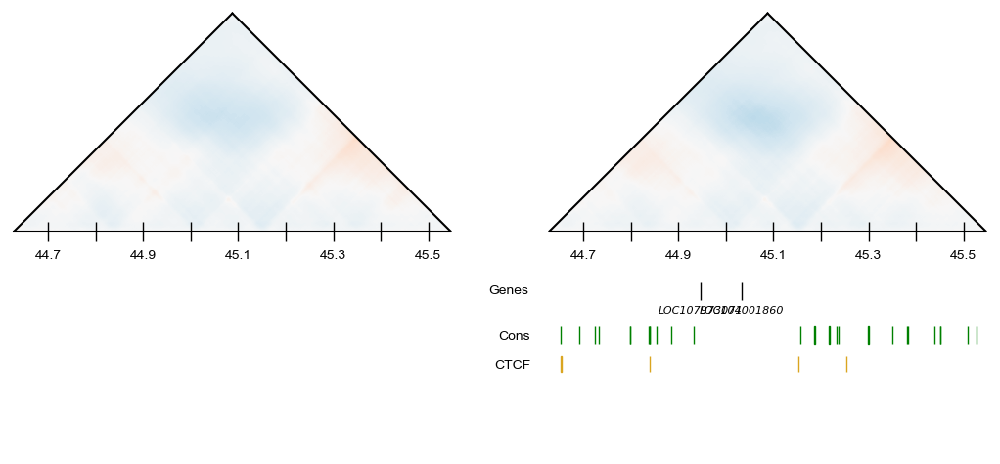

In [36]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr13_44564480', 'no')

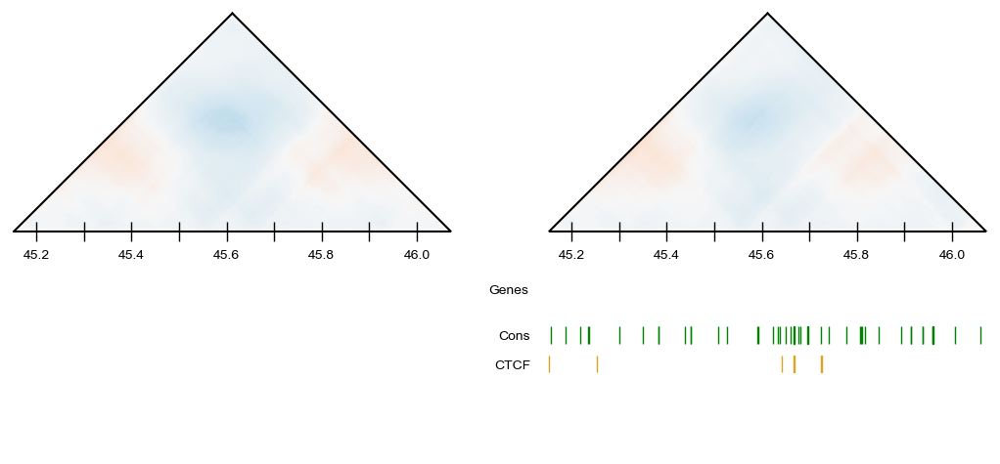

In [37]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr13_45088768', 'no')

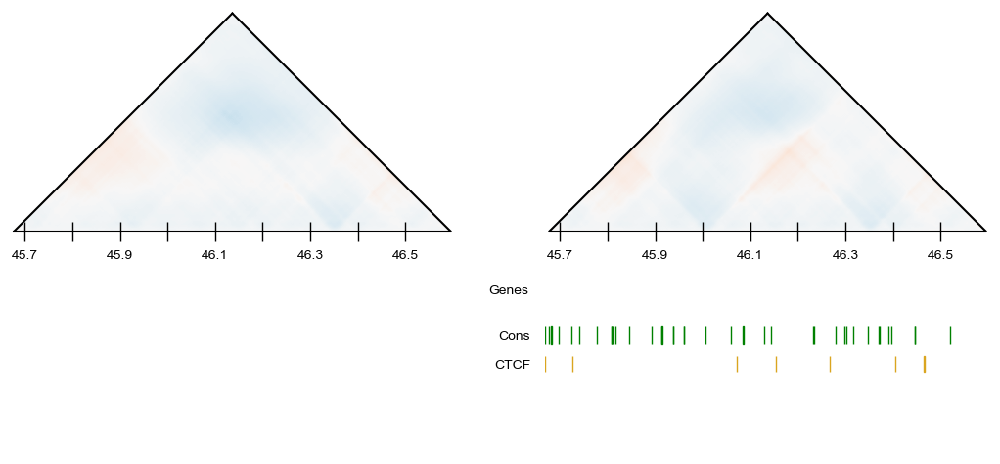

In [38]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr13_45613056', 'no')

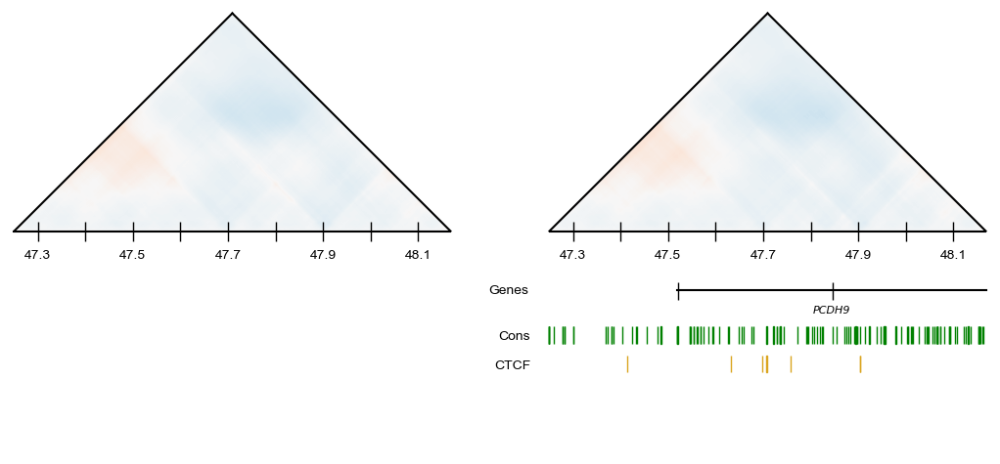

In [39]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr13_47185920', 'no')

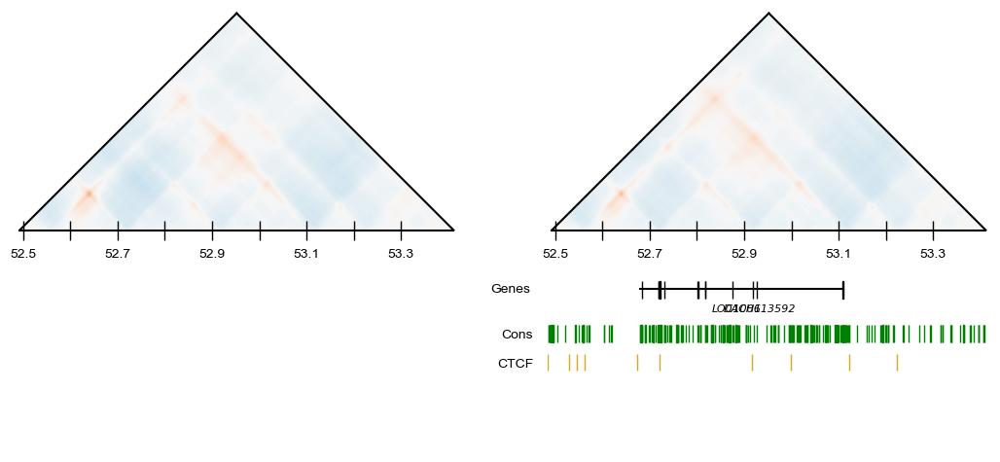

In [40]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr13_52428800', 'no')

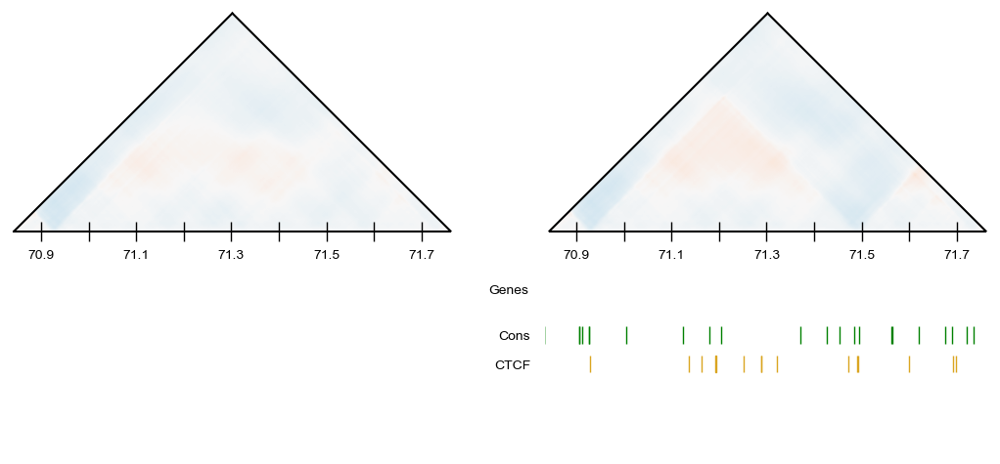

In [41]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr13_70778880', 'no')

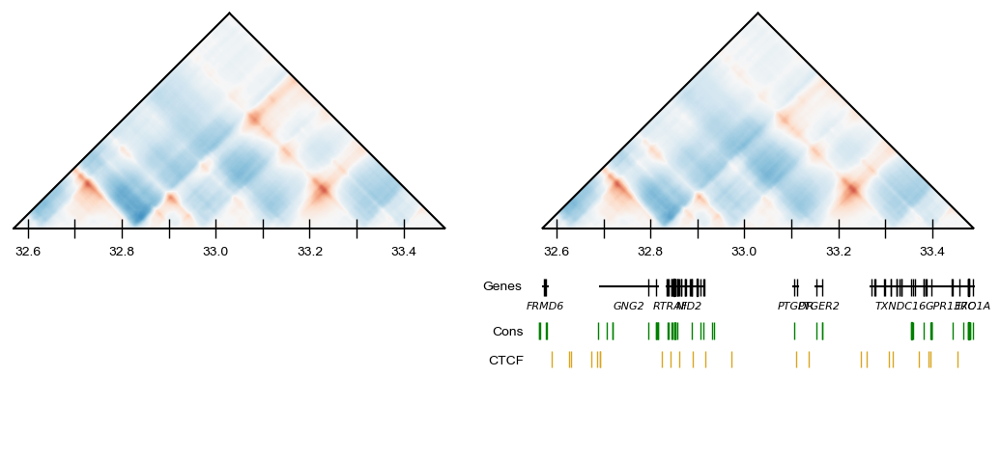

In [42]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr14_32505856', 'no')

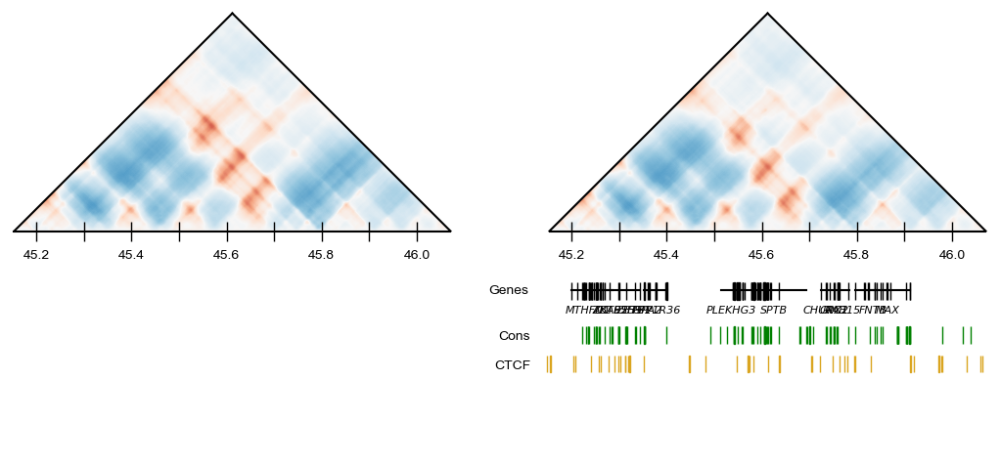

In [43]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr14_45088768', 'no')

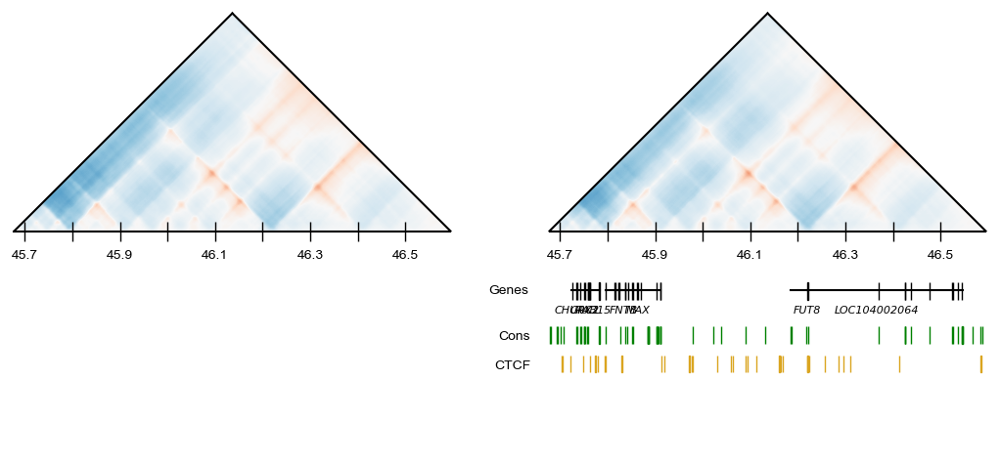

In [44]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr14_45613056', 'no')

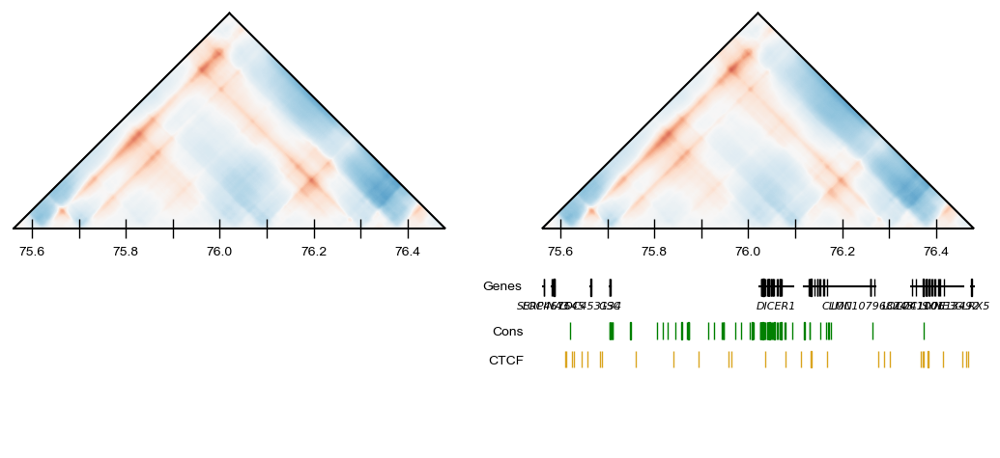

In [45]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr14_75497472', 'no')

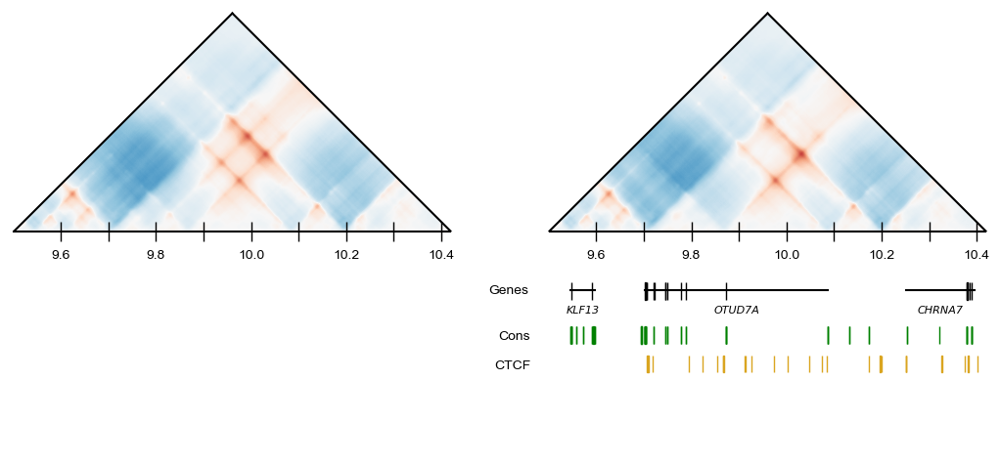

In [46]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr15_9437184', 'no')

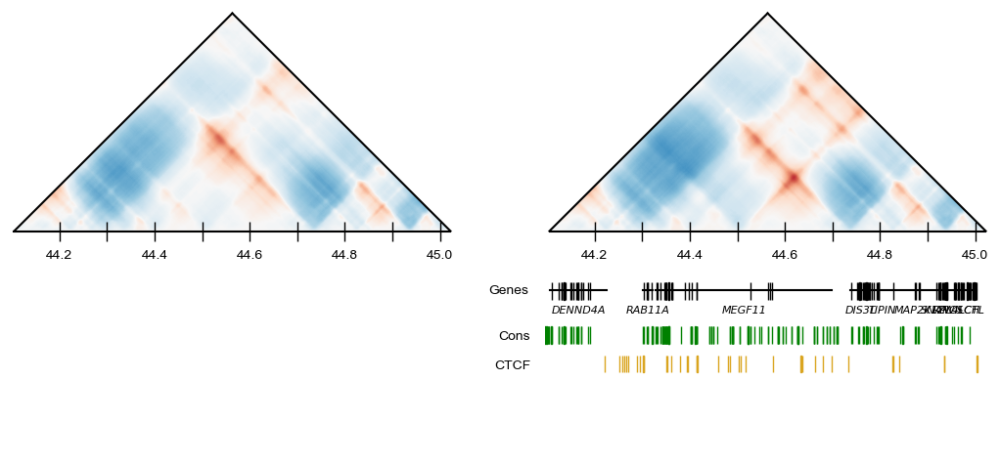

In [47]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr15_44040192', 'no')

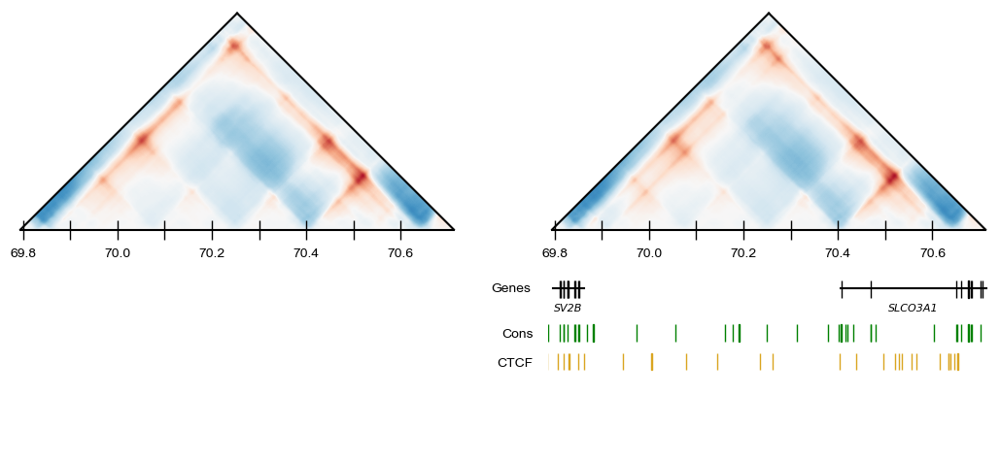

In [48]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr15_69730304', 'no')

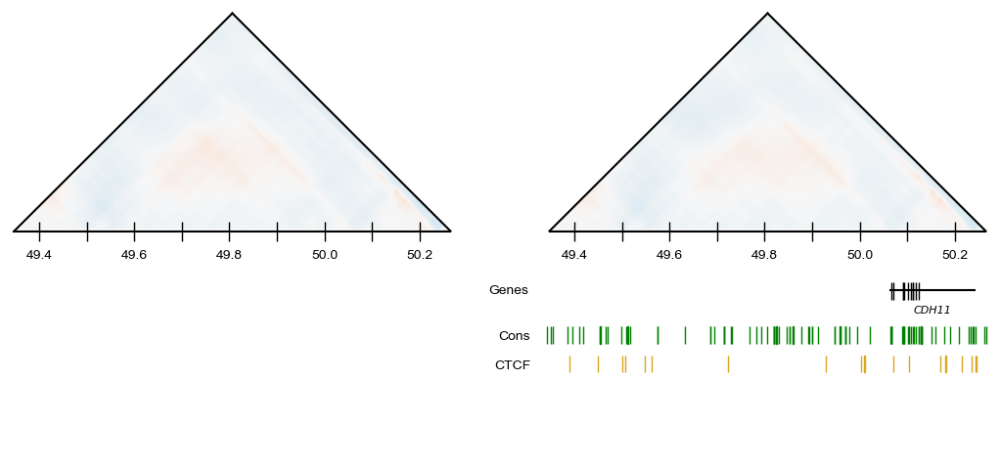

In [49]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr16_49283072', 'no')

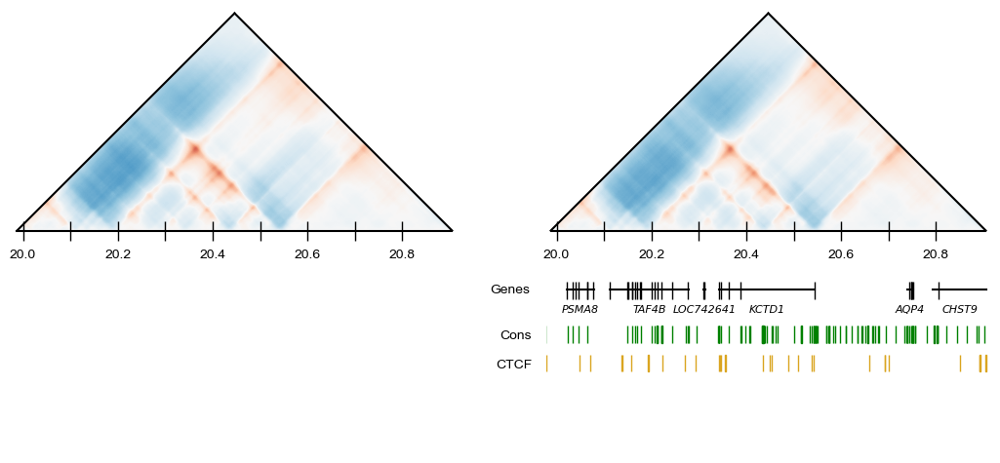

In [50]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr18_19922944', 'no')

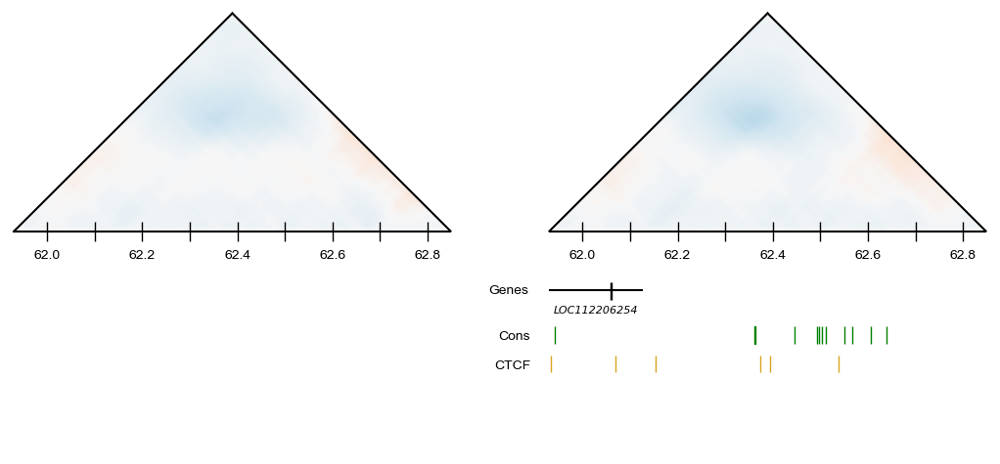

In [51]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr18_61865984', 'no')

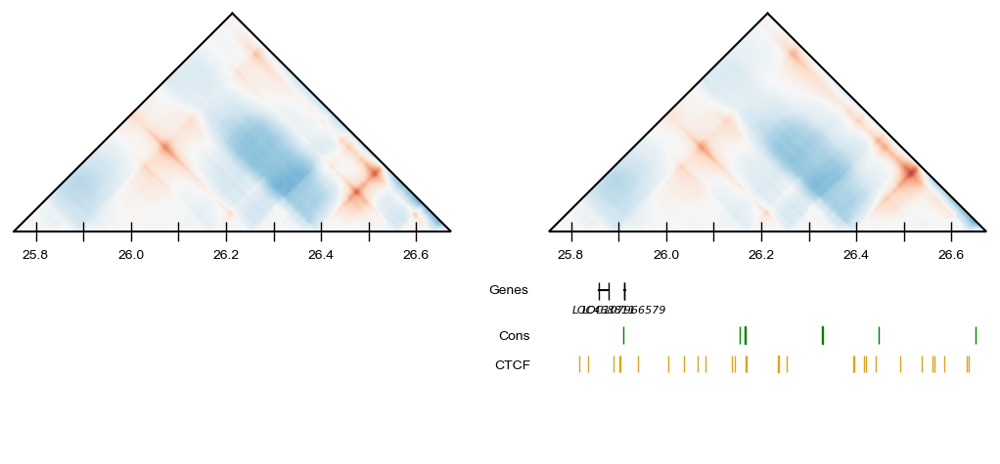

In [52]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr19_25690112', 'no')

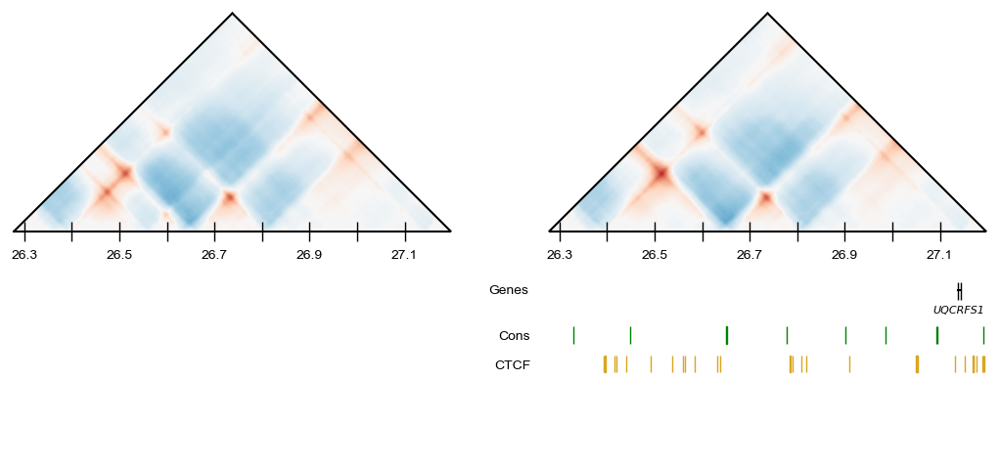

In [53]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr19_26214400', 'no')

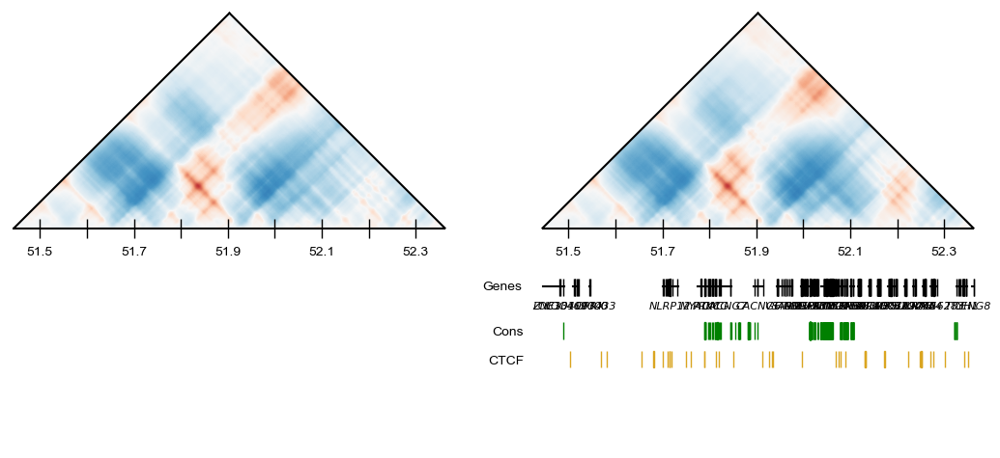

In [54]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr19_51380224', 'no')

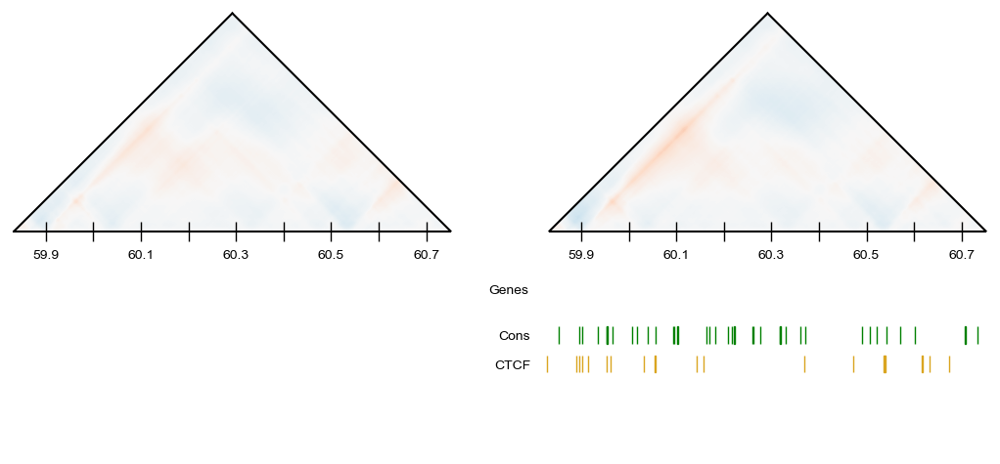

In [55]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr20_59768832', 'no')

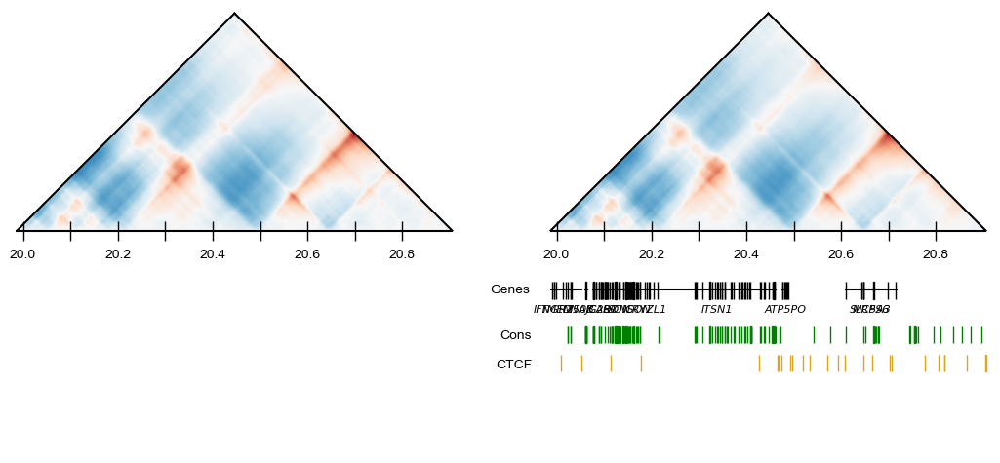

In [56]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr21_19922944', 'no')

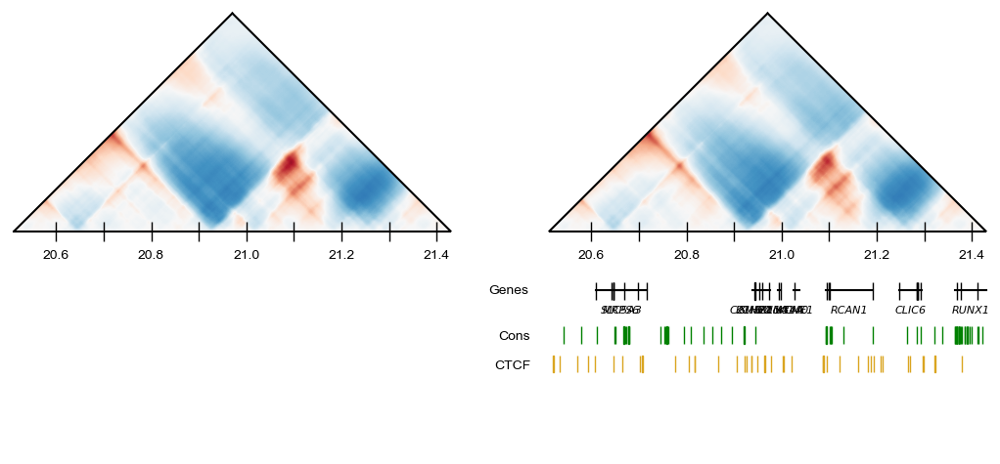

In [57]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr21_20447232', 'no')

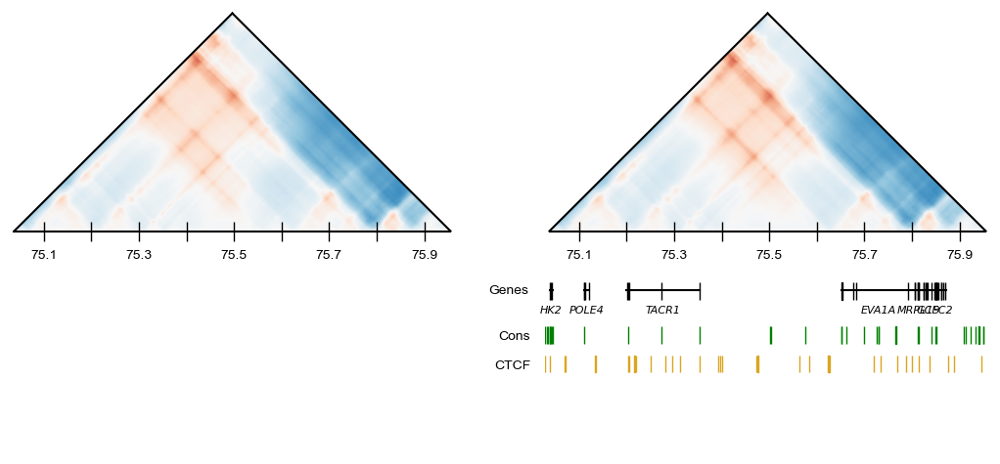

In [58]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr2A_74973184', 'no')

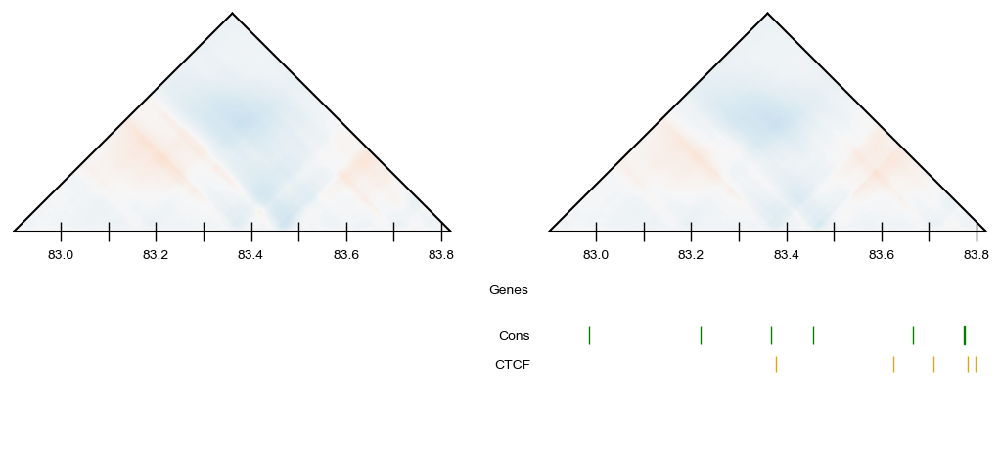

In [59]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr2A_82837504', 'no')

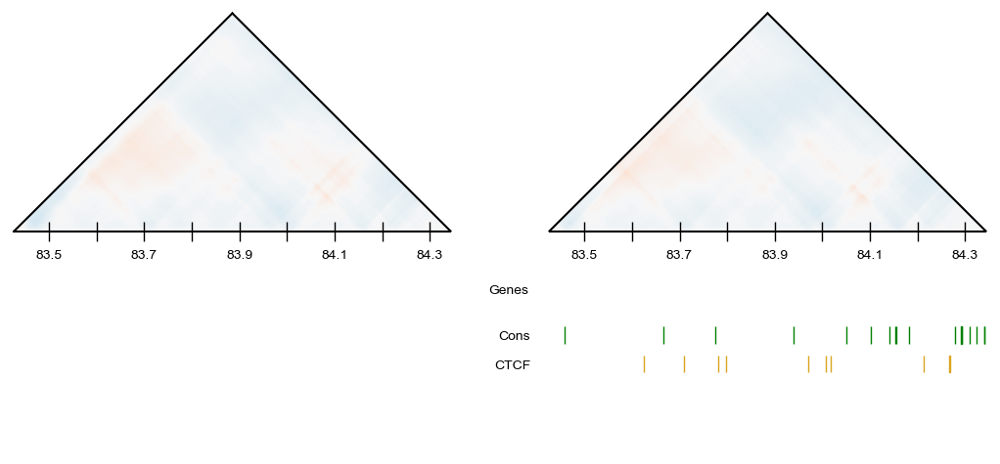

In [60]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr2A_83361792', 'no')

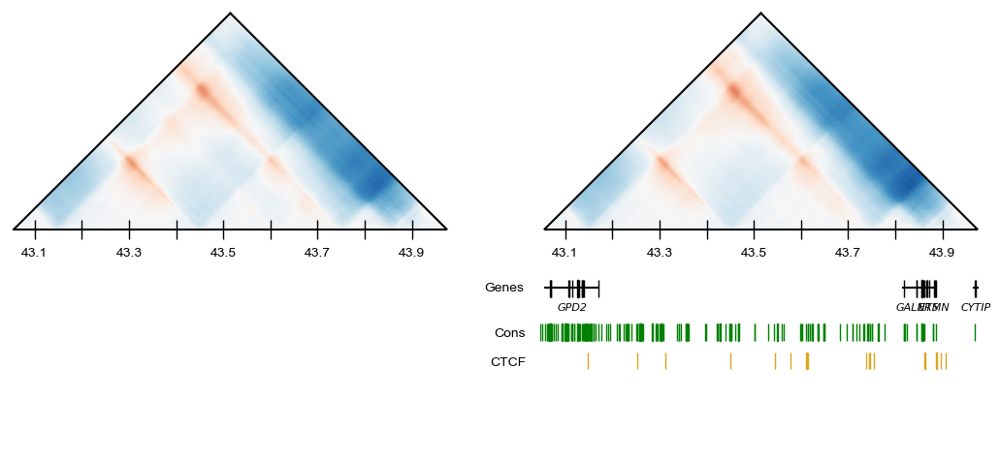

In [61]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr2B_42991616', 'no')

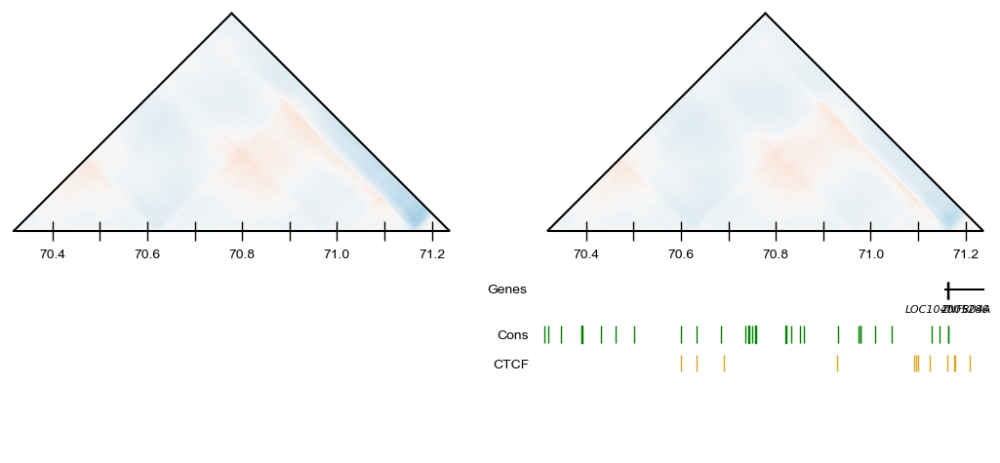

In [62]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr2B_70254592', 'no')

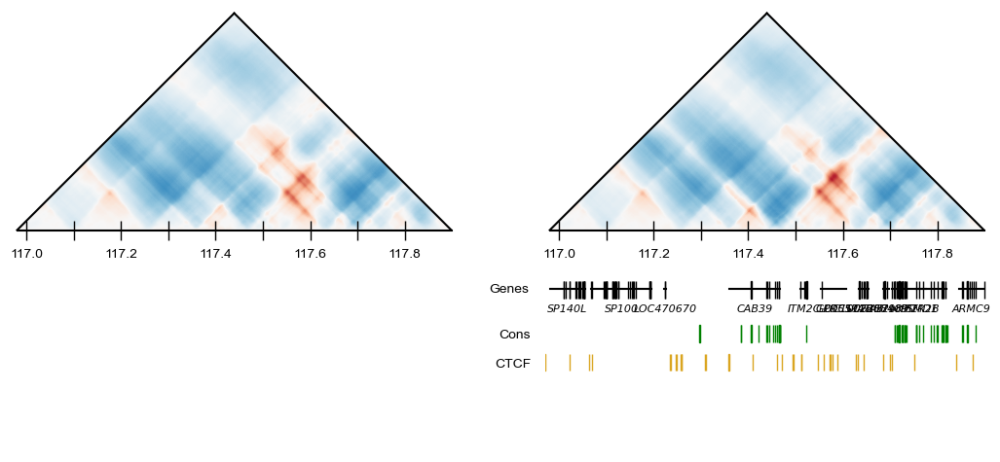

In [63]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr2B_116916224', 'no')

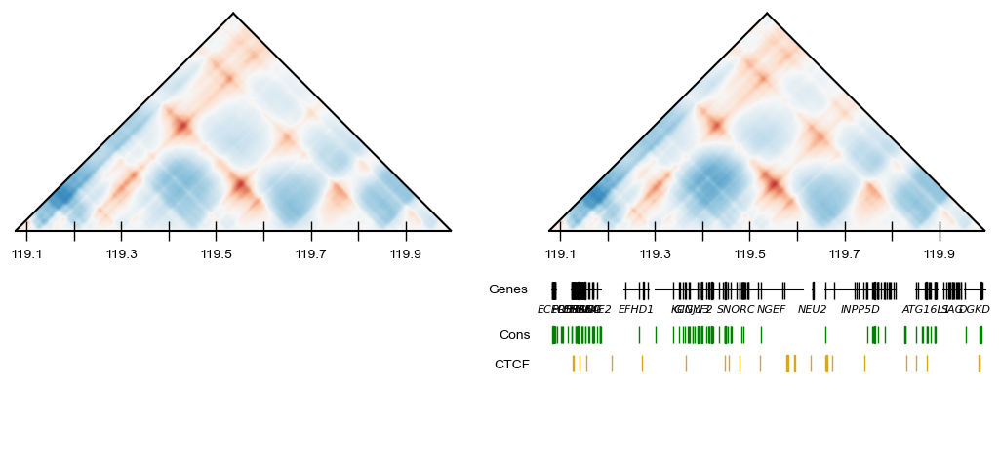

In [64]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr2B_119013376', 'no')

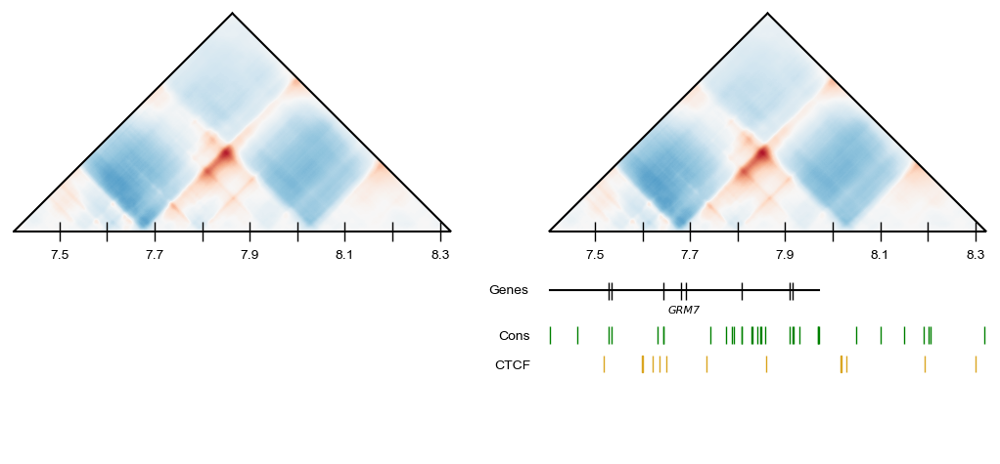

In [65]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_7340032', 'no')

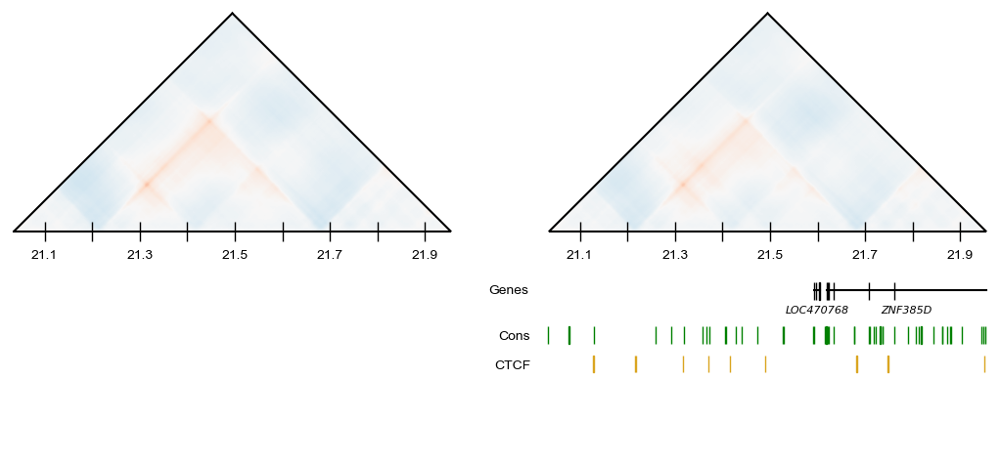

In [66]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_20971520', 'no')

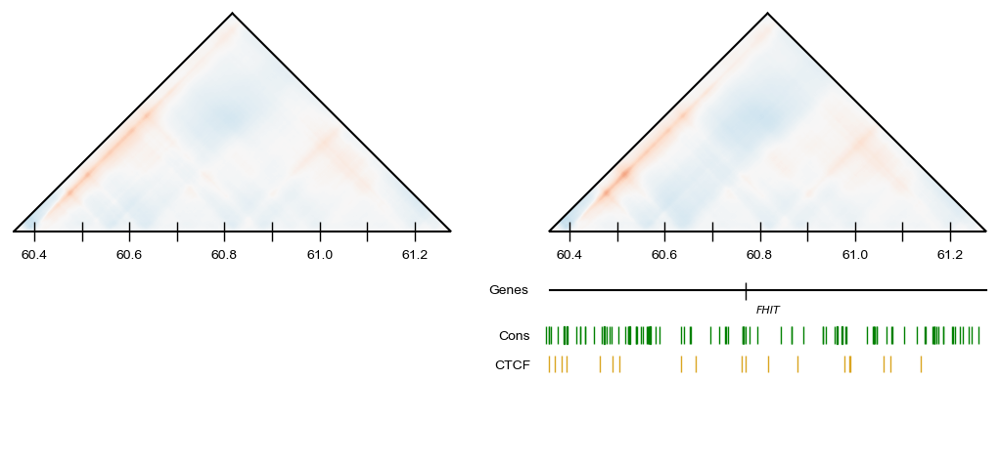

In [67]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_60293120', 'no')

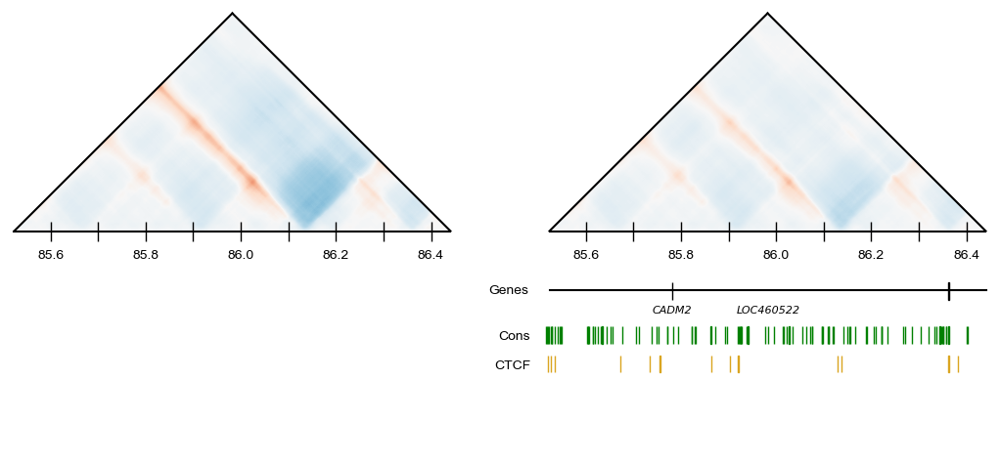

In [68]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_85458944', 'no')

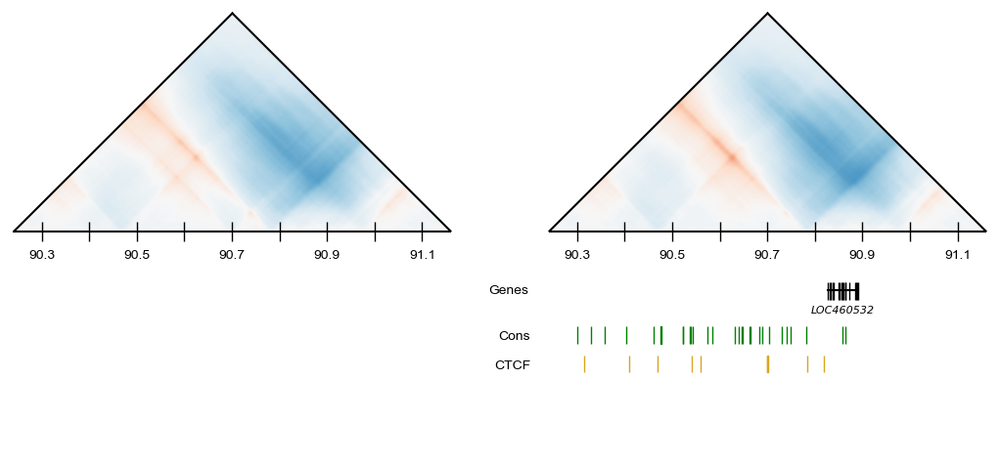

In [69]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_90177536', 'no')

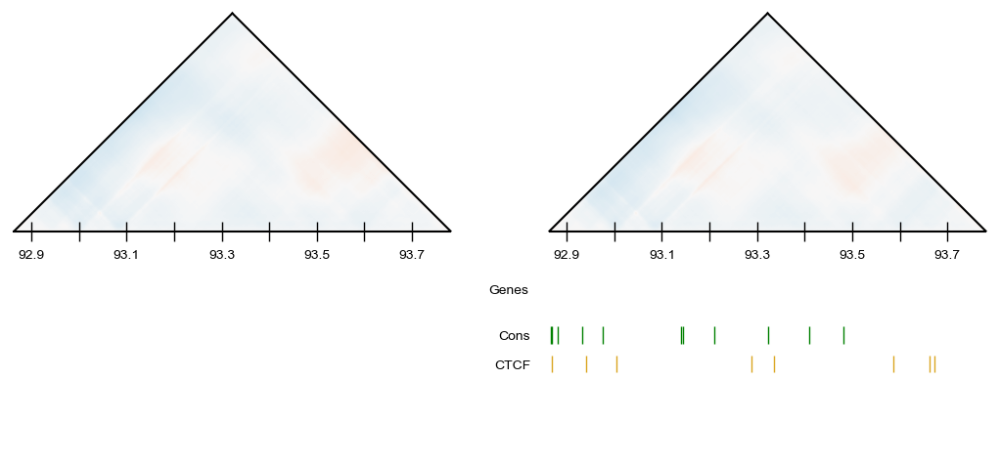

In [70]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_92798976', 'no')

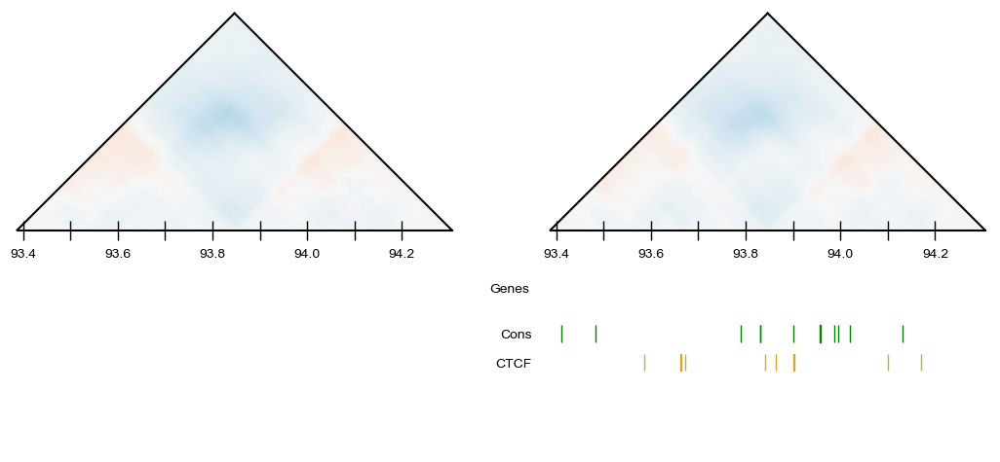

In [71]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_93323264', 'no')

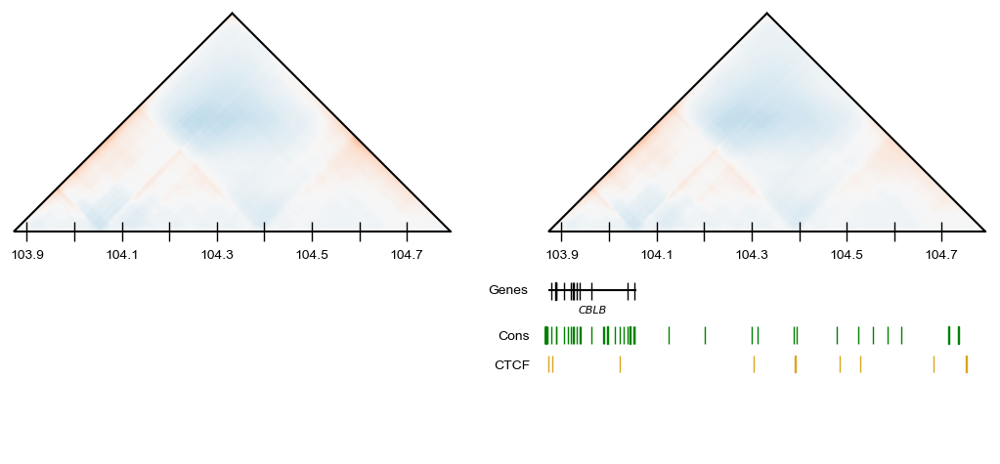

In [72]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_103809024', 'no')

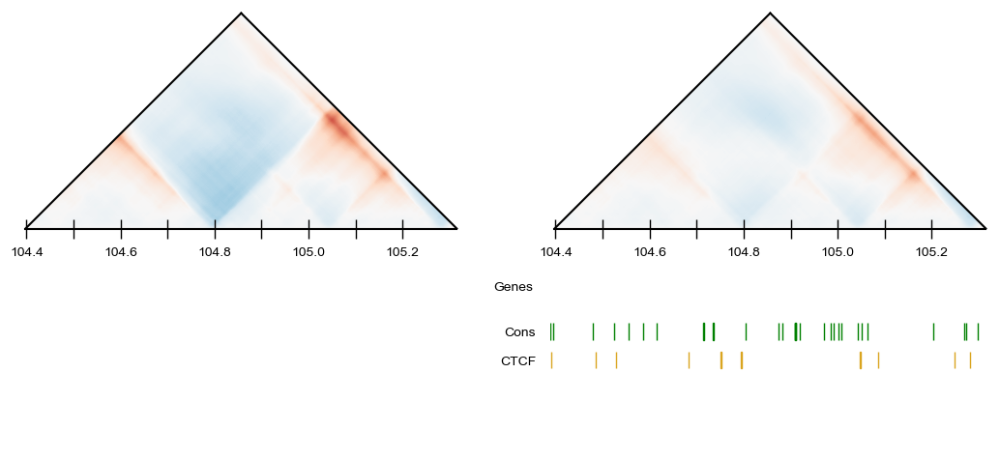

In [73]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_104333312', 'no')

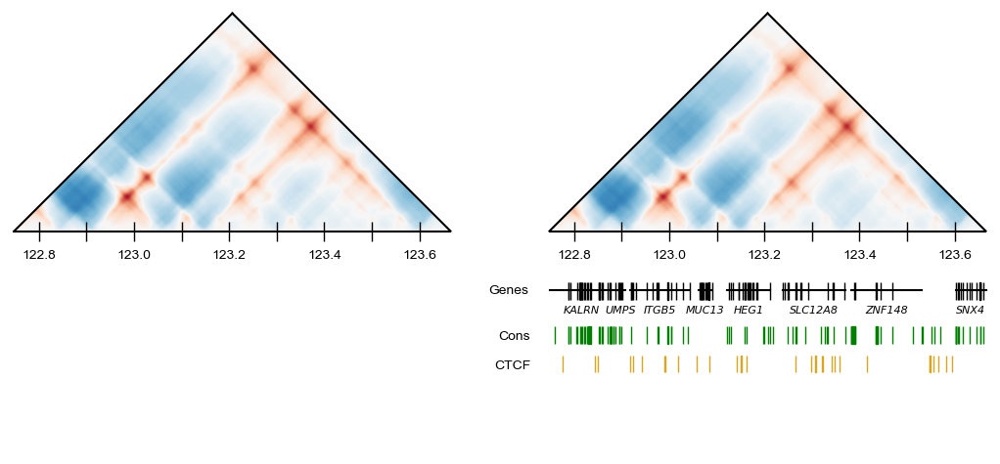

In [74]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_122683392', 'no')

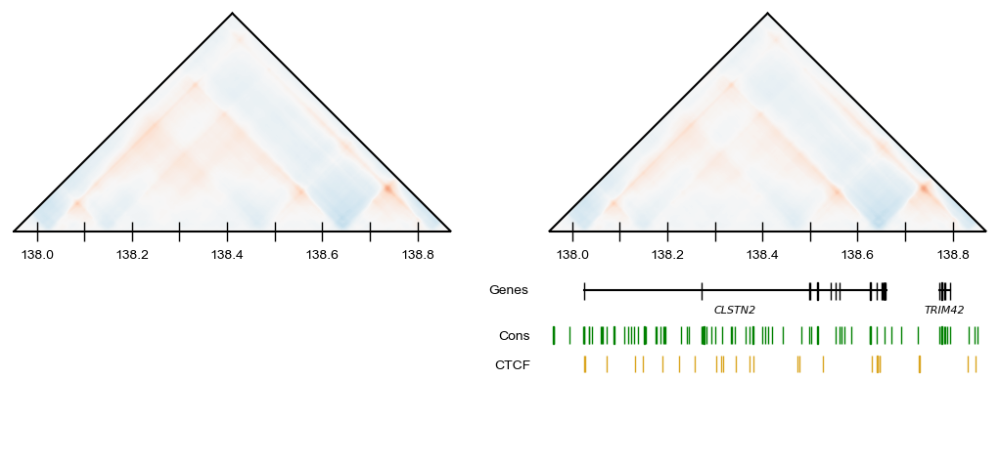

In [75]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_137887744', 'no')

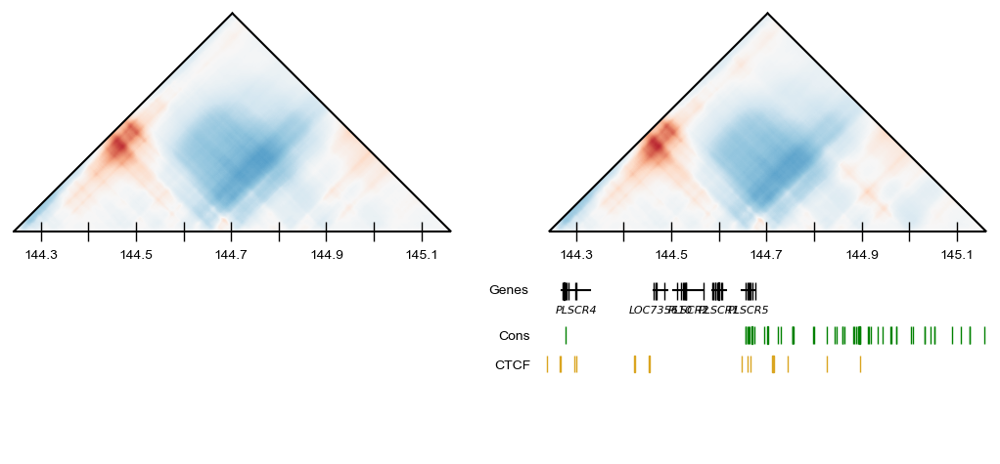

In [76]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_144179200', 'no')

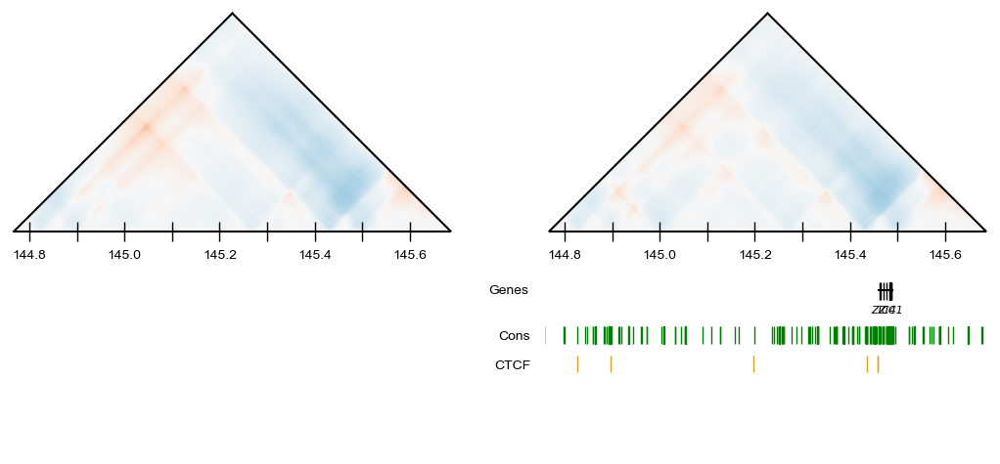

In [77]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr3_144703488', 'no')

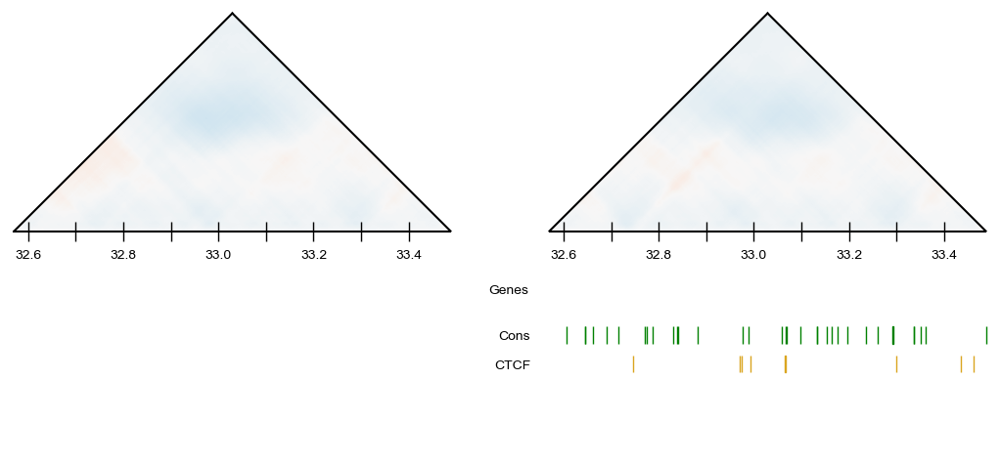

In [78]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_32505856', 'no')

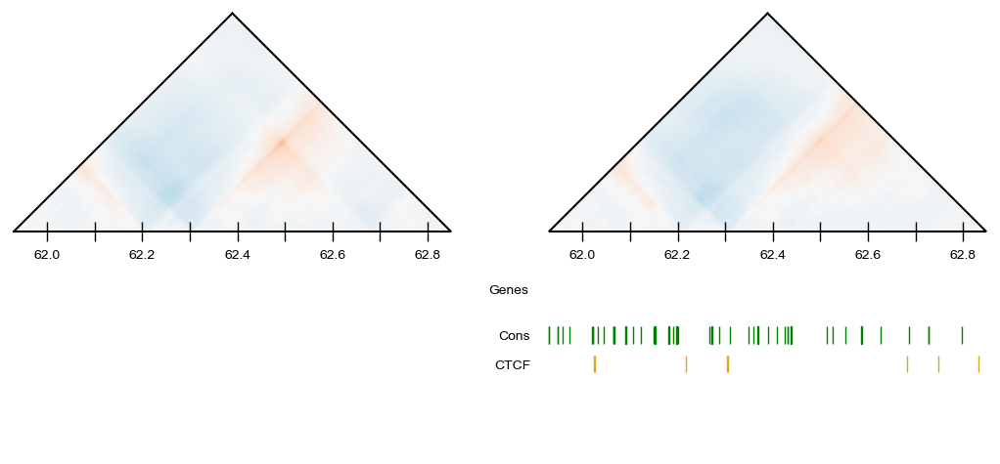

In [79]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_61865984', 'no')

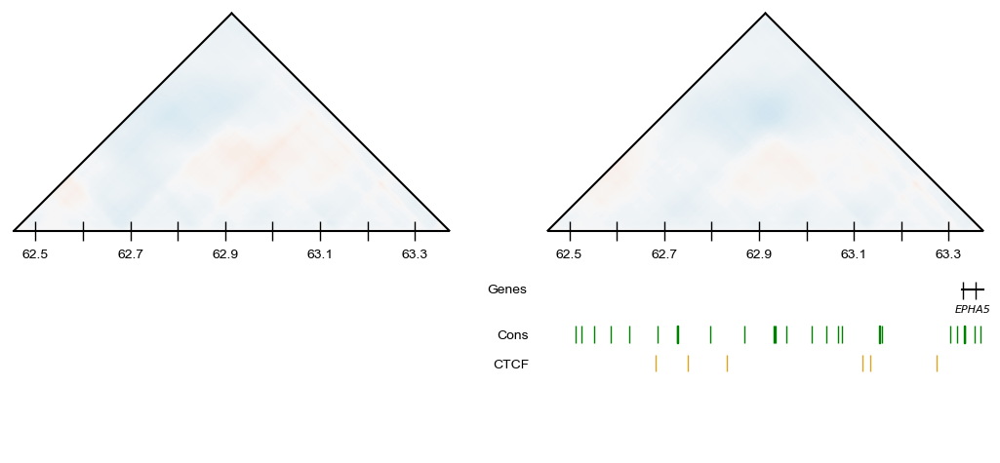

In [80]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_62390272', 'no')

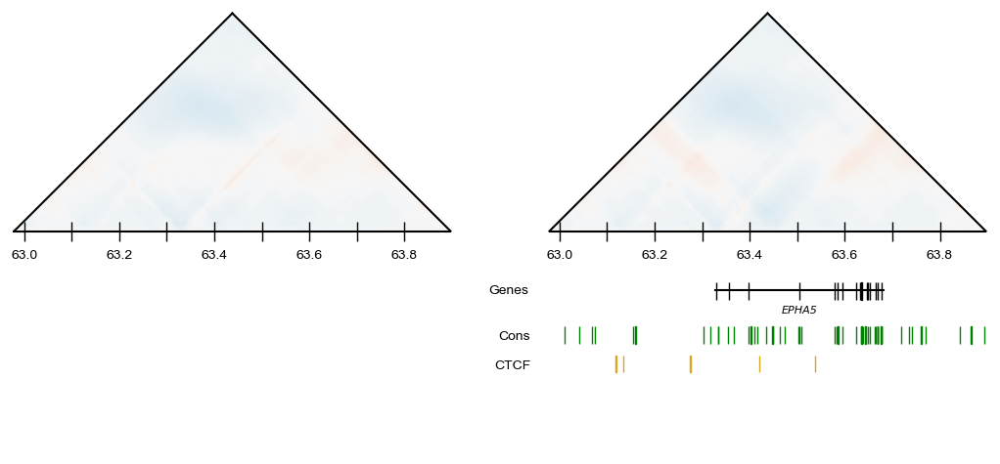

In [81]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_62914560', 'no')

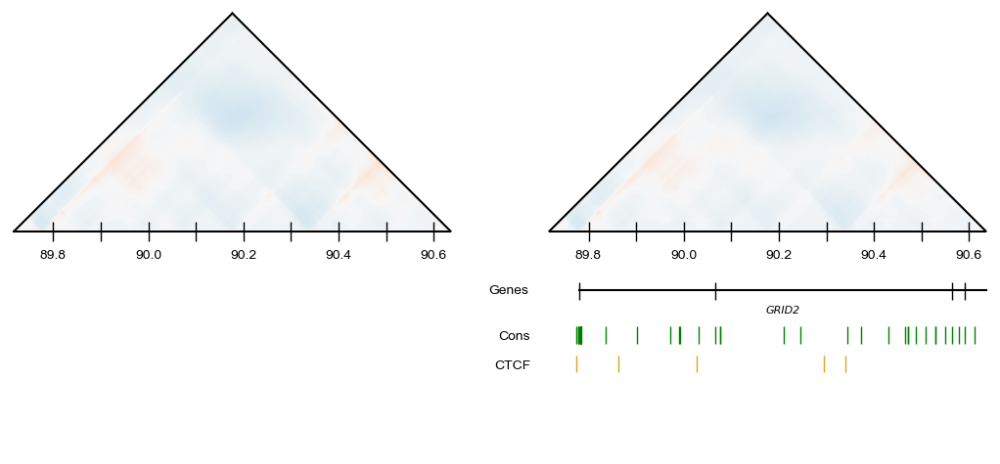

In [82]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_89653248', 'no')

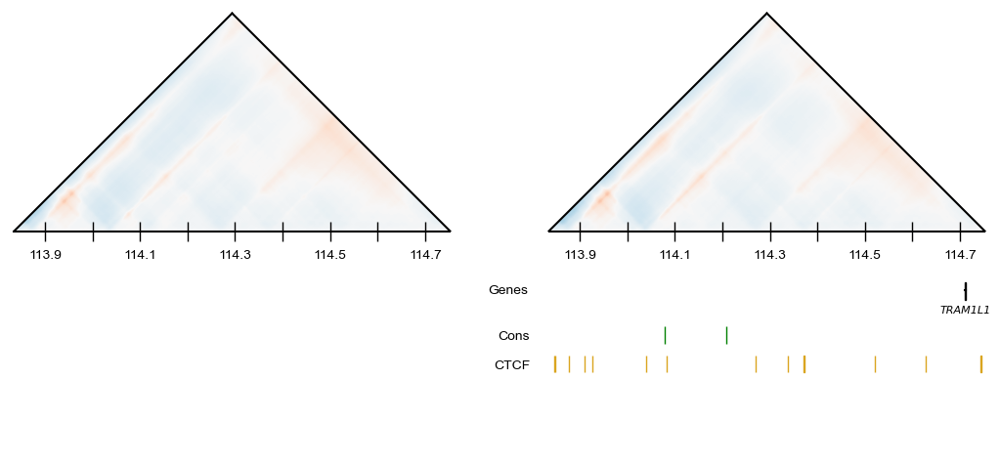

In [83]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_113770496', 'no')

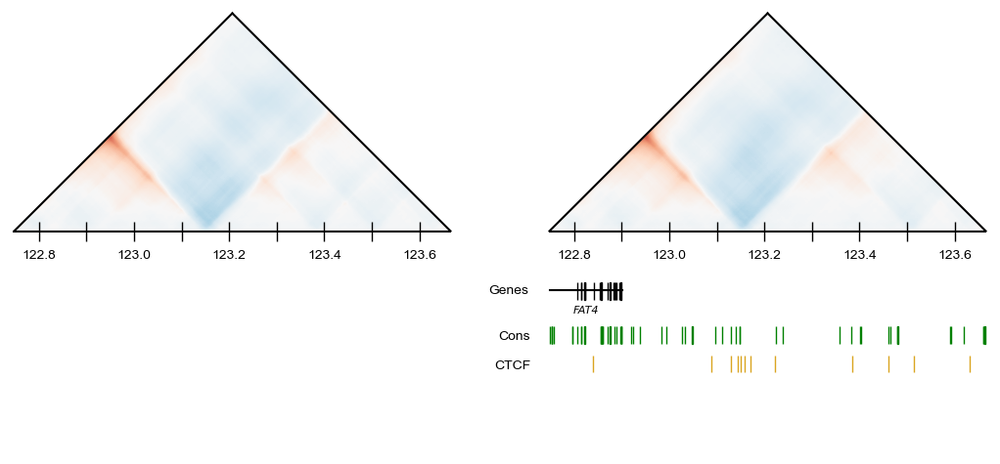

In [84]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_122683392', 'no')

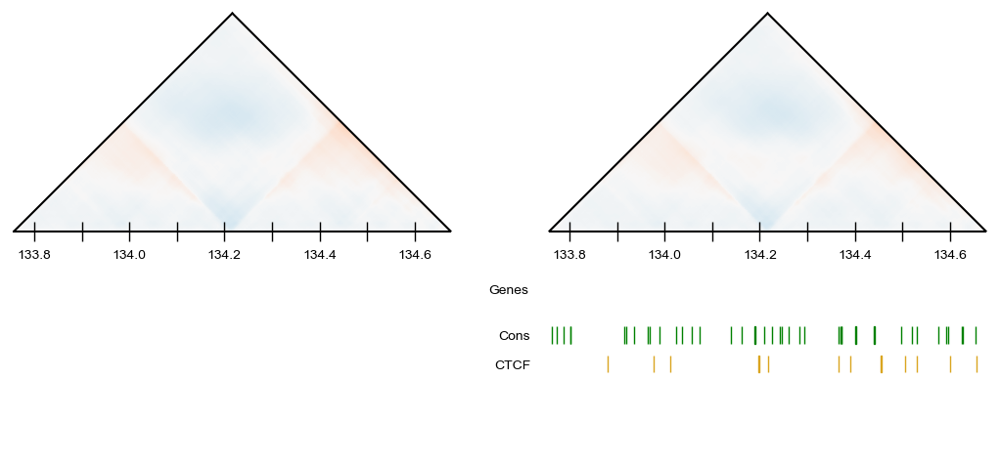

In [85]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr4_133693440', 'no')

Comparisons saved.


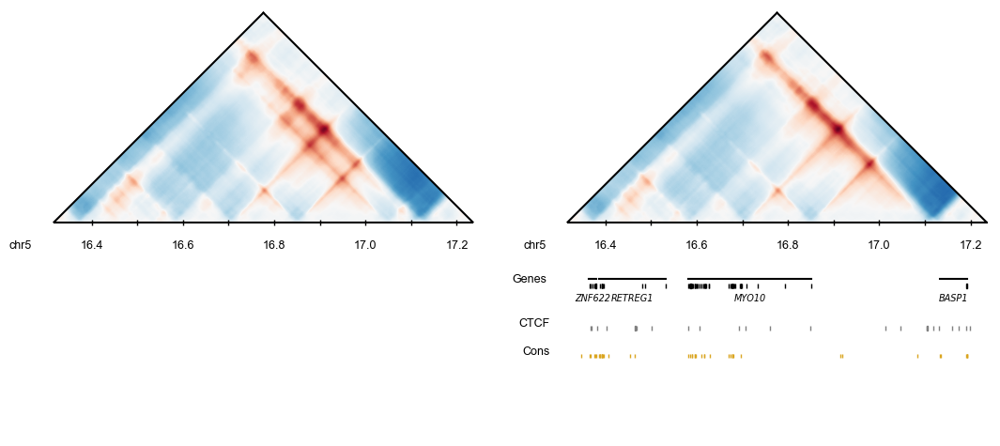

In [28]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr5_16252928', 'no')

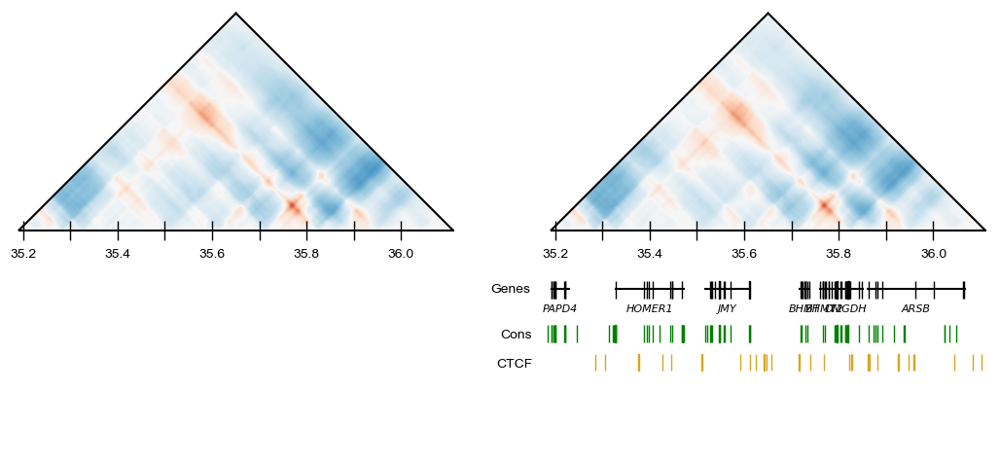

In [87]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr5_35127296', 'no')

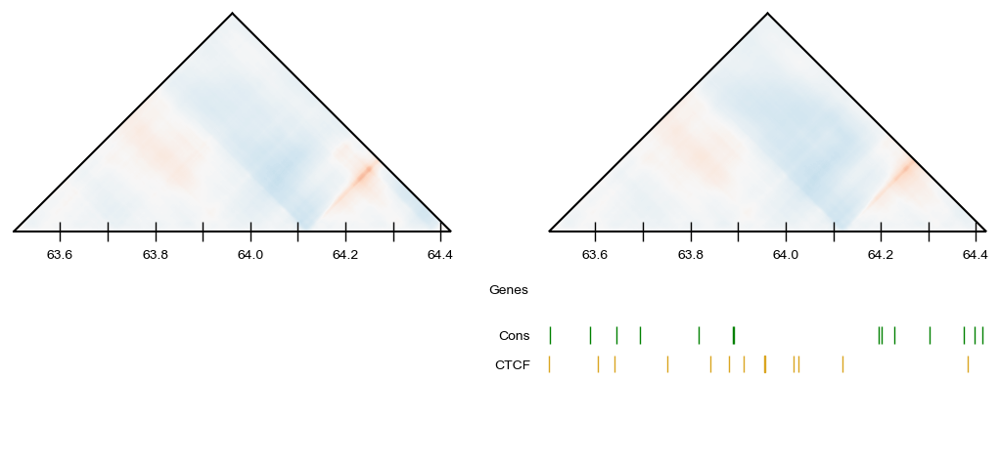

In [88]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr6_63438848', 'no')

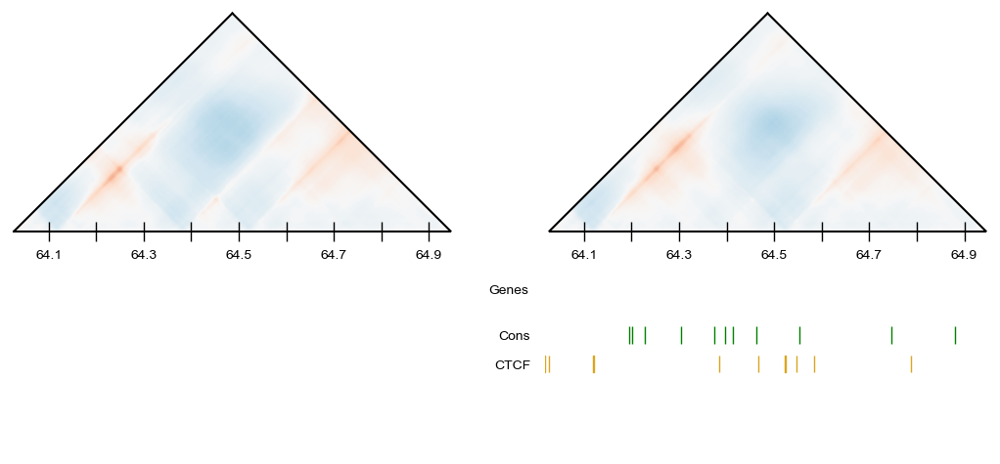

In [89]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr6_63963136', 'no')

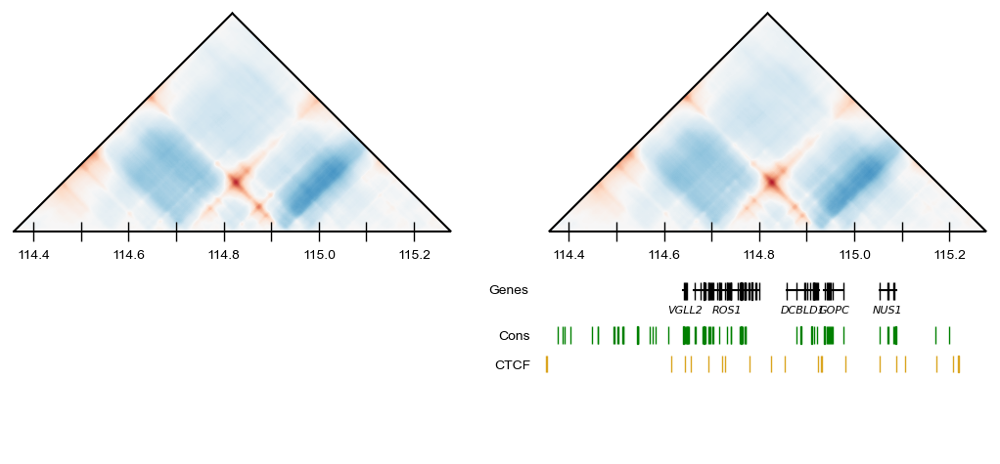

In [90]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr6_114294784', 'no')

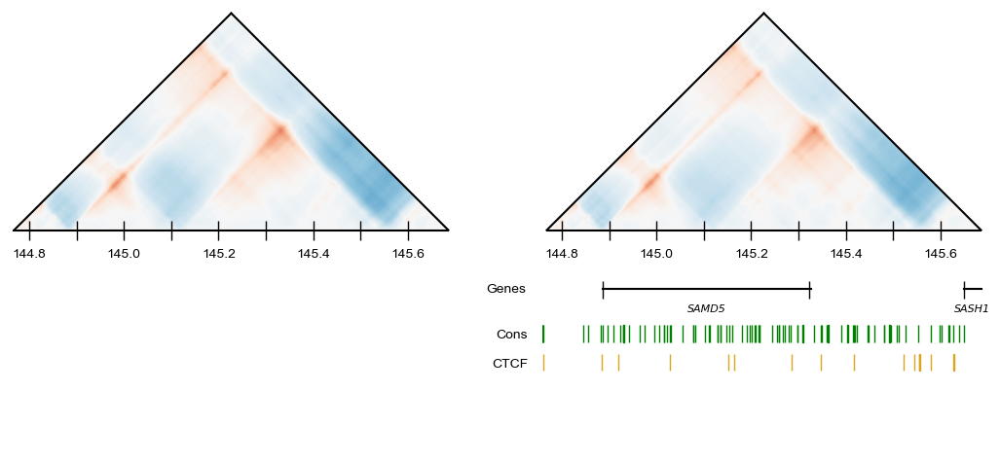

In [91]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr6_144703488', 'no')

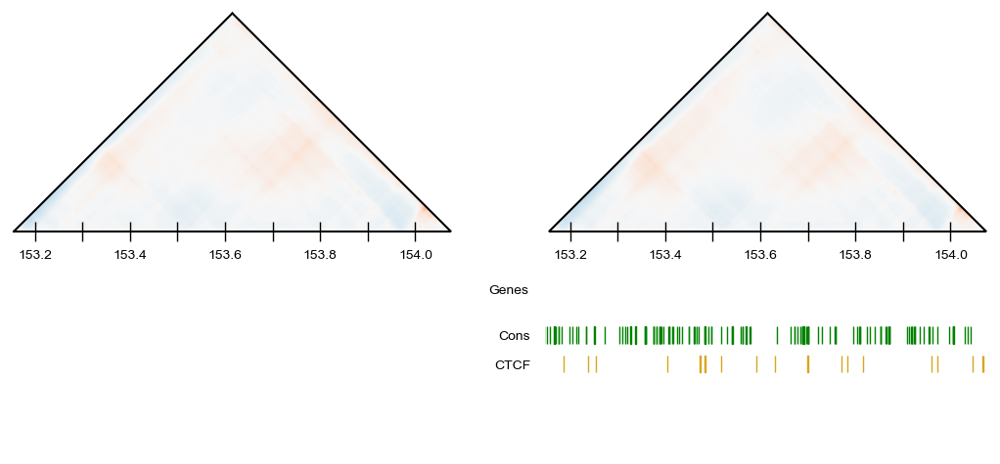

In [92]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr6_153092096', 'no')

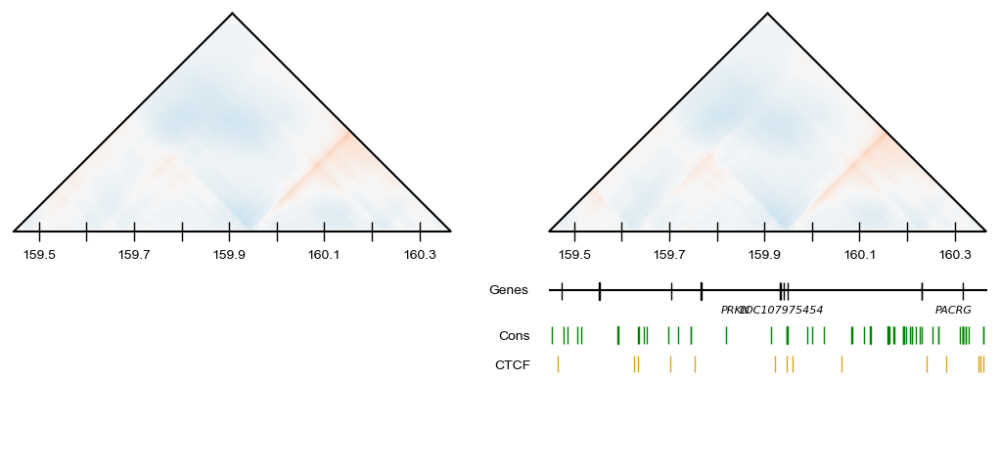

In [93]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr6_159383552', 'no')

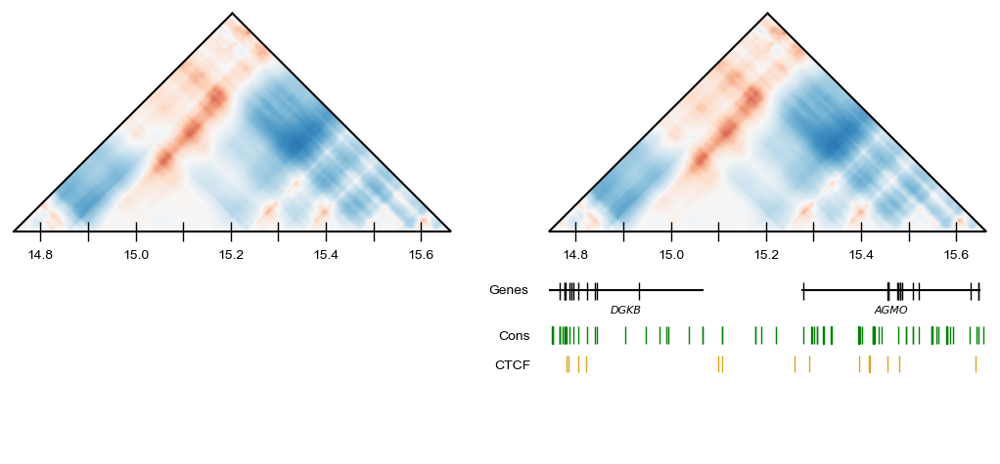

In [94]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr7_14680064', 'no')

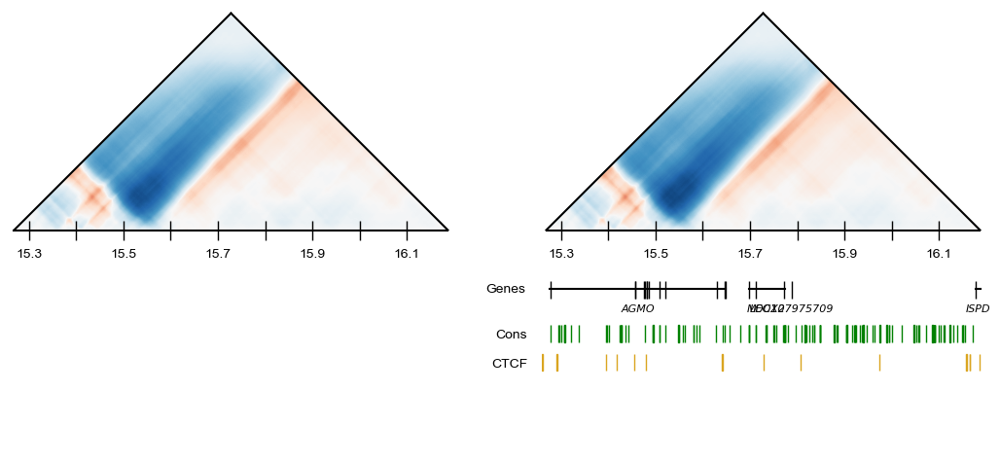

In [95]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr7_15204352', 'no')

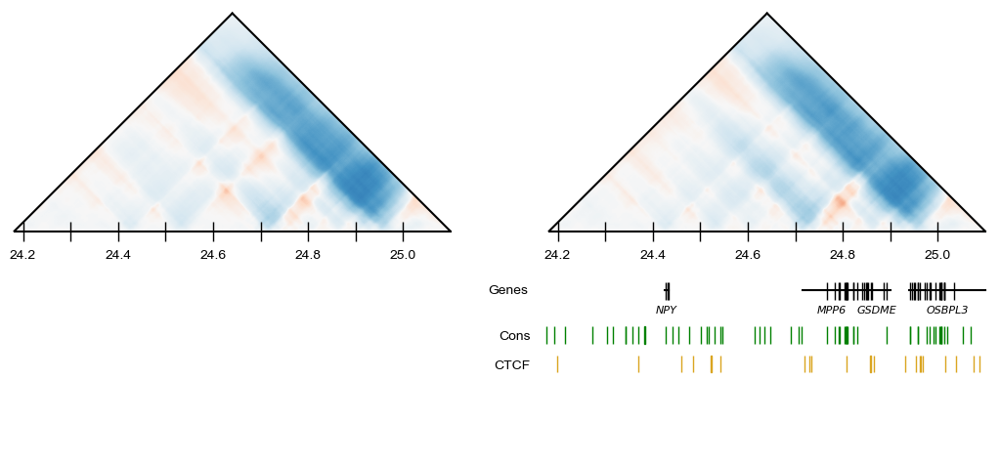

In [96]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr7_24117248', 'no')

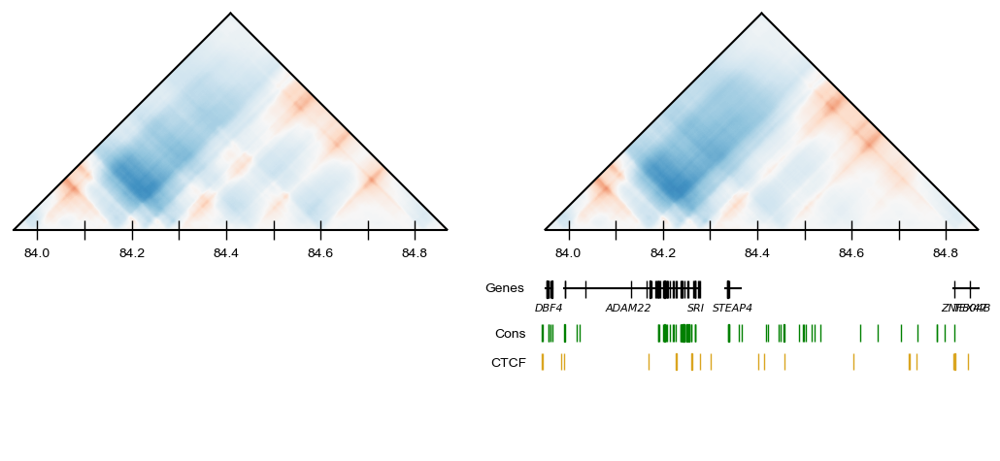

In [97]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr7_83886080', 'no')

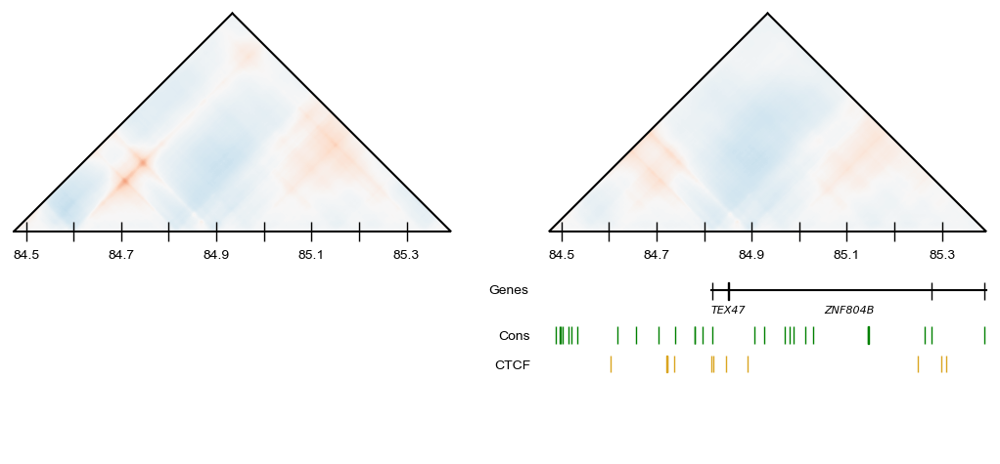

In [98]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr7_84410368', 'no')

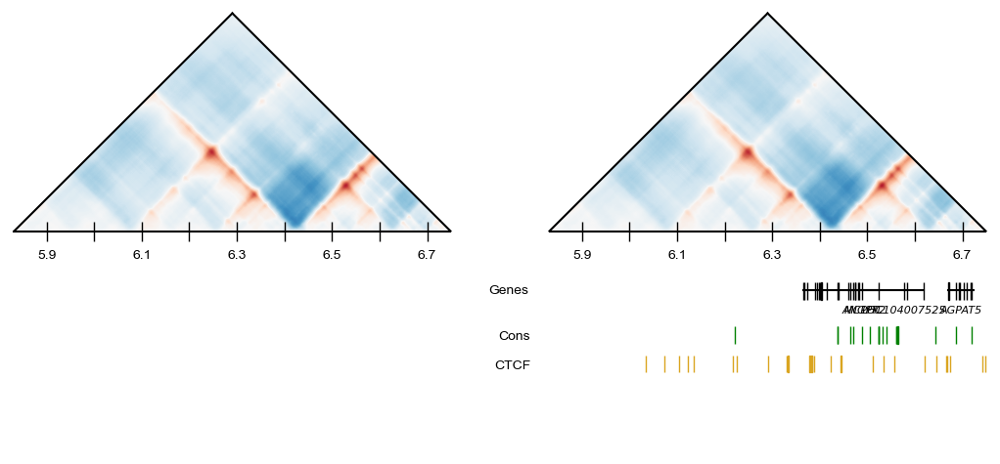

In [99]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr8_5767168', 'no')

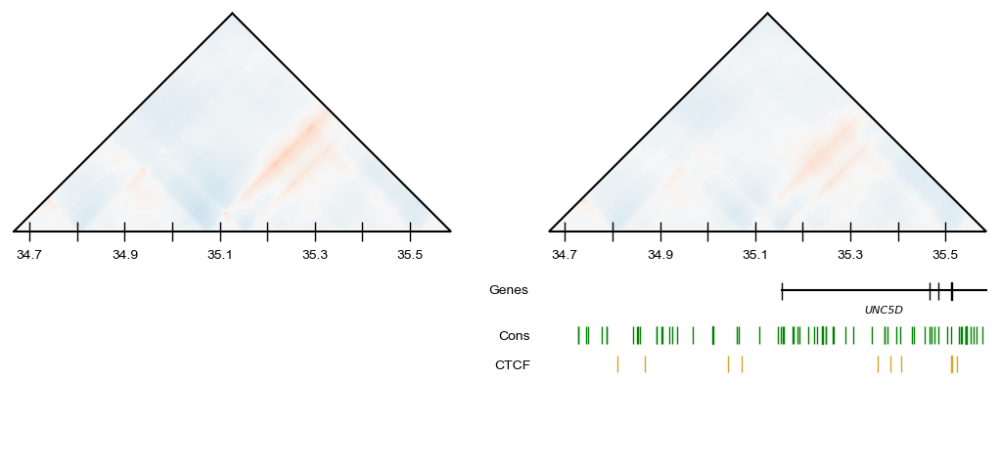

In [100]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr8_34603008', 'no')

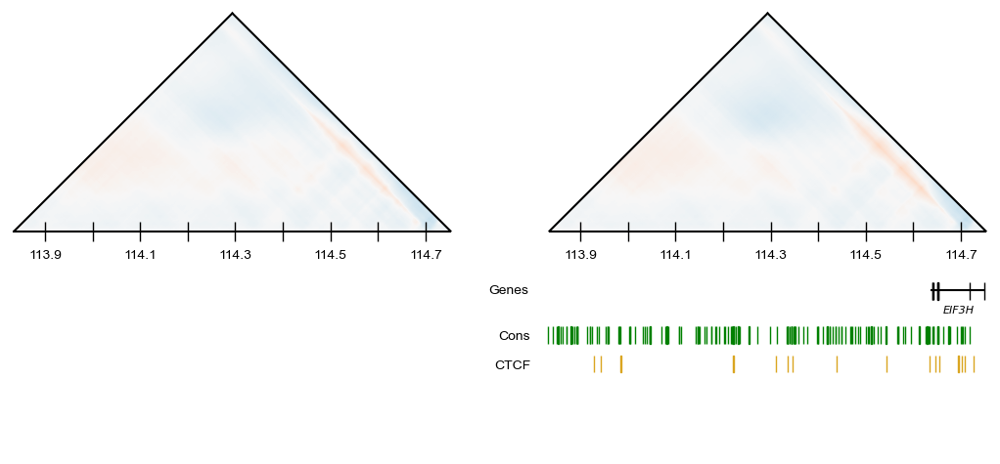

In [101]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr8_113770496', 'no')

The history saving thread hit an unexpected error (OperationalError('database is locked')).History will not be written to the database.


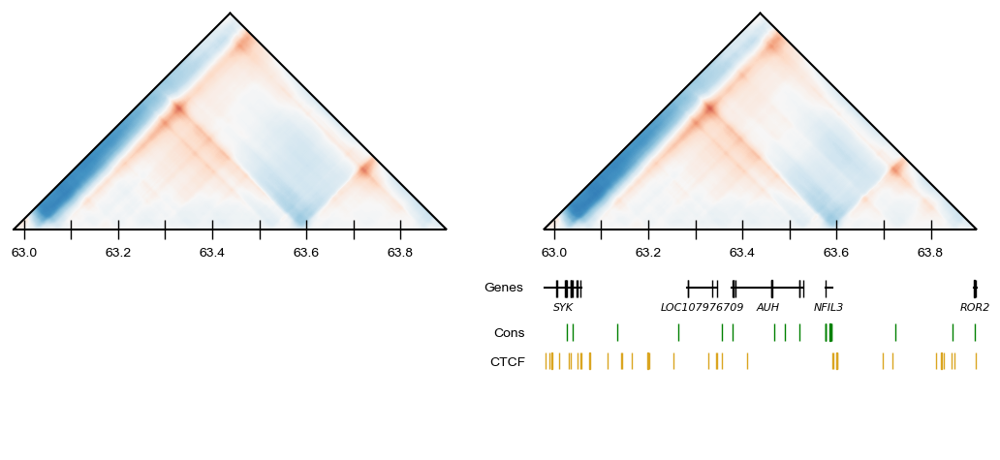

In [102]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr9_62914560', 'no')

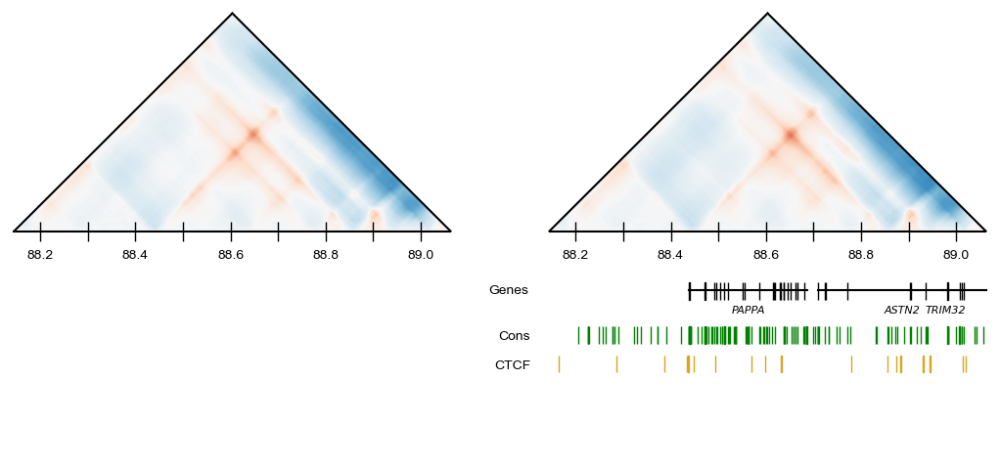

In [103]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr9_88080384', 'no')

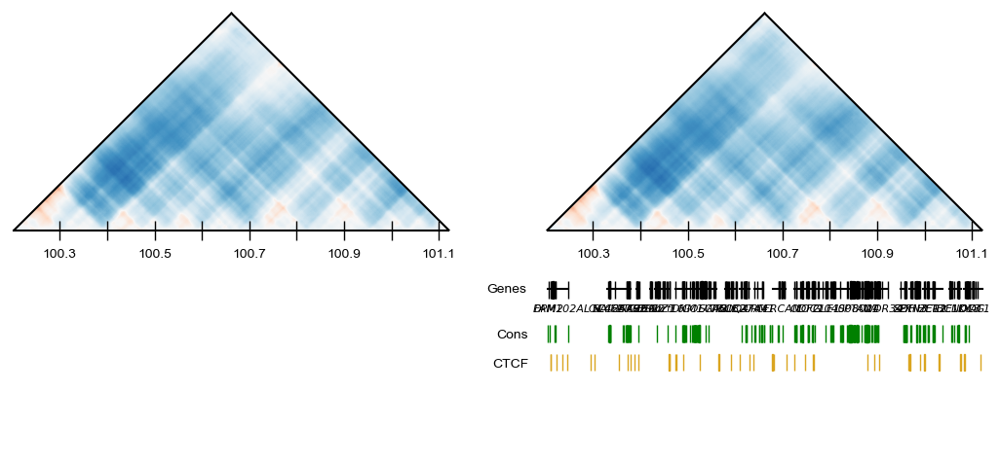

In [104]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr9_100139008', 'no')

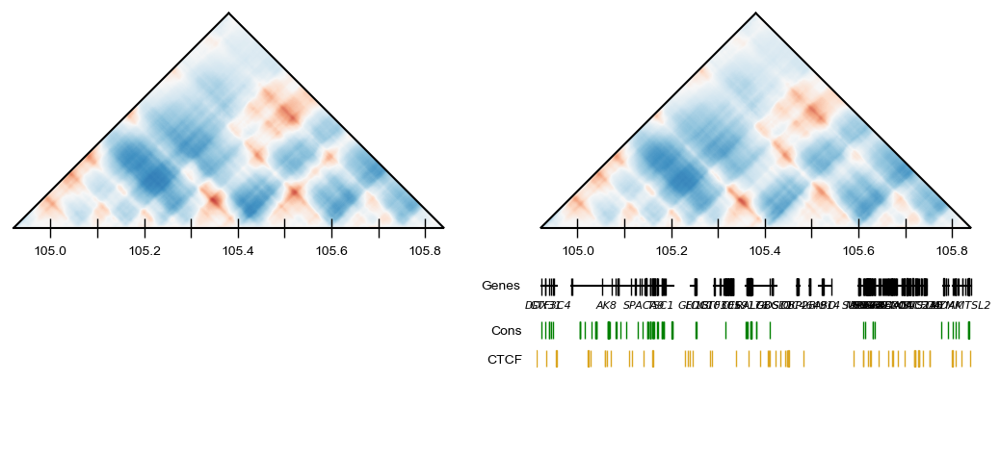

In [105]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chr9_104857600', 'no')

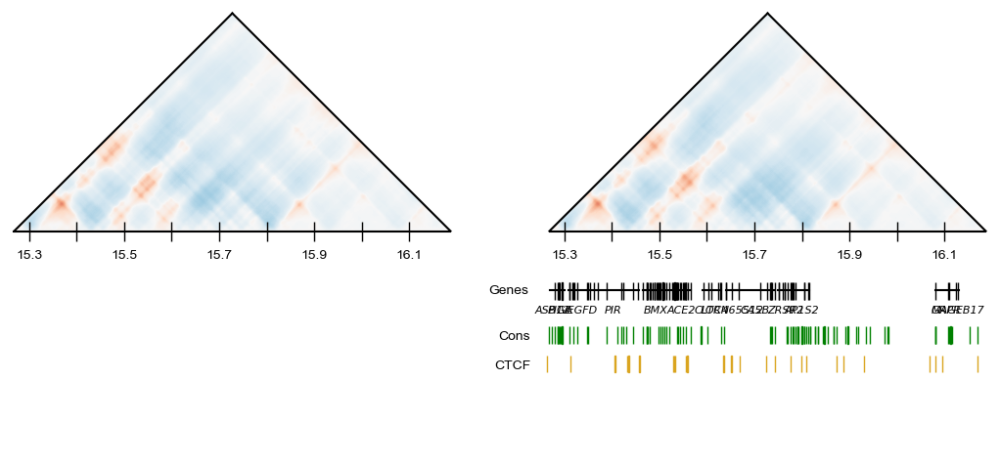

In [106]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chrX_15204352', 'no')

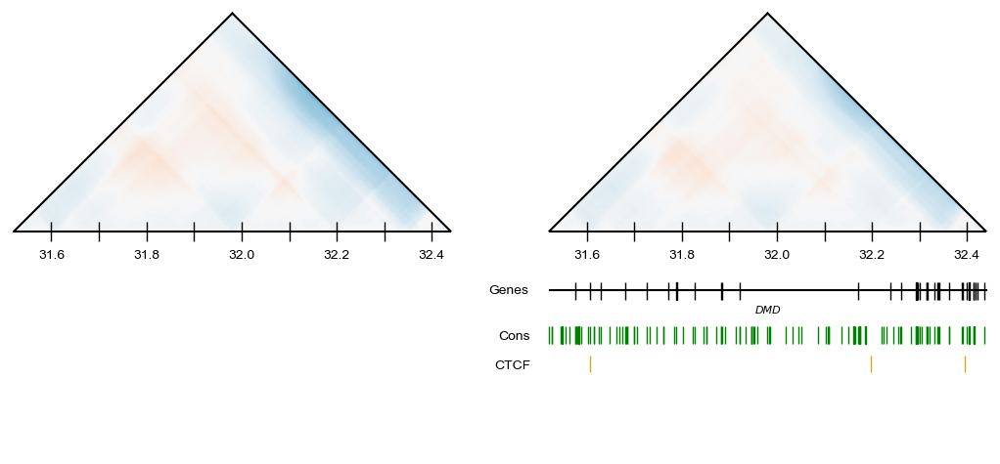

In [107]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chrX_31457280', 'no')

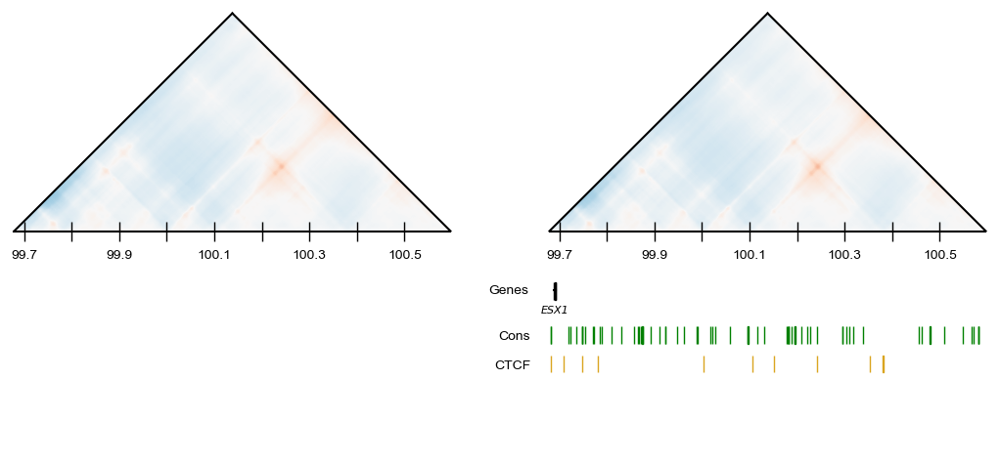

In [108]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chrX_99614720', 'no')

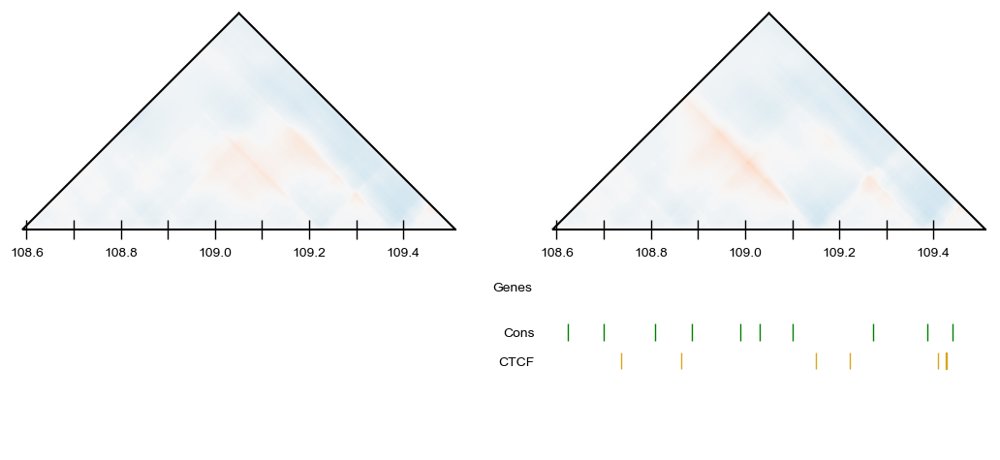

In [109]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chrX_108527616', 'no')

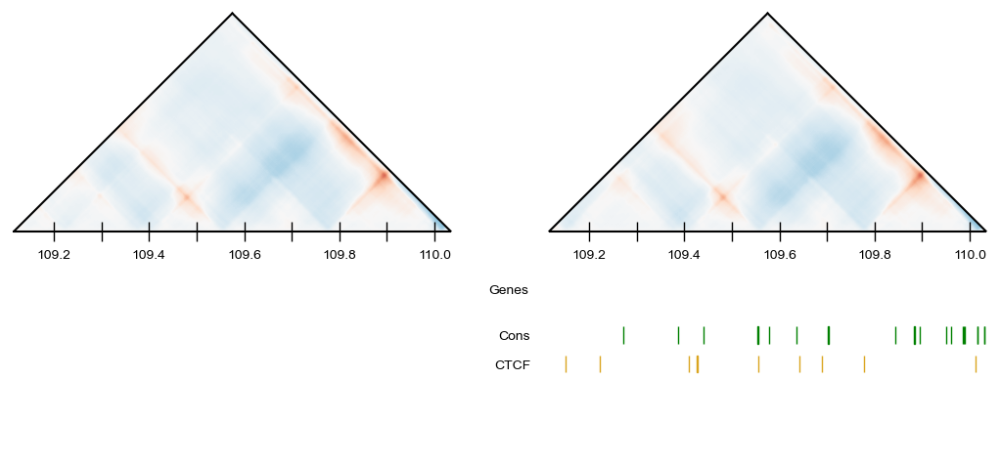

In [110]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chrX_109051904', 'no')

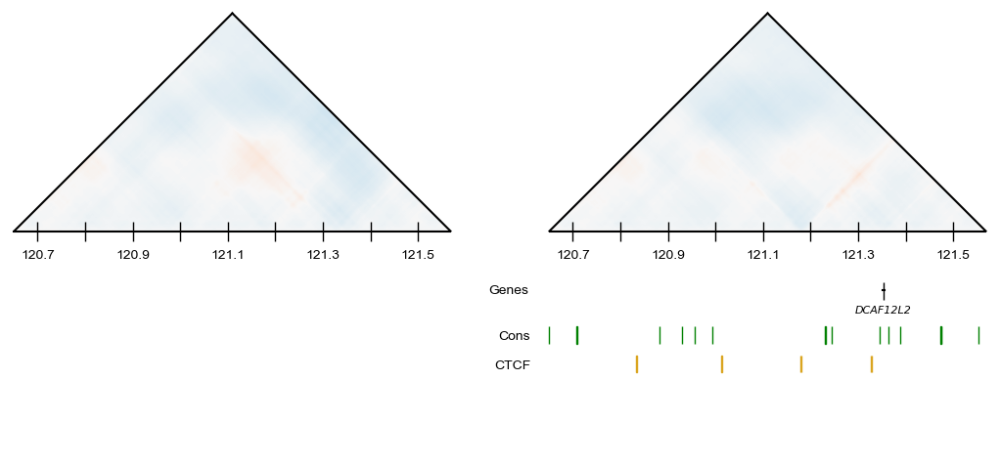

In [111]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chrX_120586240', 'no')

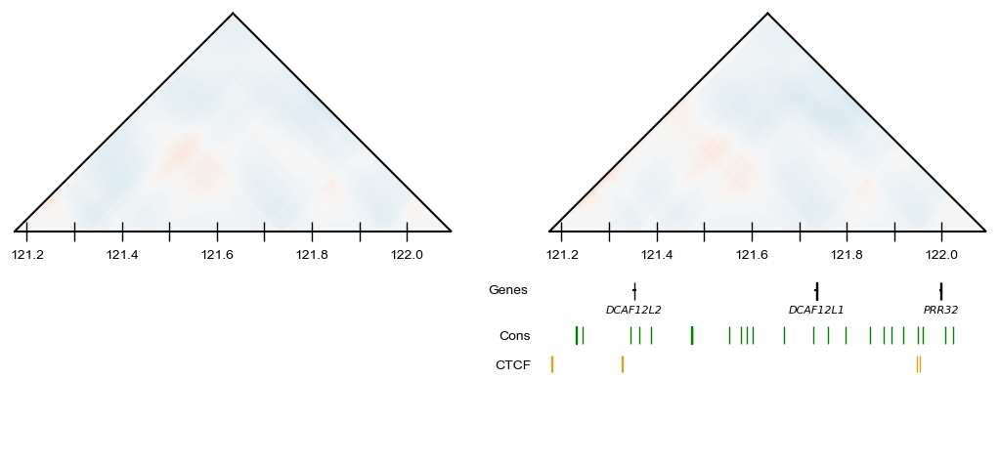

In [112]:
map_comparison_no_delta_with_annotations('Clint', 'Hortense', 'chrX_121110528', 'no')

In [137]:
def thing(chr, start):
    with open('/wynton/group/capra/projects/pan_3d_genome/data/predictions/reference/3d_predictions_HFF_%s.txt' % (chr)) as ref_file:
        lines = [ line.strip() for line in ref_file ]
        for line in lines:
            ref_line = line.split('\t')
            #print(ref_line[0])
            #print(ref_line[1])
            if ref_line[0] == chr and ref_line[1] == start:
                print(ref_line[0])
                print(ref_line[1])
                #ref_vector = list(map(float,ref_line[2:]))
                ref_vector = ref_line[2:]
    ref_mat = from_upper_triu(ref_vector, 448, 2)
    mask =  np.tri(ref_mat.shape[0], k = -1)
    ref_mat = np.ma.array(ref_mat, mask = mask).T
    return ref_mat

chr7
83886080


masked_array(
  data=[[nan, --, --, ..., --, --, --],
        [nan, nan, --, ..., --, --, --],
        [-0.04860875, nan, nan, ..., --, --, --],
        ...,
        [-0.16115233, -0.16758665, -0.18129972, ..., nan, --, --],
        [-0.15805116, -0.16692555, -0.1769591, ..., nan, nan, --],
        [-0.15092468, -0.16130197, -0.16938508, ..., 0.04133424, nan,
         nan]],
  mask=[[False,  True,  True, ...,  True,  True,  True],
        [False, False,  True, ...,  True,  True,  True],
        [False, False, False, ...,  True,  True,  True],
        ...,
        [False, False, False, ..., False,  True,  True],
        [False, False, False, ..., False, False,  True],
        [False, False, False, ..., False, False, False]],
  fill_value=1e+20)

## In Silico Mutagenesis Map Comparison

In [18]:
def alternate_map(window, variant):
    chr = window.split('_')[0]
    start = int(window.split('_')[1])
    
    with open('/wynton/group/capra/projects/pan_3d_genome/data/in_silico_mutagenesis/ppn_ptr_divergent_window_3d_modifying_variant_predictions/%s_%s_%s.txt' % (chr, variant, window)) as alt_file:
        lines = [ line.strip() for line in alt_file ]
        for line in lines:
            line = line.split('\t')
            alt_vector = line[2:]
            #print(alt_vector)
    alt_mat = from_upper_triu(alt_vector, 448, 2)
    mask = np.tri(alt_mat.shape[0], k = -1)
    alt_mat = np.ma.array(alt_mat, mask = mask).T
    return alt_mat

In [37]:
def in_silico_mutagenesis_map_comparison_1(ind1, ind2, window, variant, save):
    chr = window.split('_')[0]
    start = int(window.split('_')[1])

    ind1_mat = load_individual_map(chr, start, ind1)
    alt_mat = alternate_map(window, variant)
    ind2_mat = load_individual_map(chr, start, ind2)
    
    fig1, axes = plt.subplots(3, 1, figsize=(4.8,9))

    fig1.delaxes(axes[0])
    fig1.delaxes(axes[1])
    fig1.delaxes(axes[2])
    
    ax0 = setup_axes1(fig1, 311, -45)
    ax1 = setup_axes1(fig1, 312, -45)
    ax2 = setup_axes1(fig1, 313, -45)

    ax0.set_position([0, 0.66, 1, 1])
    ax1.set_position([0, 0.33, 1, 1])
    ax2.set_position([0, 0, 1, 1])
    
    ax0.matshow(ind1_mat, cmap = 'RdBu_r', vmin = -1, vmax = 1)
    ax1.matshow(alt_mat, cmap = 'RdBu_r', vmin = -1, vmax = 1)
    ax2.matshow(ind2_mat, cmap = 'RdBu_r', vmin = -1, vmax = 1)
    
    subplots = [ax0,ax1,ax2]
    
    # add border to map
    for n in subplots:
        n.plot([-1, 447], [0, 448], color = 'black', linewidth = 1) # bottom line
        n.plot([-1, 447], [448, 448], color = 'black', linewidth = 1) # right line
        n.plot([-1, -1], [448, 0], color = 'black', linewidth = 1) # left line
    
    # add 'x-axis' ticks
    first = start + 65536
    rounded = math.ceil(first / 100000) * 100000
    diff = rounded - first
    cell = diff/2048
    
    x_list = np.arange(cell, 440, (100000/2048))
        
    for n in subplots:
        for x in x_list:
            n.plot(x, x, color = 'black', marker = '|', markersize = 15 * 0.75)
    
    # add 'x-axis' labels
    y_list = np.arange((rounded/1000000), ((rounded/1000000)+0.9), 0.1)
    for n in subplots:
        for x, y in zip(x_list[::2], (y_list[::2])):
            n.text(x+21, x-21, '%.1f' % y, horizontalalignment = 'center', verticalalignment = 'top', fontproperties = arial, fontsize = 9)

    # variant position
    variant_diff = variant - first
    variant_cell = variant_diff/2048
    
    for n in subplots:
        n.scatter(variant_cell+9, variant_cell-9, marker = '*', s = 150, c = '#d80000', edgecolors = 'none', zorder = 10)
        n.scatter(variant_cell+9, variant_cell-9, marker = '*', s = 150, c = 'none', edgecolors = 'black', linewidths = 1, zorder = 8)
            
    # get annotations
    exon_starts, exon_lengths, gene_starts, gene_lengths, gene_midpoints, exon_genes, phastCons_starts, phastCons_lengths, CTCF_starts, CTCF_lengths = annotations(chr, start)

    # plot tracks
    for x, y in zip(exon_starts, exon_lengths):
        ax2.add_patch(Rectangle((x+70, x-70), width = y, height = 25 * 0.75, angle = 45, color = 'black', lw = 1))
    for x, y in zip(gene_starts, gene_lengths):
        ax2.plot([(x+63.5), ((x+y)+63.5)],[(x-63.5), ((x+y)-63.5)], color = 'black') # line will default to bottom of exon rectangle so adjust coordinates if exon height changes
    for x, y in zip(gene_midpoints, exon_genes):
        ax2.text(x+75, x-75, y, horizontalalignment = 'center', verticalalignment = 'top', style = 'italic', fontsize = 7)
    for x, y in zip(CTCF_starts, CTCF_lengths):
        ax2.add_patch(Rectangle((x+115, x-115), width = y, height = 25 * 0.75, angle = 45, color = 'grey', lw = 1))
    for x, y in zip(phastCons_starts, phastCons_lengths):
        ax2.add_patch(Rectangle((x+145, x-145), width = y, height = 25 * 0.75, angle = 45, color = 'goldenrod', lw = 1))

    # track labels
    for n in subplots:
        n.text(0, -42, chr, horizontalalignment = 'right', verticalalignment = 'top', fontproperties = arial, fontsize = 10)
    ax2.text(37.5, -82.5, 'Genes', horizontalalignment = 'right', verticalalignment = 'center', fontproperties = arial, fontsize = 10)
    ax2.text(87.5, -127.5, 'CTCF', horizontalalignment = 'right', verticalalignment = 'center', fontproperties = arial, fontsize = 10)
    ax2.text(117.5, -157.5, 'Cons', horizontalalignment = 'right', verticalalignment = 'center', fontproperties = arial, fontsize = 10)

    # save and show plot
    if save == 'yes':
        plt.savefig('/wynton/group/capra/projects/pan_3d_genome/figures/map_comparisons/in_silico_mutagenesis_comparison_%s_%s_%s_%s.pdf' % (window, variant, ind1, ind2), bbox_inches = 'tight', transparent = True)
        print('Comparisons saved.')
    plt.show()

Comparisons saved.


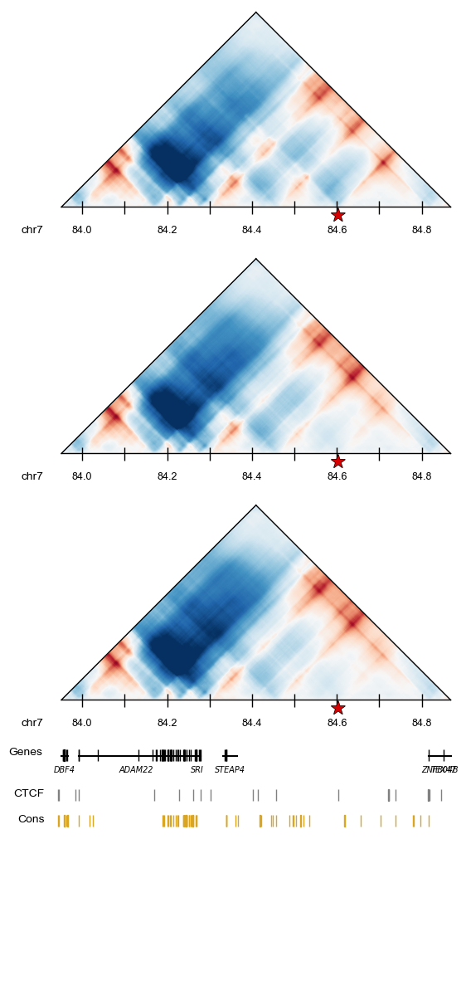

In [38]:
in_silico_mutagenesis_map_comparison_1('Vaillant', 'Hortense', 'chr7_83886080', 84603122, 'yes')

Comparisons saved.


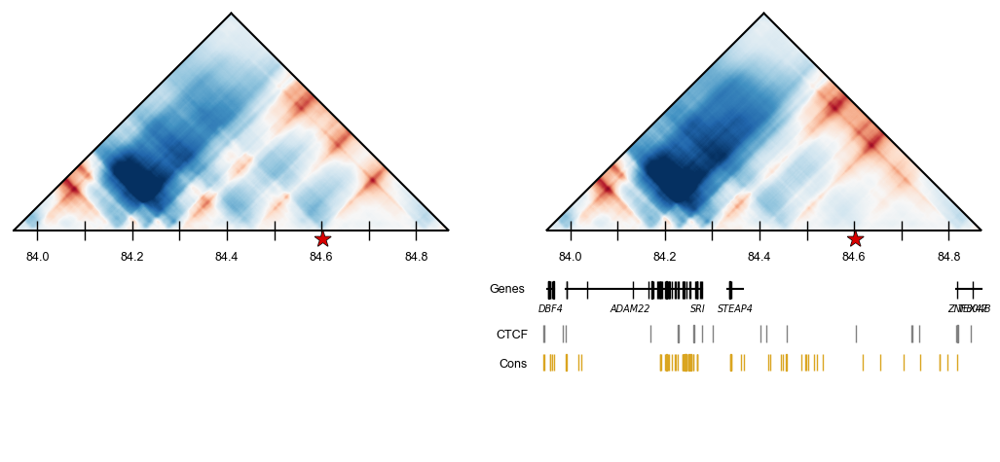

In [112]:
in_silico_mutagenesis_map_comparison_1('Vaillant', 'Hortense', 'chr7_83886080', 84603122, 'yes')

Comparisons saved.


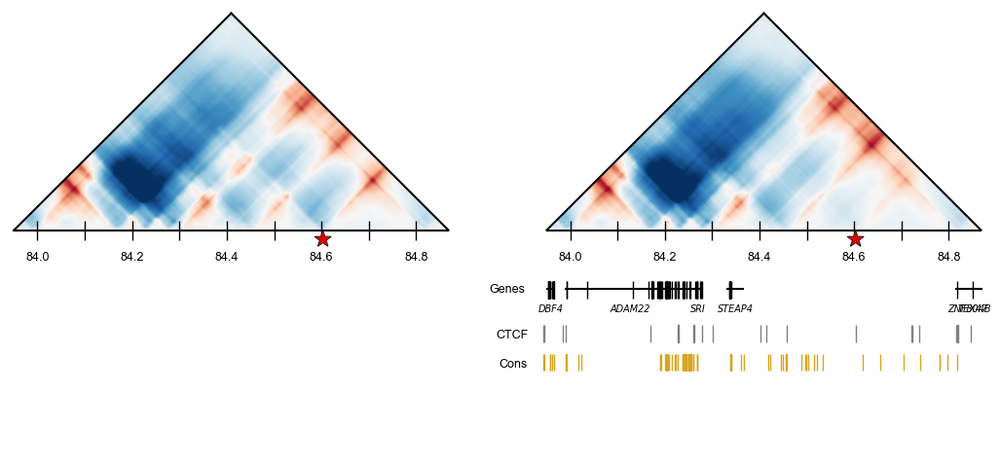

In [113]:
in_silico_mutagenesis_map_comparison_2('Vaillant', 'chr7_83886080', 84603122, 'yes')

In [130]:
def reference_map(window):
    chr = window.split('_')[0]
    start = window.split('_')[1]
    
    with open('/wynton/group/capra/projects/pan_3d_genome/data/predictions/reference/3d_predictions_HFF_%s.txt' % (chr)) as ref_file:
        lines = [ line.strip() for line in ref_file ]
        for line in lines:
            line = line.split('\t')
            if line[0] == chr and line[1] == start:
                ref_vector = line[2:]
    ref_mat = from_upper_triu(ref_vector, 448, 2)
    mask = np.tri(ref_mat.shape[0], k = -1)
    ref_mat = np.ma.array(ref_mat, mask = mask).T
    return ref_mat

In [209]:
def modifying_variant_ref_alt_map_comparison(window, variant):
    chr = window.split('_')[0]
    start = int(window.split('_')[1])

    ref_mat = reference_map(window)
    alt_mat = alternate_map(window, variant)
    
    fig1, axes = plt.subplots(3, figsize=(40,20))
    
    fig1.delaxes(axes[0])
    fig1.delaxes(axes[1])
    fig1.delaxes(axes[2])
    
    ax0 = setup_axes1(fig1, 131, -45)
    ax1 = setup_axes1(fig1, 132, -45)
    ax2 = setup_axes1(fig1, 133, -45)
    
    ax0.matshow(ref_mat, cmap = 'RdBu_r', vmin = -2, vmax = 2)
    ax1.matshow(alt_mat, cmap = 'RdBu_r', vmin = -2, vmax = 2)
    ax2.matshow(alt_mat - ref_mat, cmap = 'PRGn_r', vmin = -1, vmax = 1)
    
    subplots = [ax0,ax1,ax2]
    
    # add border to map
    for n in subplots:
        n.plot([-1, 447], [0, 448], color = 'black', linewidth = 3.5) # bottom line
        n.plot([-1, 447], [448, 448], color = 'black', linewidth = 3.5) # right line
        n.plot([-1, -1], [448, 0], color = 'black', linewidth = 3.5) # left line
    
    # add 'x-axis' ticks
    first = start + 65536
    rounded = math.ceil(first / 100000) * 100000
    diff = rounded - first
    cell = diff/2048
    
    x_list = np.arange(cell, 440, (100000/2048))
        
    for n in subplots:
        for x in x_list:
            n.plot(x, x, color = 'black', marker = '|', markersize = 15)
    
    # add 'x-axis' labels
    y_list = np.arange((rounded/1000000), ((rounded/1000000)+0.9), 0.1)
    for n in subplots:
        for x, y in zip(x_list[::2], (y_list[::2])):
            n.text(x+15, x-15, '%.1f' % y, horizontalalignment = 'center', verticalalignment = 'top', fontproperties = arial, fontsize = 32)

    # variant position
    variant_diff = variant - first
    variant_cell = variant_diff/2048
    
    for n in subplots:
        n.scatter(variant_cell+9, variant_cell-9, marker = '*', s = 150, c = '#d80000', edgecolors = 'none', zorder = 10)
        n.scatter(variant_cell+9, variant_cell-9, marker = '*', s = 150, c = 'none', edgecolors = 'black', linewidths = 1, zorder = 8)
    
    # subpanel labels
    ax0.text(290, 158, 'Reference', horizontalalignment = 'center', verticalalignment = 'center', fontproperties = arial, fontsize = 40)
    ax1.text(290, 158, 'Alternate', horizontalalignment = 'center', verticalalignment = 'center', fontproperties = arial, fontsize = 40)
    ax2.text(290, 158, r'$\Delta$', horizontalalignment = 'center', verticalalignment = 'center', fontproperties = arial, fontsize = 40)
    
    plt.show()

In [145]:
modifying_variants = pd.read_csv('/wynton/group/capra/projects/pan_3d_genome/data/ppn_ptr_windows/ppn_ptr_divergent_window_3d_modifying_variants.txt', sep = '\t', names = ['chr','pos','ref','alt','window','mse','divergence','window_minimum'])
modifying_variants.head(5)

,chr,pos,ref,alt,window,mse,divergence,window_minimum
0,chr1,126940560,C,G,chr1_126353408,0.011125,0.036647,0.029323
1,chr1,153901388,A,T,chr1_153616384,0.005189,0.017142,0.016506
2,chr10,88057593,G,C,chr10_87556096,0.018322,0.031364,0.026767
3,chr10,88057595,G,T,chr10_87556096,0.019119,0.032893,0.026767
4,chr11,77997697,G,A,chr11_77070336,0.002093,0.025199,0.023994


In [146]:
for _, row in modifying_variants.iterrows():
    window = row['window']
    variant = row['pos']
    print(f'modifying_variant_ref_alt_map_comparison(\'{window}\', {variant})')

modifying_variant_ref_alt_map_comparison('chr1_126353408', 126940560)
modifying_variant_ref_alt_map_comparison('chr1_153616384', 153901388)
modifying_variant_ref_alt_map_comparison('chr10_87556096', 88057593)
modifying_variant_ref_alt_map_comparison('chr10_87556096', 88057595)
modifying_variant_ref_alt_map_comparison('chr11_77070336', 77997697)
modifying_variant_ref_alt_map_comparison('chr11_77594624', 77997697)
modifying_variant_ref_alt_map_comparison('chr12_37748736', 38458311)
modifying_variant_ref_alt_map_comparison('chr12_44040192', 44497512)
modifying_variant_ref_alt_map_comparison('chr13_44564480', 44760355)
modifying_variant_ref_alt_map_comparison('chr13_47185920', 47833112)
modifying_variant_ref_alt_map_comparison('chr13_70778880', 71490849)
modifying_variant_ref_alt_map_comparison('chr14_32505856', 32842231)
modifying_variant_ref_alt_map_comparison('chr14_45088768', 45793476)
modifying_variant_ref_alt_map_comparison('chr14_45613056', 45793476)
modifying_variant_ref_alt_map_co

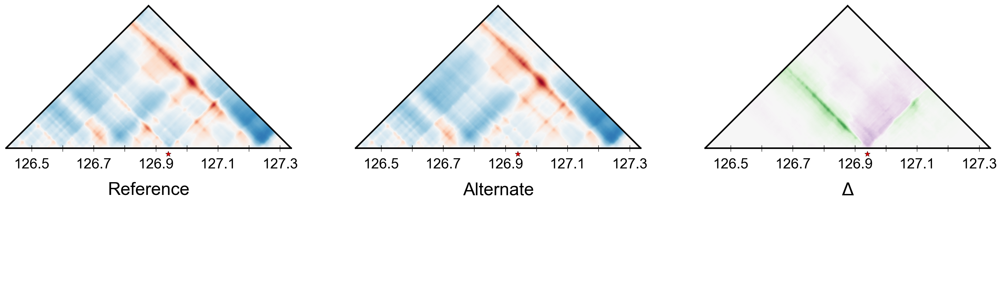

In [214]:
modifying_variant_ref_alt_map_comparison('chr1_126353408', 126940560)

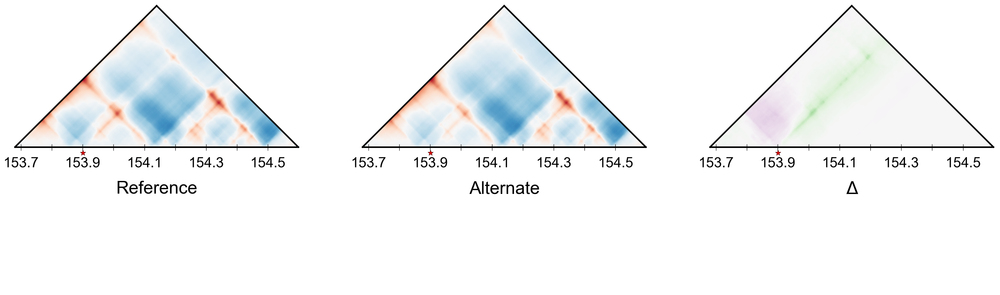

In [215]:
modifying_variant_ref_alt_map_comparison('chr1_153616384', 153901388)

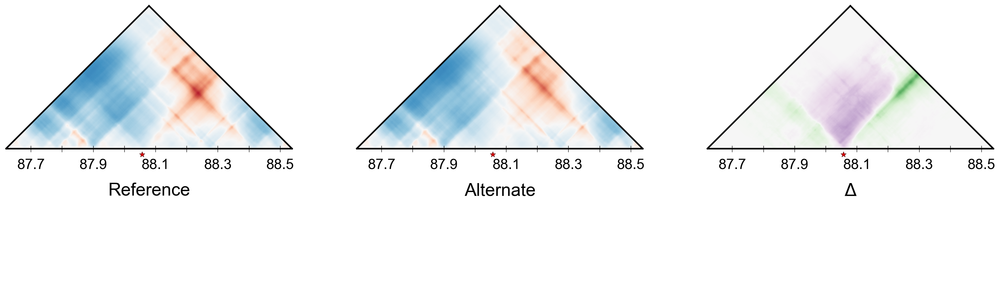

In [216]:
modifying_variant_ref_alt_map_comparison('chr10_87556096', 88057593)

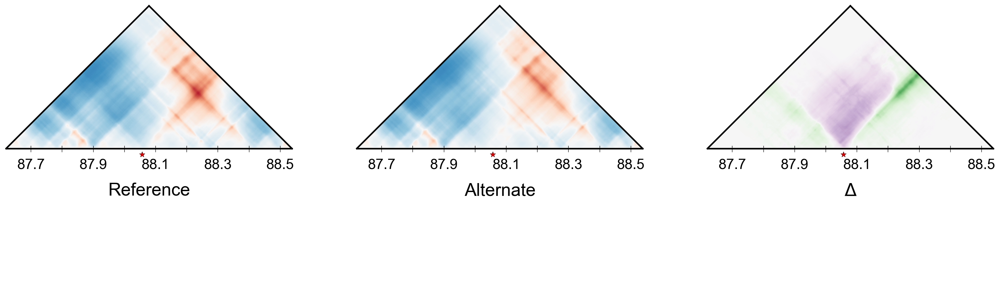

In [217]:
modifying_variant_ref_alt_map_comparison('chr10_87556096', 88057595)

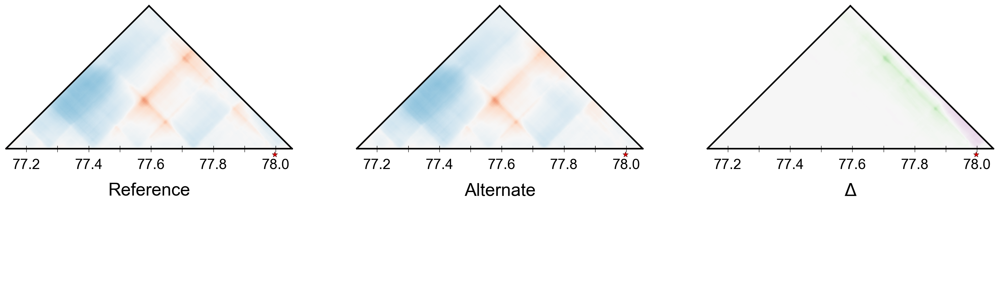

In [218]:
modifying_variant_ref_alt_map_comparison('chr11_77070336', 77997697)

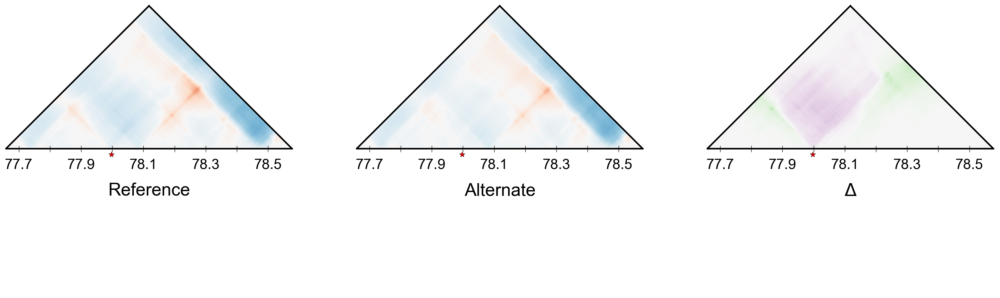

In [219]:
modifying_variant_ref_alt_map_comparison('chr11_77594624', 77997697)

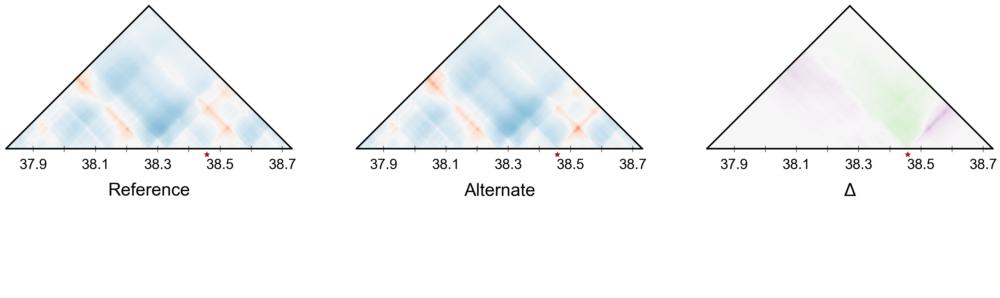

In [220]:
modifying_variant_ref_alt_map_comparison('chr12_37748736', 38458311)

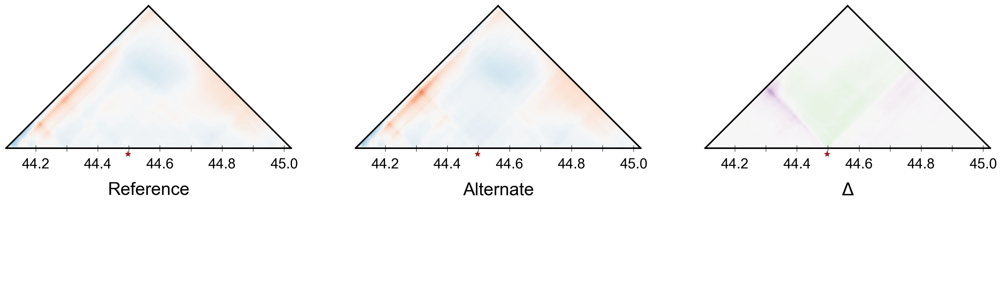

In [221]:
modifying_variant_ref_alt_map_comparison('chr12_44040192', 44497512)

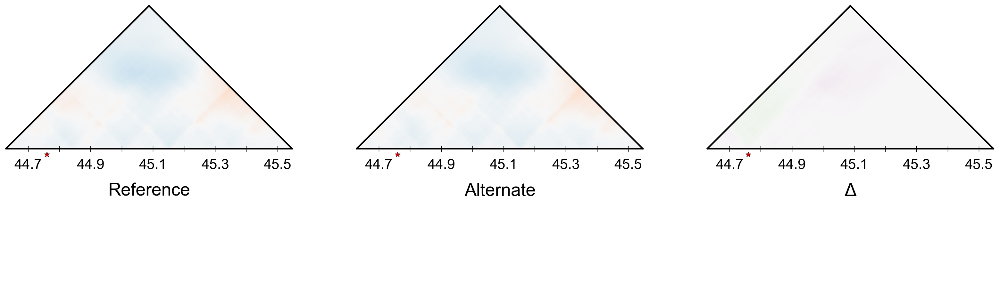

In [222]:
modifying_variant_ref_alt_map_comparison('chr13_44564480', 44760355)

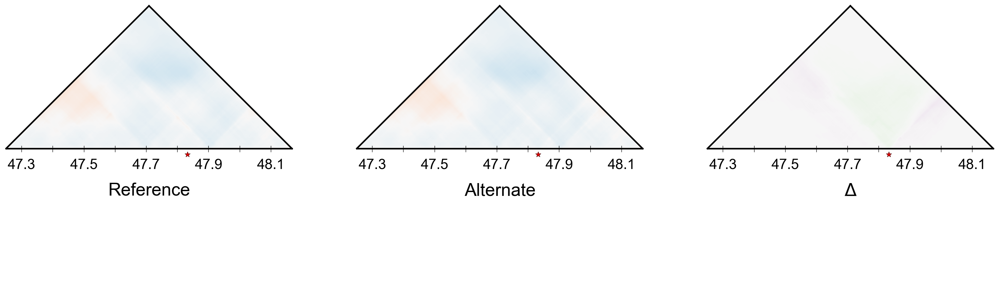

In [223]:
modifying_variant_ref_alt_map_comparison('chr13_47185920', 47833112)

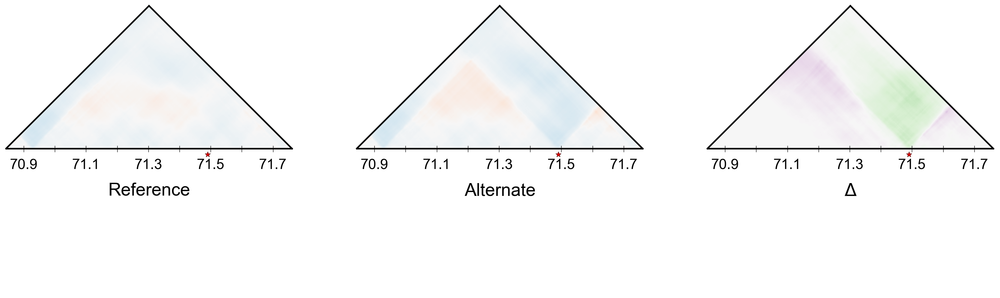

In [224]:
modifying_variant_ref_alt_map_comparison('chr13_70778880', 71490849)

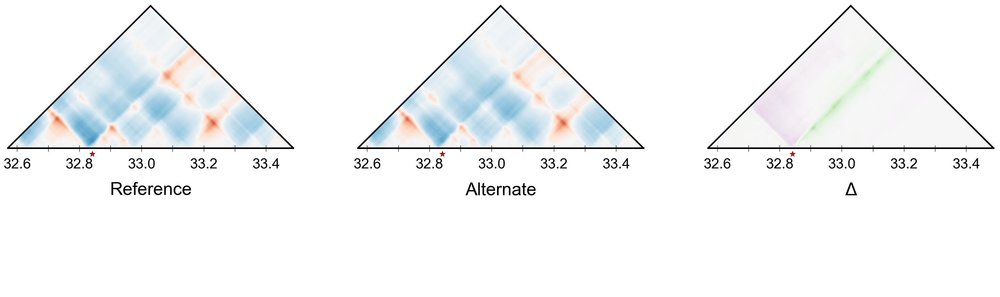

In [225]:
modifying_variant_ref_alt_map_comparison('chr14_32505856', 32842231)

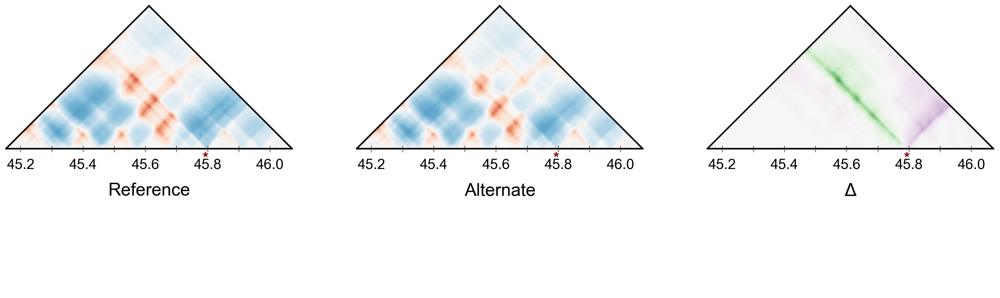

In [226]:
modifying_variant_ref_alt_map_comparison('chr14_45088768', 45793476)

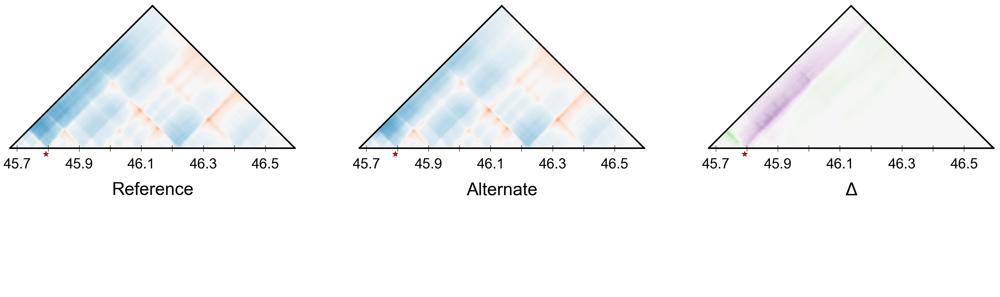

In [227]:
modifying_variant_ref_alt_map_comparison('chr14_45613056', 45793476)

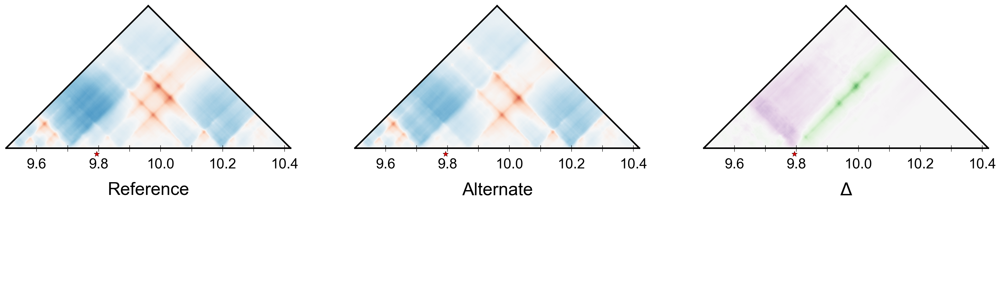

In [228]:
modifying_variant_ref_alt_map_comparison('chr15_9437184', 9794509)

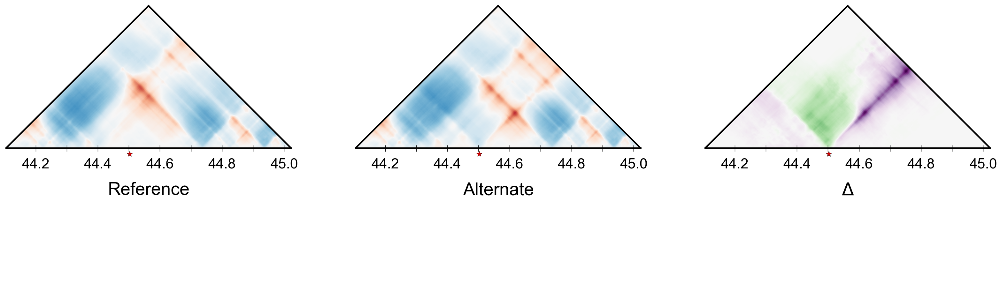

In [229]:
modifying_variant_ref_alt_map_comparison('chr15_44040192', 44503082)

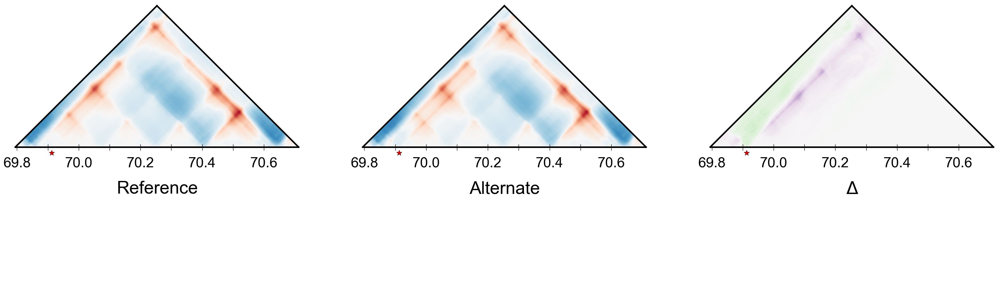

In [230]:
modifying_variant_ref_alt_map_comparison('chr15_69730304', 69913089)

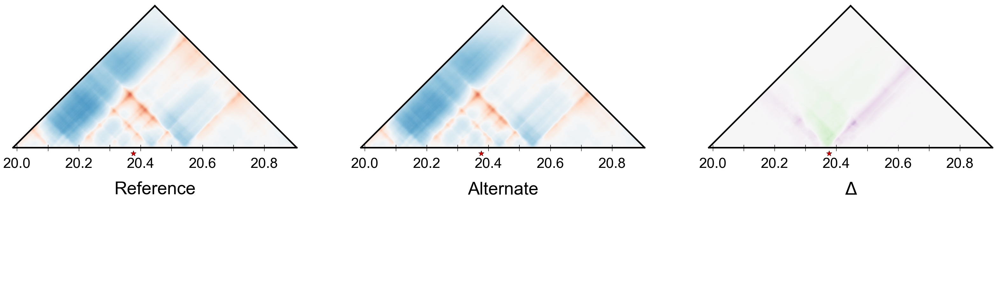

In [231]:
modifying_variant_ref_alt_map_comparison('chr18_19922944', 20377029)

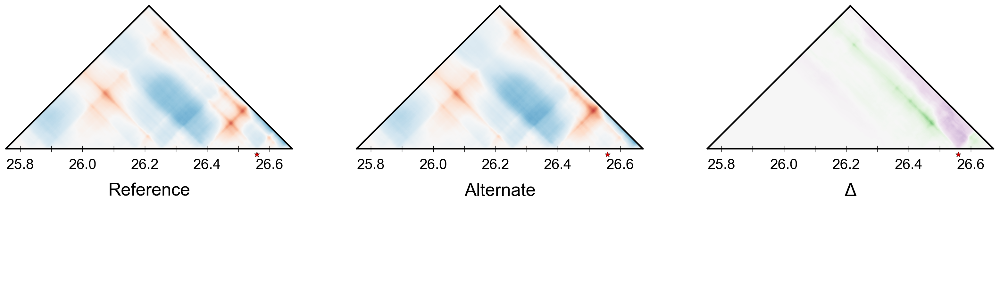

In [232]:
modifying_variant_ref_alt_map_comparison('chr19_25690112', 26559939)

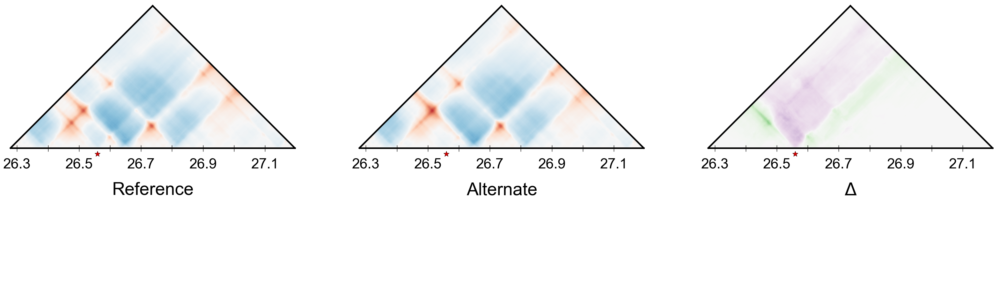

In [233]:
modifying_variant_ref_alt_map_comparison('chr19_26214400', 26559939)

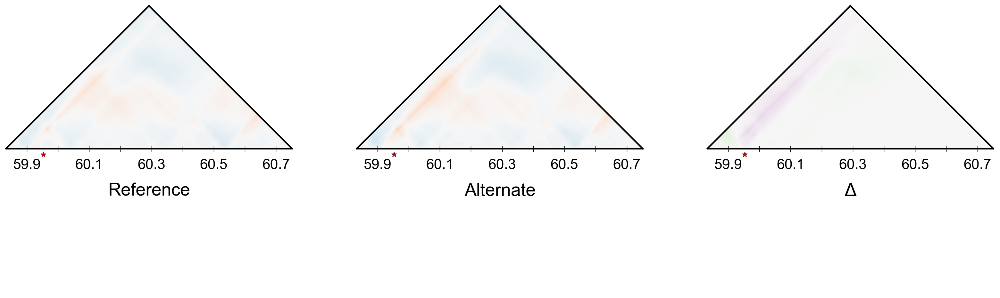

In [234]:
modifying_variant_ref_alt_map_comparison('chr20_59768832', 59953470)

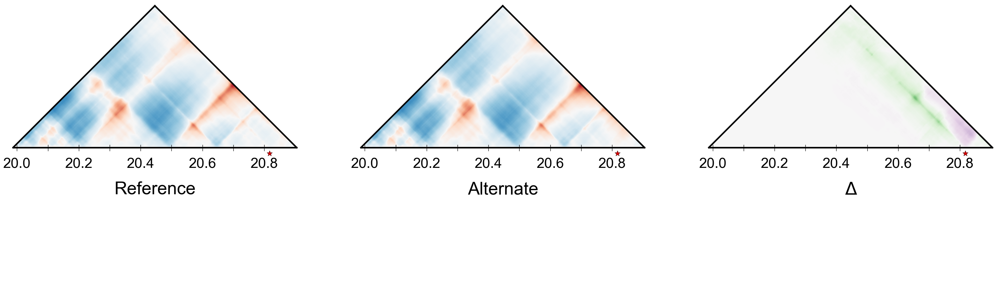

In [235]:
modifying_variant_ref_alt_map_comparison('chr21_19922944', 20817762)

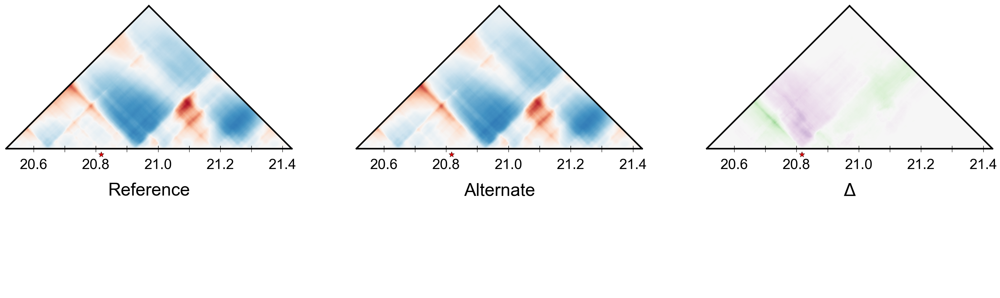

In [236]:
modifying_variant_ref_alt_map_comparison('chr21_20447232', 20817762)

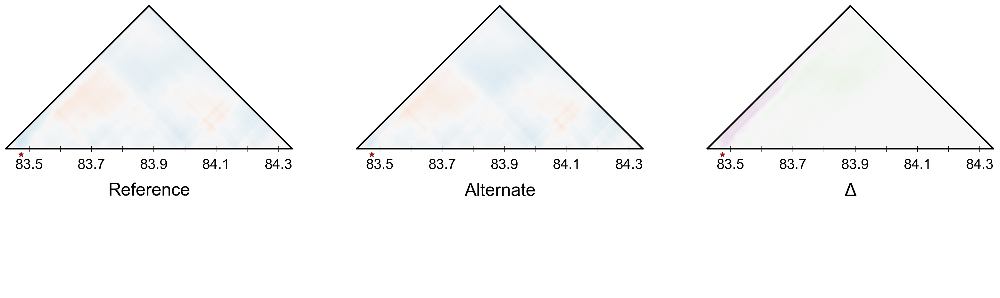

In [237]:
modifying_variant_ref_alt_map_comparison('chr2A_83361792', 83474765)

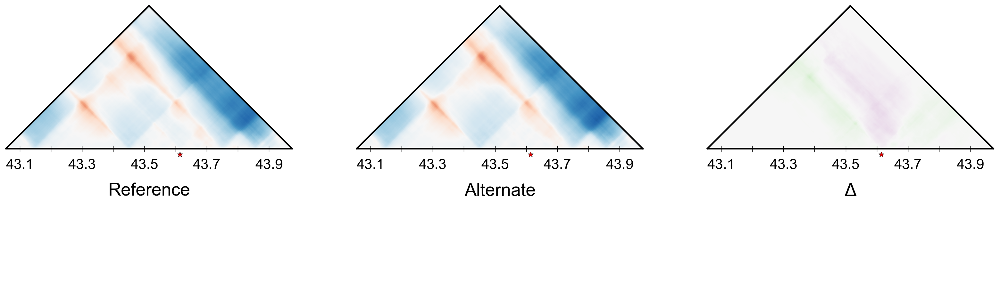

In [238]:
modifying_variant_ref_alt_map_comparison('chr2B_42991616', 43614481)

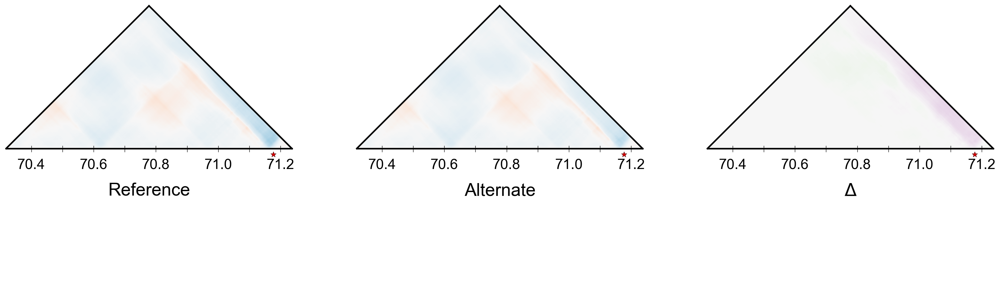

In [239]:
modifying_variant_ref_alt_map_comparison('chr2B_70254592', 71177435)

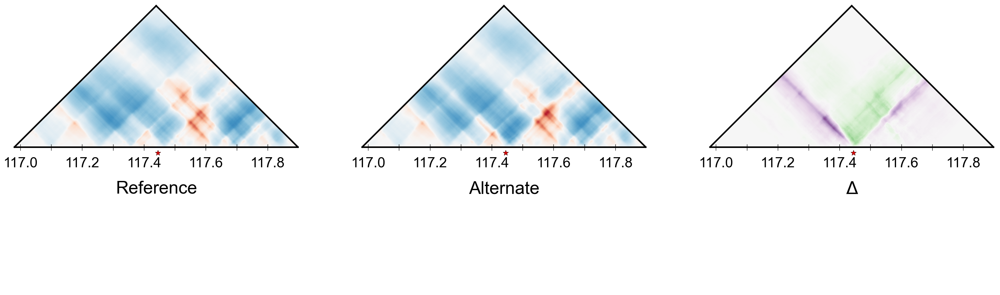

In [240]:
modifying_variant_ref_alt_map_comparison('chr2B_116916224', 117445518)

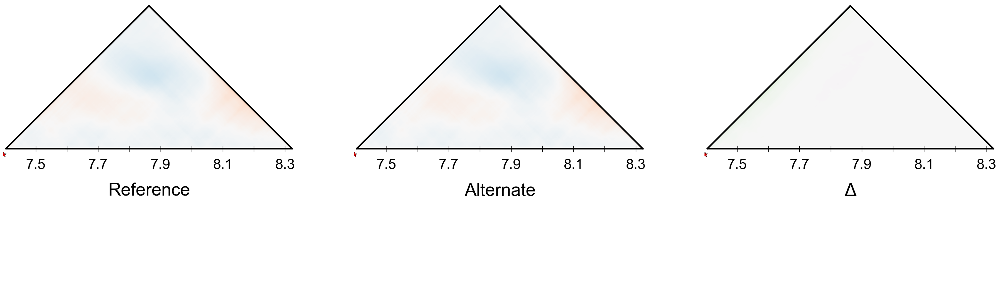

In [241]:
modifying_variant_ref_alt_map_comparison('chr3_7340032', 7396908)

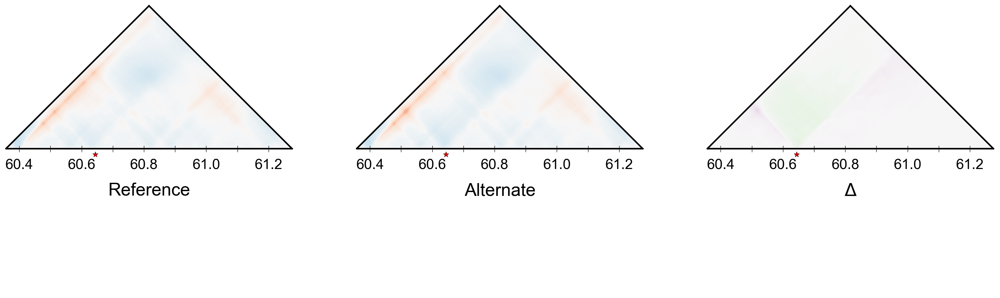

In [242]:
modifying_variant_ref_alt_map_comparison('chr3_60293120', 60644412)

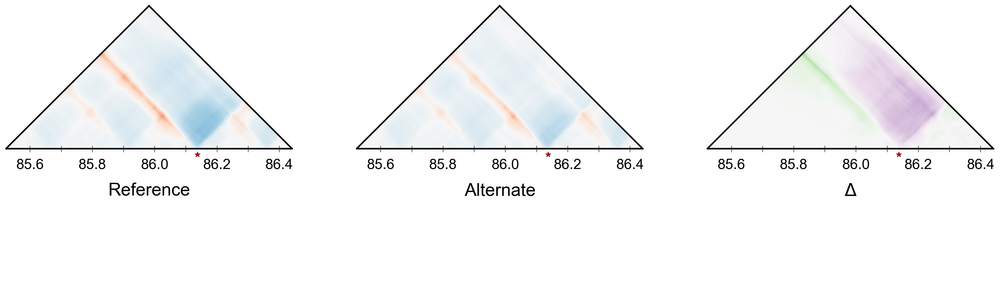

In [243]:
modifying_variant_ref_alt_map_comparison('chr3_85458944', 86138123)

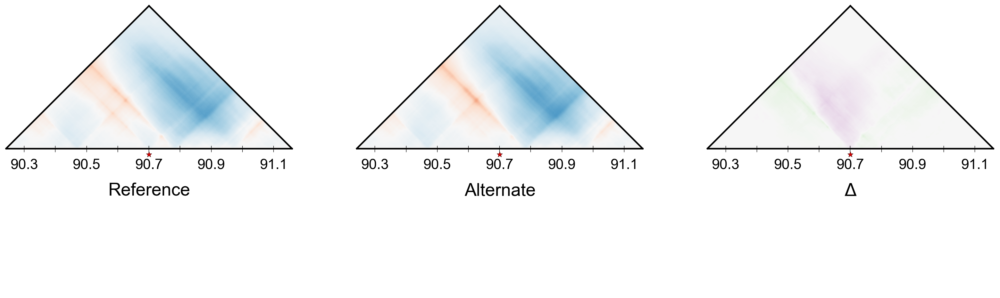

In [244]:
modifying_variant_ref_alt_map_comparison('chr3_90177536', 90701083)

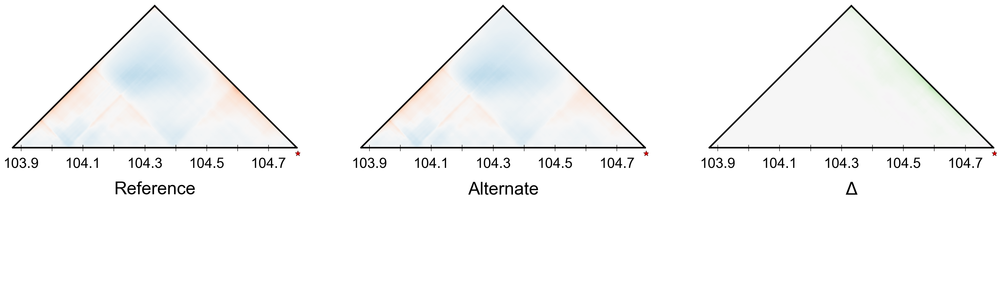

In [245]:
modifying_variant_ref_alt_map_comparison('chr3_103809024', 104795082)

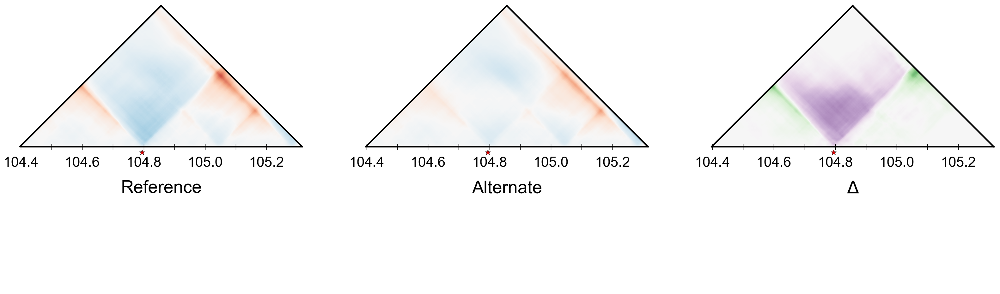

In [246]:
modifying_variant_ref_alt_map_comparison('chr3_104333312', 104795082)

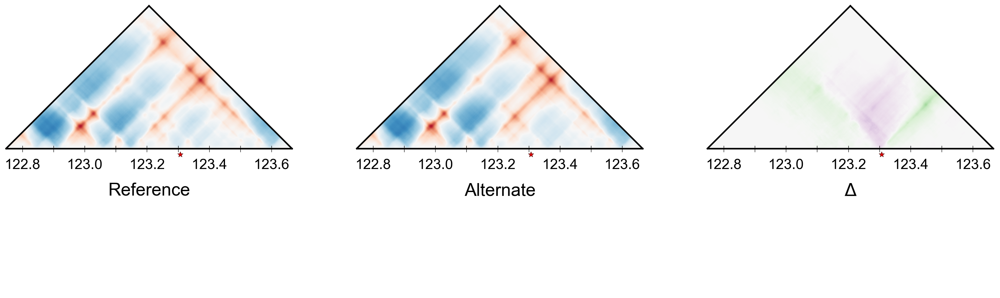

In [247]:
modifying_variant_ref_alt_map_comparison('chr3_122683392', 123307387)

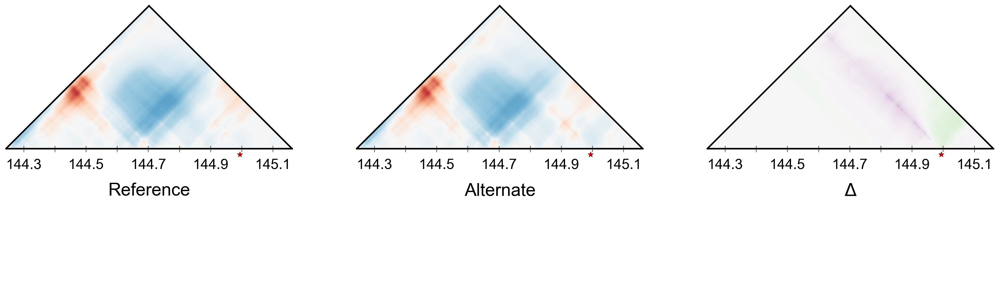

In [248]:
modifying_variant_ref_alt_map_comparison('chr3_144179200', 144994507)

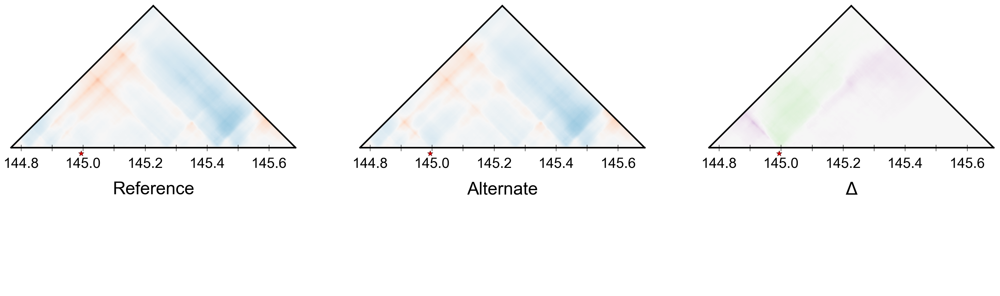

In [249]:
modifying_variant_ref_alt_map_comparison('chr3_144703488', 144994507)

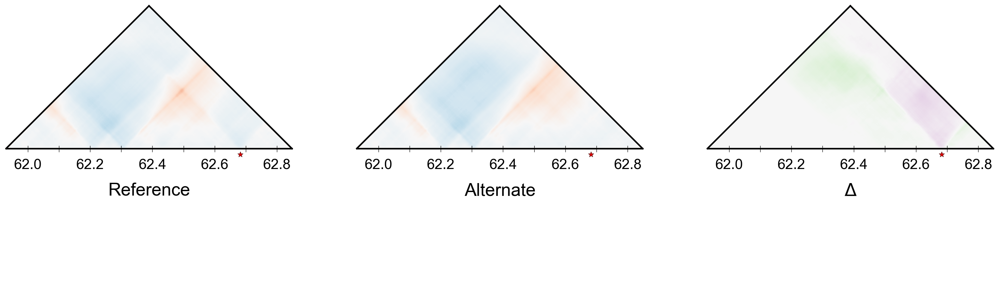

In [250]:
modifying_variant_ref_alt_map_comparison('chr4_61865984', 62682758)

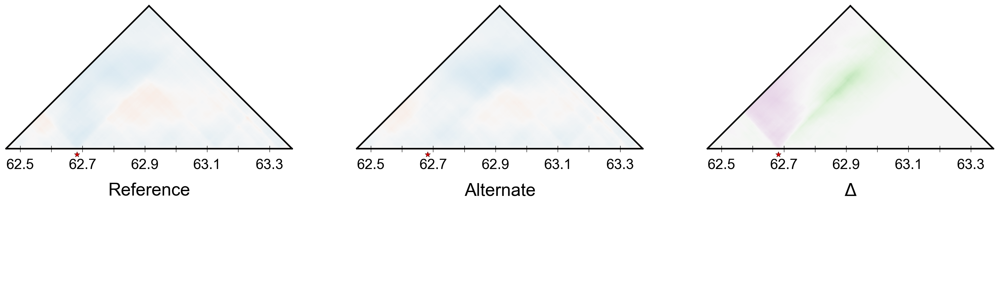

In [251]:
modifying_variant_ref_alt_map_comparison('chr4_62390272', 62682758)

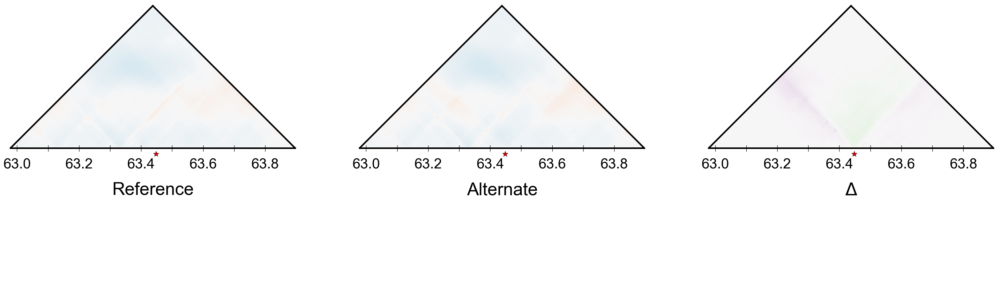

In [252]:
modifying_variant_ref_alt_map_comparison('chr4_62914560', 63448623)

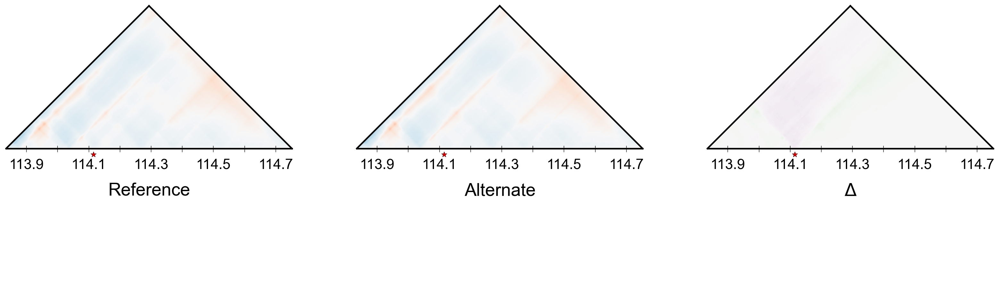

In [253]:
modifying_variant_ref_alt_map_comparison('chr4_113770496', 114115871)

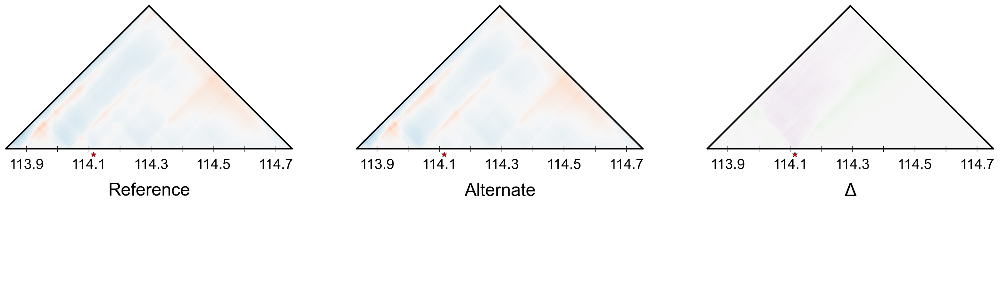

In [254]:
modifying_variant_ref_alt_map_comparison('chr4_113770496', 114115875)

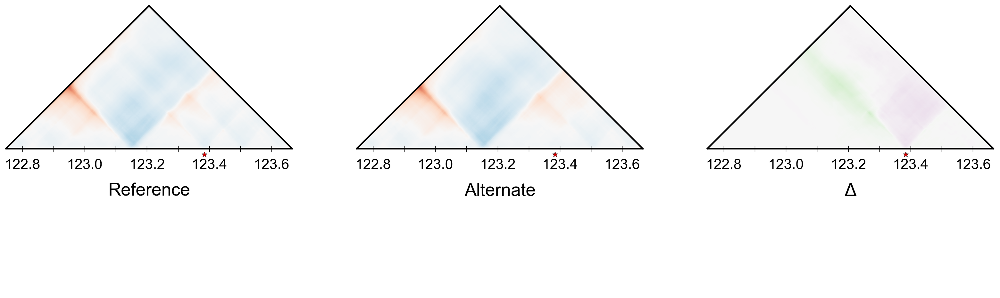

In [255]:
modifying_variant_ref_alt_map_comparison('chr4_122683392', 123384706)

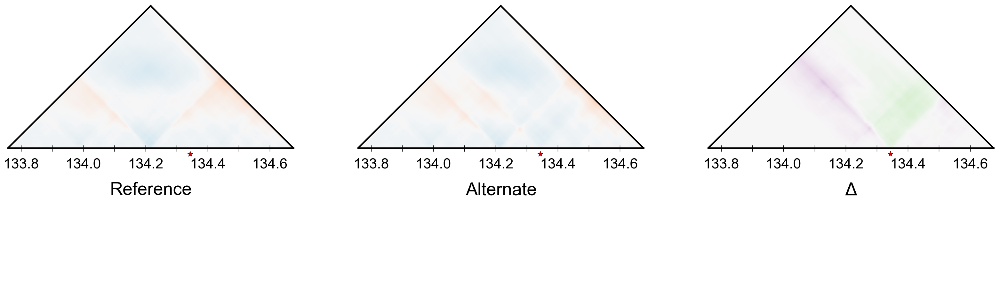

In [256]:
modifying_variant_ref_alt_map_comparison('chr4_133693440', 134343992)

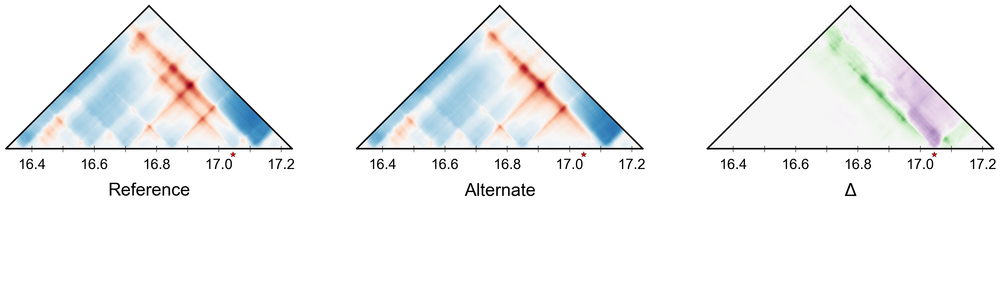

In [257]:
modifying_variant_ref_alt_map_comparison('chr5_16252928', 17045915)

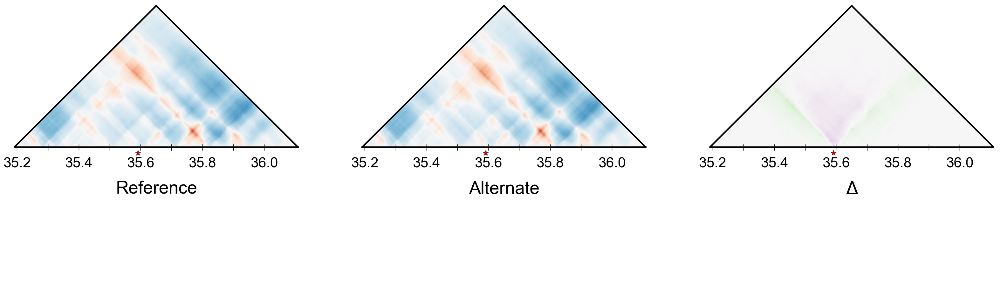

In [258]:
modifying_variant_ref_alt_map_comparison('chr5_35127296', 35592012)

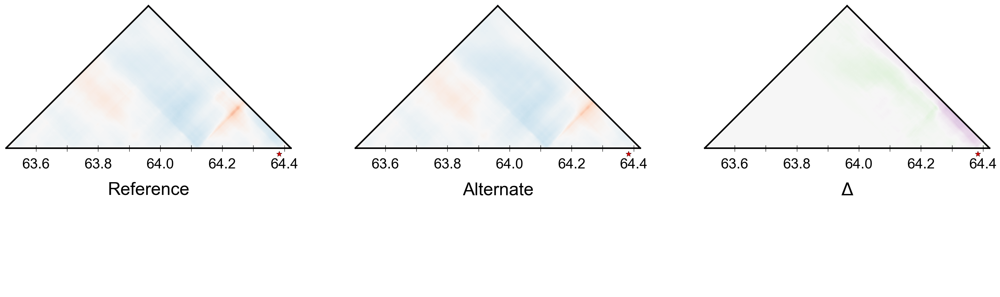

In [259]:
modifying_variant_ref_alt_map_comparison('chr6_63438848', 64383766)

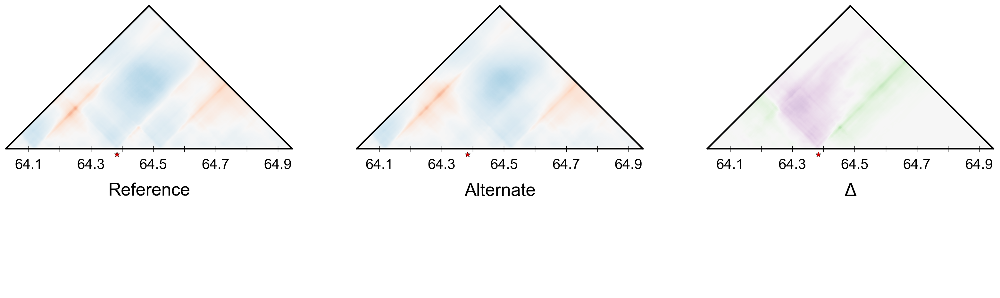

In [260]:
modifying_variant_ref_alt_map_comparison('chr6_63963136', 64383766)

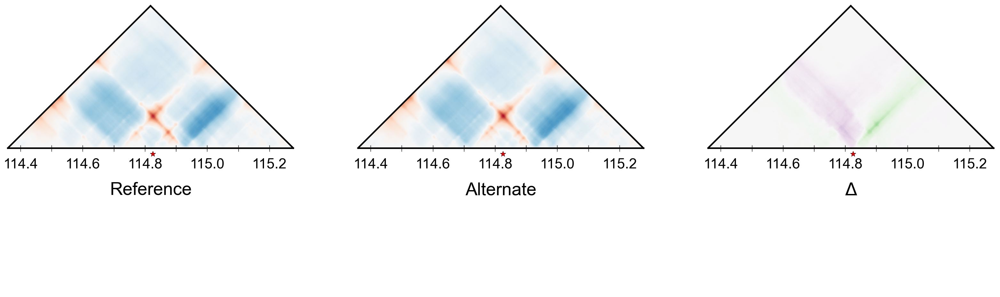

In [261]:
modifying_variant_ref_alt_map_comparison('chr6_114294784', 114825777)

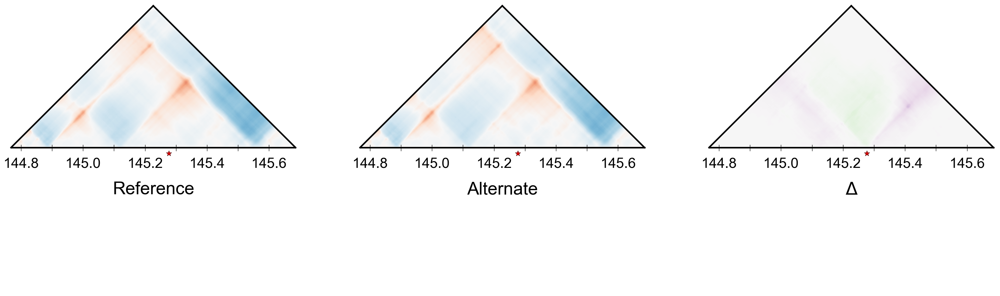

In [262]:
modifying_variant_ref_alt_map_comparison('chr6_144703488', 145277458)

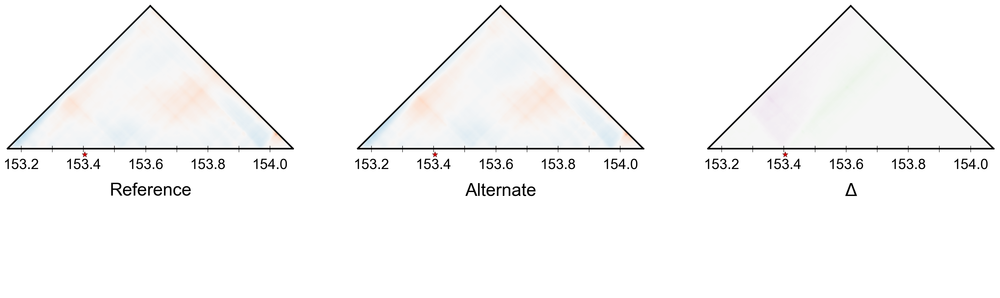

In [263]:
modifying_variant_ref_alt_map_comparison('chr6_153092096', 153405037)

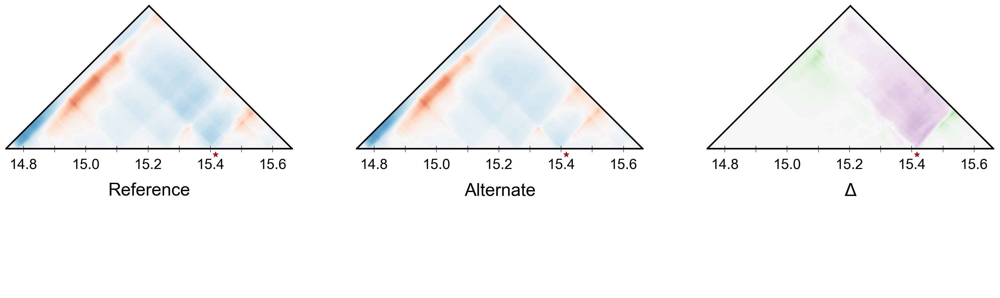

In [264]:
modifying_variant_ref_alt_map_comparison('chr7_14680064', 15417247)

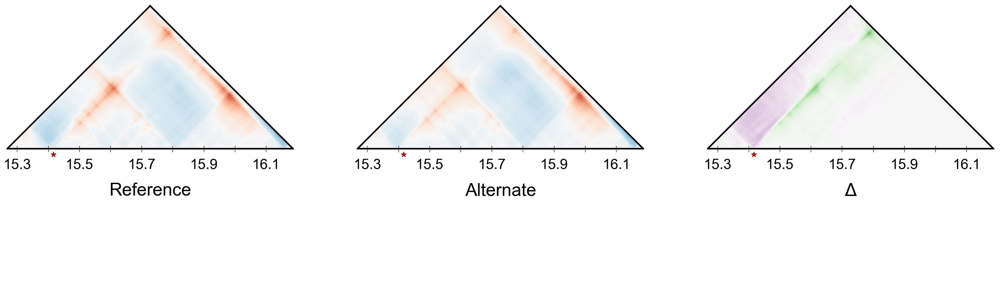

In [265]:
modifying_variant_ref_alt_map_comparison('chr7_15204352', 15417247)

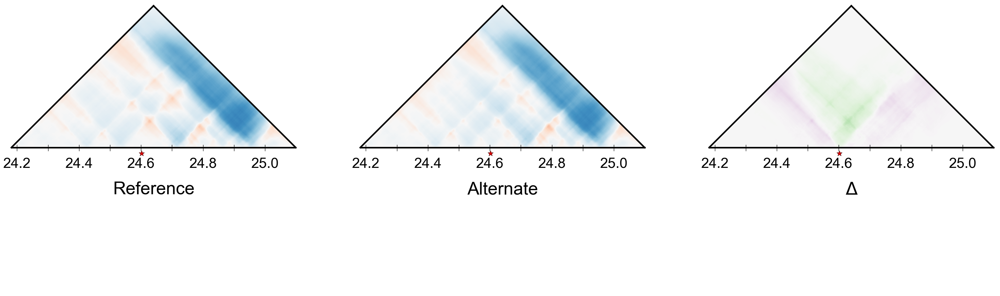

In [266]:
modifying_variant_ref_alt_map_comparison('chr7_24117248', 24602378)

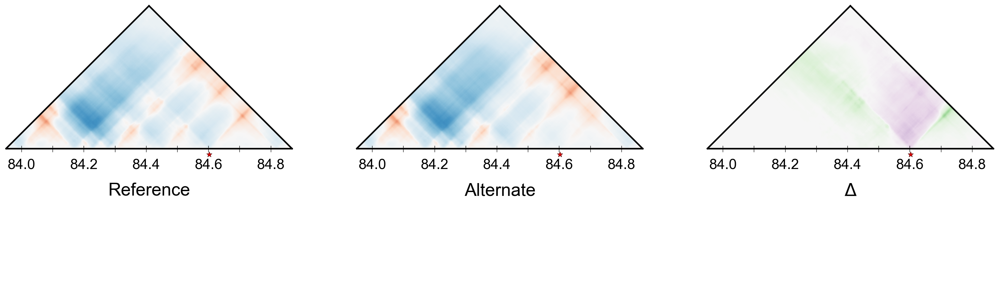

In [267]:
modifying_variant_ref_alt_map_comparison('chr7_83886080', 84603122)

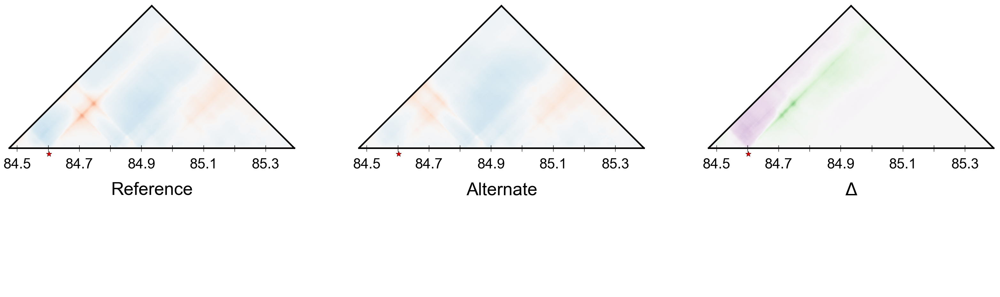

In [268]:
modifying_variant_ref_alt_map_comparison('chr7_84410368', 84603122)

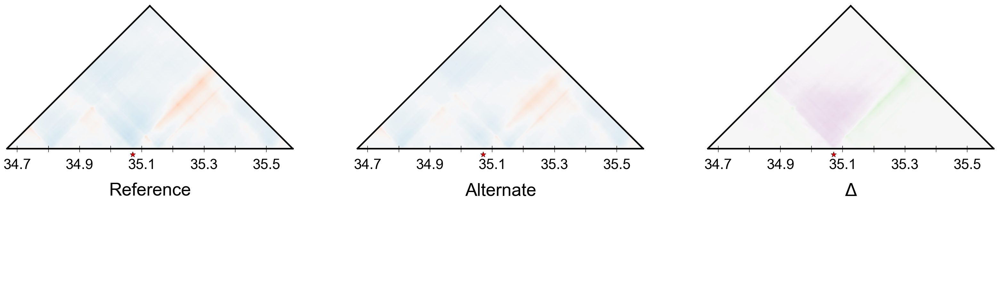

In [269]:
modifying_variant_ref_alt_map_comparison('chr8_34603008', 35071668)

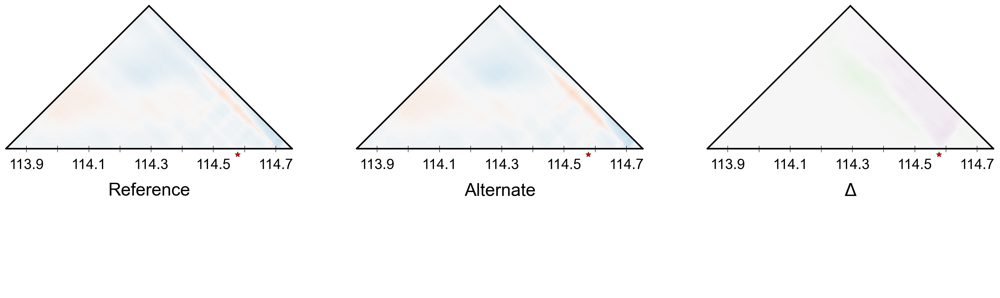

In [270]:
modifying_variant_ref_alt_map_comparison('chr8_113770496', 114578460)

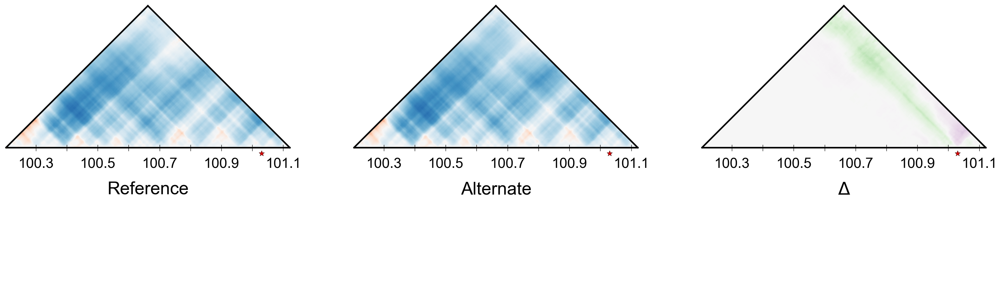

In [271]:
modifying_variant_ref_alt_map_comparison('chr9_100139008', 101030497)

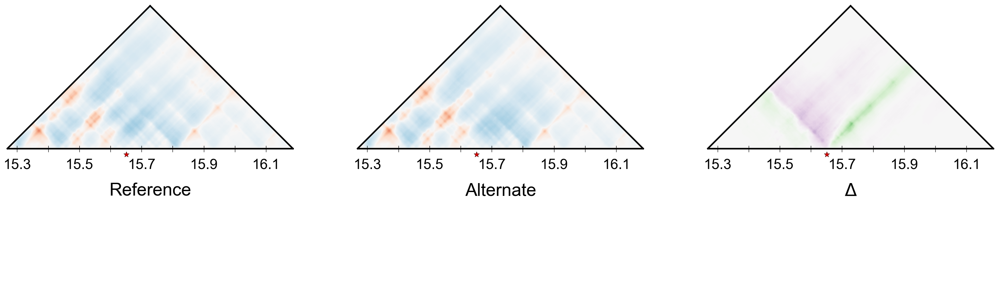

In [272]:
modifying_variant_ref_alt_map_comparison('chrX_15204352', 15651612)

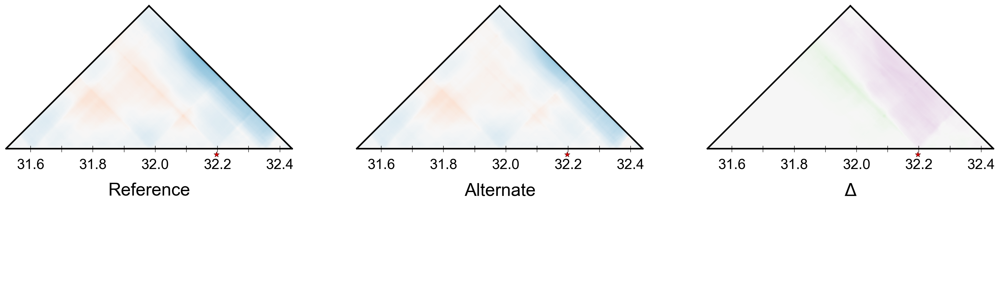

In [273]:
modifying_variant_ref_alt_map_comparison('chrX_31457280', 32197593)

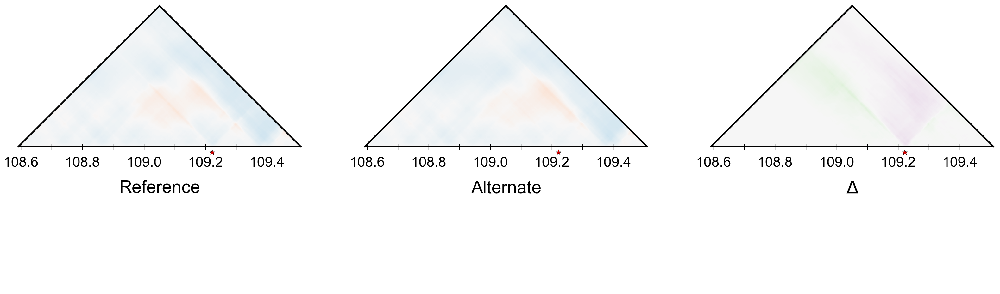

In [274]:
modifying_variant_ref_alt_map_comparison('chrX_108527616', 109222000)